# Generative Adversarial Network (GAN) for MNIST Generation

In this notebook, a Generative Adversarial Network (GAN) is implemented to generate synthetic images resembling the MNIST dataset. The GAN consists of a fully connected neural network architecture for both the generator and discriminator models. The training process involves alternating updates between the generator and discriminator, aiming to achieve a balance where the generator produces realistic images, and the discriminator becomes adept at distinguishing between real and generated data.

## Components and Configuration

1. **Generator and Discriminator Models:**
   - The generator utilizes a fully connected neural network to transform random noise into synthetic images.
   - The discriminator is also a fully connected neural network designed to distinguish between real and generated images.

2. **Training Loop:**
   - The training loop iterates through the MNIST dataset, updating the discriminator and generator in an alternating fashion.
   - Binary Cross Entropy with Logits Loss is employed as the loss criterion for training both the discriminator and generator.

3. **Optimizers:**
   - Adam optimizers are used to update the parameters of the generator and discriminator during training.

4. **Image Visualization:**
   - A function is provided for visualizing the generated and real images during the training process.

5. **MNIST Dataset:**
   - The MNIST dataset is used for training, consisting of 28x28 grayscale images of handwritten digits (0-9).

## Training Progress and Results

The training loop displays intermediate results, including the average discriminator and generator losses at specific steps. Generated images are visualized periodically to observe the progression of the generator's ability to produce realistic samples.

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST # Training dataset
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0)

## Image Visualization Function

This function is designed to visually display a grid of images given an input tensor of images. It is particularly useful for visualizing real or generated images during the training of a Generative Adversarial Network (GAN).

### Parameters:
- `image_tensor`: The input tensor of images to be visualized.
- `num_images`: The number of images to be displayed (default is 25).
- `size`: The size of each image (default is (1, 28, 28) for a 28x28 image with 1 channel).
- `generated`: A flag to determine if the images are generated (default is False).

### Steps:
1. **Preprocessing:**
   - Ensure the input tensor is detached, moved to CPU, and reshaped for visualization.

2. **Grid Arrangement:**
   - Arrange images in a grid using the `make_grid` function, displaying 'num_images' with 5 images per row.

3. **Display:**
   - Display the image grid using matplotlib.
   - Set the title based on the 'generated' flag.
   - Turn off axes to display images only.

4. **Show Image Grid:**
   - Show the image grid using `plt.show()`.

In [2]:
def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), generated=False):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in a uniform grid.

    Parameters:
    - image_tensor: The input tensor of images to be visualized.
    - num_images: The number of images to be displayed (default is 25).
    - size: The size of each image (default is (1, 28, 28) for a 28x28 image with 1 channel).
    - generated: A flag to determine if the images are generated (default is False).

    Returns:
    - Displays a grid of images using matplotlib.
    '''

    # Ensure the tensor is detached, moved to CPU, and reshaped for visualization
    image_unflat = image_tensor.detach().cpu().view(-1, *size)

    # Arrange images in a grid using the make_grid function, displaying 'num_images' with 5 images per row
    image_grid = make_grid(image_unflat[:num_images], nrow=5)

    # Display the image grid using matplotlib
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())

    # Set title based on the 'generated' flag
    if generated:
        plt.title("Generated Images")
    else:
        plt.title("Real Images")

    # Turn off axis to display images only
    plt.axis(False)

    # Show the image grid
    plt.show()

## Generator for Generative Adversarial Network (GAN)

This code defines a PyTorch class representing the generator in a GAN. The generator is responsible for transforming random noise from a latent space into synthetic images that resemble real data. Here's an overview of the key components:

### Architecture:
- The generator consists of a series of generator blocks, each composed of a linear layer, batch normalization, and ReLU activation.
- The number of hidden layers and their dimensions are determined by the `hidden_dim` parameter.
- The final layer is a linear layer followed by a sigmoid activation, which is common for GANs generating images to normalize pixel values between 0 and 1.

### Initialization:
- The `__init__` method initializes the generator with default or user-specified dimensions for the input noise vector (`z_dim`), output image (`im_dim`), and hidden layers (`hidden_dim`).
- The `get_generator_block` method creates a generator block with a linear layer, batch normalization, and ReLU activation.

### Forward Pass:
- The `forward` method defines the forward pass of the generator, taking a noise vector as input and producing generated images.
- The input noise vector is passed through the sequential blocks defined in the constructor.

### Example usage
generator = Generator(z_dim=100, im_dim=784, hidden_dim=128)
noise_vector = torch.randn((batch_size, 100))  # Generate random noise
generated_images = generator(noise_vector)

In [3]:
class Generator(nn.Module):
    def __init__(self, z_dim=10, im_dim=784, hidden_dim=128):
        '''
        Generator class for a Generative Adversarial Network (GAN).

        Parameters:
        - z_dim: The dimension of the input noise vector (latent space) (default: 10).
        - im_dim: The dimension of the generated image (default: 784 for 28x28 images).
        - hidden_dim: The dimension of hidden layers (default: 128).

        Initializes a generator network using sequential blocks defined by the
        `get_generator_block` function to create a deep neural network for the generator.
        '''
        super(Generator, self).__init__()

        # Sequential block containing multiple generator blocks and final linear and sigmoid layers
        self.gen = nn.Sequential(
            self.get_generator_block(z_dim, hidden_dim),           # 1st layer from latent space to hidden_dim
            self.get_generator_block(hidden_dim, hidden_dim * 2),  # 2nd layer
            self.get_generator_block(hidden_dim * 2, hidden_dim * 4),  # 3rd layer
            self.get_generator_block(hidden_dim * 4, hidden_dim * 8),  # 4th layer
            nn.Linear(hidden_dim * 8, im_dim),  # Final linear layer to output image dimension
            nn.Sigmoid()  # Sigmoid activation to normalize output (if generating image pixels)
        )
        
    def get_generator_block(self, input_dim, output_dim):
        '''
        Function to create a generator block for a Generative Adversarial Network (GAN).

        Parameters:
        - input_dim: The dimension of the input to the block.
        - output_dim: The dimension of the output from the block.

        Returns:
        - Sequential block (nn.Sequential) containing linear, batch normalization, and ReLU layers.
        '''
        # Sequential block containing a linear layer, batch normalization, and ReLU activation
        # These layers help transform input_dim to output_dim for the generator network
        return nn.Sequential(
            nn.Linear(input_dim, output_dim),  # Linear transformation from input_dim to output_dim
            nn.BatchNorm1d(output_dim),         # Batch normalization for stabilization and improved training
            nn.ReLU(inplace=True)              # ReLU activation function for non-linearity
        )

    def forward(self, noise):
        '''
        Forward pass of the generator network.

        Parameters:
        - noise: Input noise vector (latent space) used to generate images.

        Returns:
        - Generated images produced by the generator network.
        '''
        return self.gen(noise)

## Generating Random Noise for GAN

This function, `get_noise`, serves the purpose of creating random noise vectors, typically used as input for the generator in a GAN. The generated noise vectors are crucial for the GAN training process as they provide the variability necessary for the generator to produce diverse synthetic samples.

### Parameters:
- `n_samples`: The number of noise samples to generate.
- `z_dim`: The dimension of the noise vector.
- `device`: The device where the generated tensor will be allocated, with the default being 'cpu'.

### Example usage
noise = get_noise(n_samples=100, z_dim=64, device='cuda')

In [4]:
def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function to generate random noise for a GAN.

    Parameters:
    - n_samples: The number of noise samples to generate.
    - z_dim: The dimension of the noise vector.
    - device: The device where the tensor will be allocated (default is 'cpu').

    Returns:
    - Random noise tensor with dimensions [n_samples, z_dim] on the specified device.
    '''
    # Generate random noise of shape (n_samples, z_dim) from a normal distribution
    # and allocate it to the specified device (CPU or GPU)
    return torch.randn(n_samples, z_dim).to(device)


## Discriminator for Generative Adversarial Network (GAN)

This code defines a PyTorch class representing the discriminator in a GAN. The discriminator is responsible for distinguishing between real and generated images. Here's an overview of the key components:

### Architecture:
- The discriminator consists of a series of discriminator blocks, each composed of a linear layer and LeakyReLU activation.
- The number of hidden layers and their dimensions are determined by the `hidden_dim` parameter.
- The final layer is a linear layer that produces a single output value, indicating the real/fake classification.

### Initialization:
- The `__init__` method initializes the discriminator with default or user-specified dimensions for the input image (`im_dim`) and hidden layers (`hidden_dim`).
- The `get_discriminator_block` method creates a discriminator block with a linear layer and LeakyReLU activation.

### Forward Pass:
- The `forward` method defines the forward pass of the discriminator, taking an image as input and producing a prediction for its real/fake classification.
- The input image is passed through the sequential blocks defined in the constructor.

### Example usage
discriminator = Discriminator(im_dim=784, hidden_dim=128)
input_image = torch.randn((batch_size, 784))  # Example input image
classification = discriminator(input_image)

In [5]:
class Discriminator(nn.Module):
    def __init__(self, im_dim=784, hidden_dim=128):
        '''
        Discriminator class for a Generative Adversarial Network (GAN).

        Parameters:
        - im_dim: The dimension of the input images (default: 784 for 28x28 images).
        - hidden_dim: The dimension of hidden layers (default: 128).

        Initializes a discriminator network using sequential blocks defined by the
        `get_discriminator_block` function to create a deep neural network for the discriminator.
        '''
        super(Discriminator, self).__init__()

        # Sequential block containing multiple discriminator blocks and final linear layer
        self.disc = nn.Sequential(
            self.get_discriminator_block(im_dim, hidden_dim * 4),  # 1st discriminator block
            self.get_discriminator_block(hidden_dim * 4, hidden_dim * 2),  # 2nd discriminator block
            self.get_discriminator_block(hidden_dim * 2, hidden_dim),  # 3rd discriminator block
            nn.Linear(hidden_dim, 1)  # Final linear layer to output a single value (real/fake)
        )
        
    def get_discriminator_block(self, input_dim, output_dim):
        '''
        Function to create a discriminator block for a Generative Adversarial Network (GAN).

        Parameters:
        - input_dim: The dimension of the input to the block.
        - output_dim: The dimension of the output from the block.

        Returns:
        - Sequential block (nn.Sequential) containing linear and LeakyReLU layers.
        '''
        # Sequential block containing a linear layer and LeakyReLU activation
        # These layers transform input_dim to output_dim for the discriminator network
        return nn.Sequential(
            nn.Linear(input_dim, output_dim),  # Linear transformation from input_dim to output_dim
            nn.LeakyReLU(0.2)  # LeakyReLU activation for introducing non-linearity
        )

    def forward(self, image):
        '''
        Forward pass of the discriminator network.

        Parameters:
        - image: Input image to be classified as real or fake.

        Returns:
        - Prediction indicating the image's real/fake classification.
        '''
        return self.disc(image)

## GAN Training Configuration

### Loss Criterion:
- Binary Cross Entropy with Logits Loss (`nn.BCEWithLogitsLoss()`) is chosen as the loss criterion for the GAN. This loss is commonly used for binary classification problems, making it suitable for the discriminator in distinguishing between real and generated images.

### Training Parameters:
- `n_epochs`: The number of training epochs is set to 200, representing the number of times the entire dataset will be used to train the GAN.
- `z_dim`: The dimension of the input noise vector for the generator is set to 64.
- `display_step`: Intermediate results will be displayed every 500 steps during training.
- `batch_size`: The batch size for the dataset during training is set to 128.
- `lr`: The learning rate for the optimizers is set to 0.00001.

### Dataset:
- The MNIST dataset is loaded using PyTorch's `DataLoader`. It consists of 28x28 grayscale images of handwritten digits (0-9).
- Images are transformed to tensors using `transforms.ToTensor()`.

### Device Configuration:
- The code checks for the availability of a GPU (`cuda`) and assigns the device accordingly. If a GPU is not available, it defaults to CPU (`cpu`).

In [6]:
# Binary Cross Entropy with Logits Loss criterion
criterion = nn.BCEWithLogitsLoss()

# Number of epochs for training
n_epochs = 200

# Dimension of the input noise vector for the generator
z_dim = 64

# Frequency for displaying intermediate results during training
display_step = 500

# Batch size for the dataset
batch_size = 128

# Learning rate for the optimizers
lr = 0.00001

# Load MNIST dataset as tensors
# DataLoader setup for MNIST dataset, downloading if necessary, transforming to tensors
dataloader = DataLoader(
    MNIST('.', download=False, transform=transforms.ToTensor()),
    batch_size=batch_size,
    shuffle=True)

# Determine and set the device for computation
# Check for GPU availability; use 'cuda' if available, otherwise default to 'cpu'
device = 'cuda' if torch.cuda.is_available() else 'cpu'

## GAN Model and Optimizer Instantiation

In [7]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator().to(device) 
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

## Discriminator Loss Computation

This function calculates the discriminator's loss by comparing its predictions for real and generated (fake) images using the Binary Cross Entropy with Logits Loss. The goal is to train the discriminator to distinguish between real and fake images effectively.

### Parameters:
- `gen`: The generator model.
- `disc`: The discriminator model.
- `criterion`: The loss function, typically Binary Cross Entropy with Logits Loss (`nn.BCEWithLogitsLoss()`).
- `real`: Real images from the dataset.
- `num_images`: The number of fake images to generate for the loss computation.
- `z_dim`: The dimension of the noise vector used by the generator.
- `device`: The device on which to perform computations ('cpu' or 'cuda').

### Steps:
1. **Generate Fake Images:**
   - Random noise is generated using the `get_noise` function.
   - The generator uses this noise to produce synthetic (fake) images.

2. **Discriminator Predictions:**
   - The discriminator evaluates the generated fake images (`disc_fake_pred`) and real images (`disc_real_pred`).

3. **Compute Losses:**
   - Binary Cross Entropy with Logits Loss is applied to compare the discriminator's predictions with the ground truth labels (zeros for fake, ones for real).
   - Separate losses are calculated for fake and real images.

4. **Overall Discriminator Loss:**
   - The overall discriminator loss is computed as the average of the losses for fake and real images.

In [8]:
def get_disc_loss(gen, disc, criterion, real, num_images, z_dim, device):
    '''
    Function to compute the discriminator's loss in a GAN.

    Parameters:
    - gen: The generator model.
    - disc: The discriminator model.
    - criterion: The loss function.
    - real: Real images from the dataset.
    - num_images: The number of fake images to generate.
    - z_dim: The dimension of the noise vector.
    - device: The device on which to perform the computations (e.g., 'cpu' or 'cuda').

    Returns:
    - The calculated discriminator loss.
    '''
    # Generate fake images from the generator using random noise
    fake_noise = get_noise(num_images, z_dim, device=device)
    fake = gen(fake_noise)

    # Calculate discriminator's predictions for fake and real images
    disc_fake_pred = disc(fake.detach())  # Detach to prevent generator's gradients from updating
    disc_real_pred = disc(real)

    # Compute losses using the provided criterion
    disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
    disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))

    # Calculate the overall discriminator loss as the average of fake and real image losses
    disc_loss = (disc_fake_loss + disc_real_loss) / 2

    return disc_loss

## Generator Loss Computation

This function calculates the generator's loss by comparing the discriminator's predictions for generated (fake) images with the ground truth labels. The goal is to train the generator to produce synthetic images that are more convincing and difficult for the discriminator to distinguish from real ones.

### Parameters:
- `gen`: The generator model.
- `disc`: The discriminator model.
- `criterion`: The loss function, typically Binary Cross Entropy with Logits Loss (`nn.BCEWithLogitsLoss()`).
- `num_images`: The number of fake images to generate for the loss computation.
- `z_dim`: The dimension of the noise vector used by the generator.
- `device`: The device on which to perform computations ('cpu' or 'cuda').

### Steps:
1. **Generate Fake Images:**
   - Random noise is generated using the `get_noise` function.
   - The generator uses this noise to produce synthetic (fake) images.

2. **Discriminator Predictions:**
   - The discriminator evaluates the generated fake images (`disc_fake_pred`).

3. **Compute Generator Loss:**
   - Binary Cross Entropy with Logits Loss is applied to compare the discriminator's predictions with the ground truth labels (ones, indicating that the generator wants the discriminator to classify the generated images as real).

In [9]:
def get_gen_loss(gen, disc, criterion, num_images, z_dim, device):
    '''
    Function to compute the generator's loss in a GAN.

    Parameters:
    - gen: The generator model.
    - disc: The discriminator model.
    - criterion: The loss function.
    - num_images: The number of fake images to generate for loss calculation.
    - z_dim: The dimension of the noise vector.
    - device: The device on which to perform the computations (e.g., 'cpu' or 'cuda').

    Returns:
    - The calculated generator loss.
    '''
    # Generate fake images from the generator using random noise
    fake_noise = get_noise(num_images, z_dim, device=device)
    fake = gen(fake_noise)

    # Calculate discriminator's predictions for the generated fake images
    disc_fake_pred = disc(fake)

    # Compute generator's loss using the provided criterion
    gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))

    return gen_loss

## GAN Training Loop

### Initialization:
- `cur_step`, `mean_generator_loss`, and `mean_discriminator_loss` are initialized for tracking and visualization.
- The training loop iterates through the dataset for the specified number of epochs (`n_epochs`).

### Training Steps:
1. **Data Preparation:**
   - Real images are retrieved from the dataset (`dataloader`).
   - The batch of real images is flattened and moved to the specified device.

2. **Discriminator Training:**
   - Zero out the gradients for the discriminator's optimizer.
   - Compute the discriminator loss using the `get_disc_loss` function.
   - Perform backpropagation for the discriminator.
   - Update the discriminator's optimizer.

3. **Generator Training:**
   - Zero out the gradients for the generator's optimizer.
   - Compute the generator loss using the `get_gen_loss` function.
   - Perform backpropagation for the generator.
   - Update the generator's optimizer.

4. **Loss Tracking:**
   - Calculate and track the average discriminator and generator losses.
   - Display the losses periodically during training.

5. **Visualization:**
   - Generate fake images using the trained generator.
   - Display both the generated and real images periodically during training.

6. **Step Count and Update:**
   - Update the current step count.

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 500: Generator loss: 1.3898810828924182, discriminator loss: 0.4195071911811828


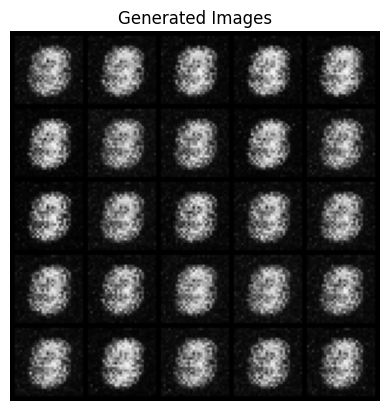

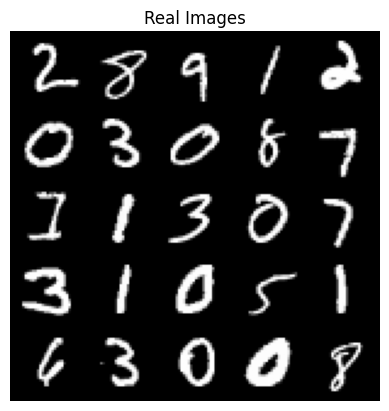

  0%|          | 0/469 [00:00<?, ?it/s]

Step 1000: Generator loss: 1.6752116811275484, discriminator loss: 0.2989775370955471


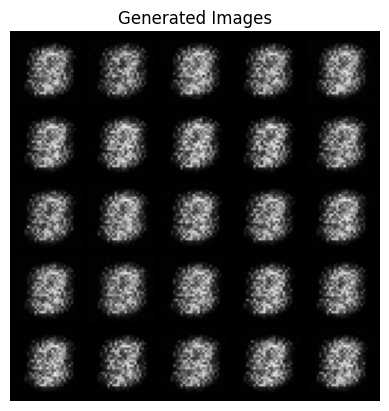

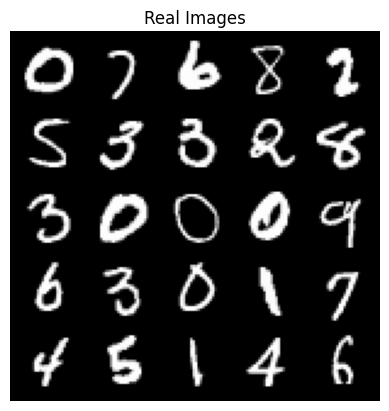

  0%|          | 0/469 [00:00<?, ?it/s]

Step 1500: Generator loss: 1.966245709180831, discriminator loss: 0.1732374719381332


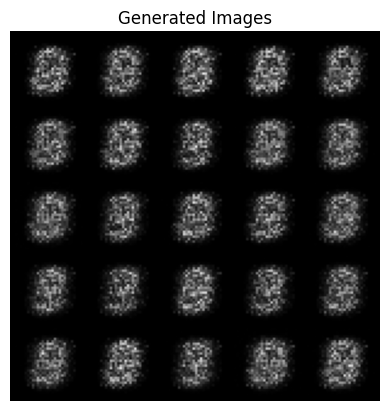

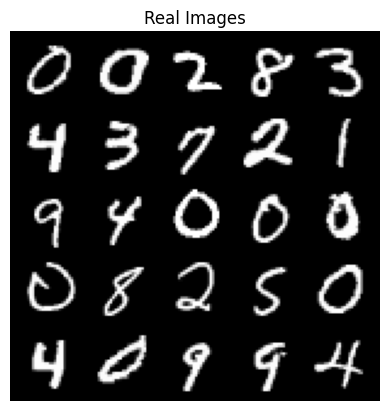

  0%|          | 0/469 [00:00<?, ?it/s]

Step 2000: Generator loss: 1.7951504523754123, discriminator loss: 0.1904017322361469


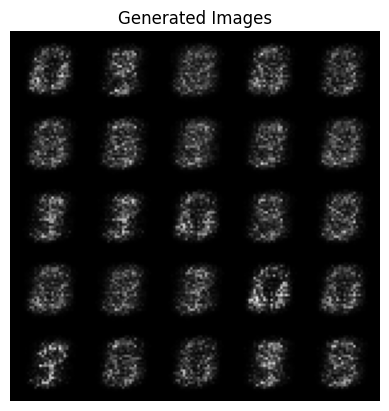

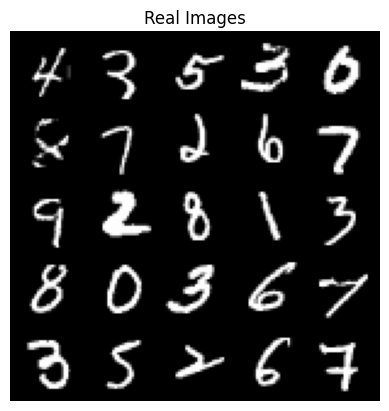

  0%|          | 0/469 [00:00<?, ?it/s]

Step 2500: Generator loss: 1.7323067774772636, discriminator loss: 0.19500787365436548


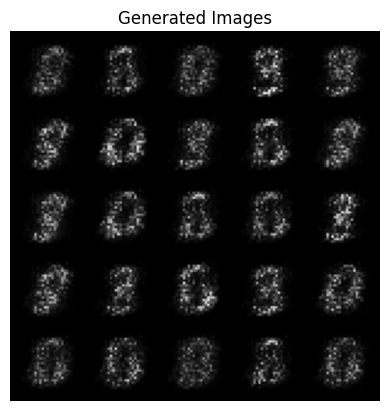

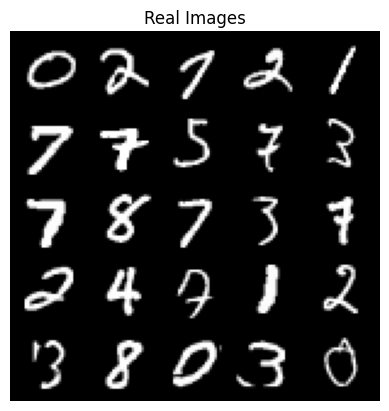

  0%|          | 0/469 [00:00<?, ?it/s]

Step 3000: Generator loss: 2.0327575671672835, discriminator loss: 0.14621099612116814


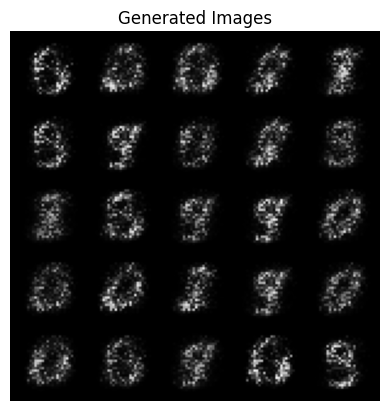

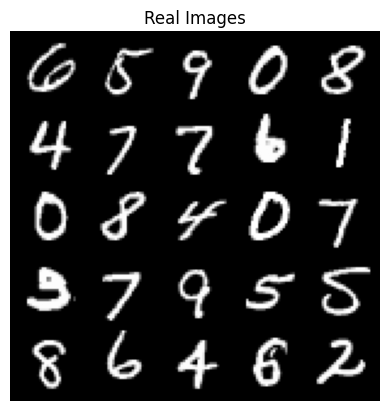

  0%|          | 0/469 [00:00<?, ?it/s]

Step 3500: Generator loss: 2.4533295588493336, discriminator loss: 0.12256894627213488


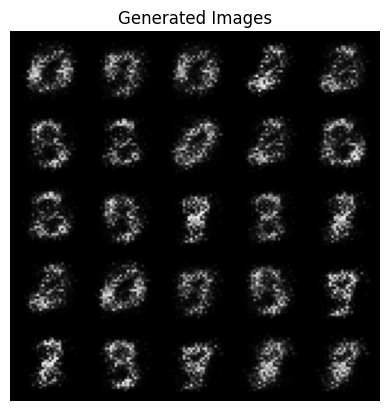

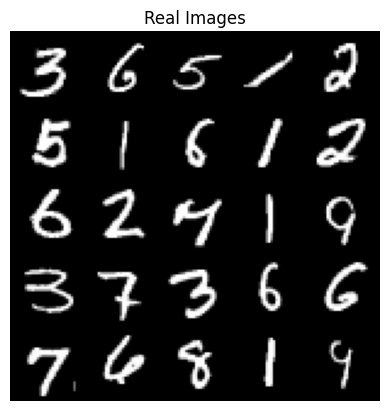

  0%|          | 0/469 [00:00<?, ?it/s]

Step 4000: Generator loss: 2.7351993150711054, discriminator loss: 0.11433720533549786


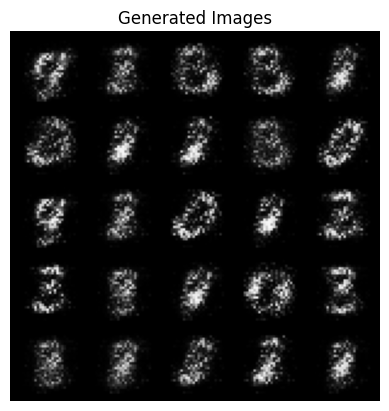

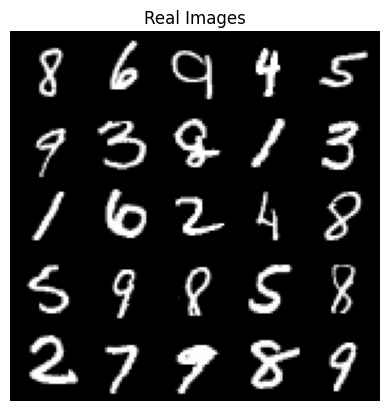

  0%|          | 0/469 [00:00<?, ?it/s]

Step 4500: Generator loss: 3.1645260000228874, discriminator loss: 0.10755278535187233


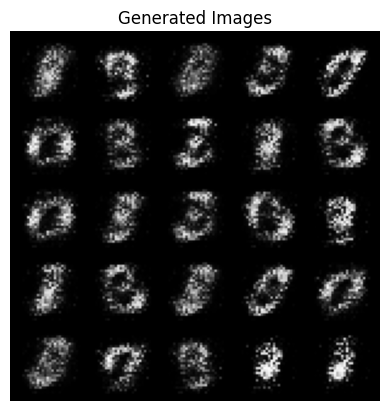

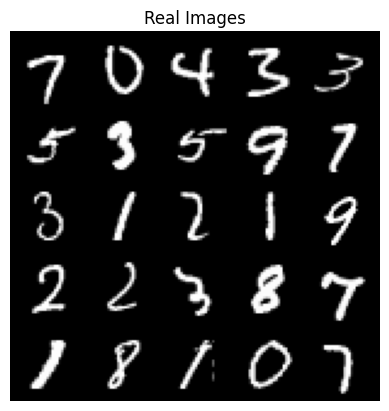

  0%|          | 0/469 [00:00<?, ?it/s]

Step 5000: Generator loss: 3.2486206402778612, discriminator loss: 0.0892565186023712


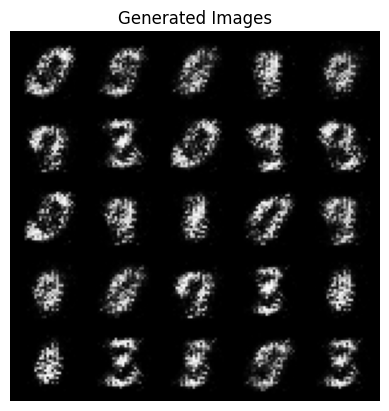

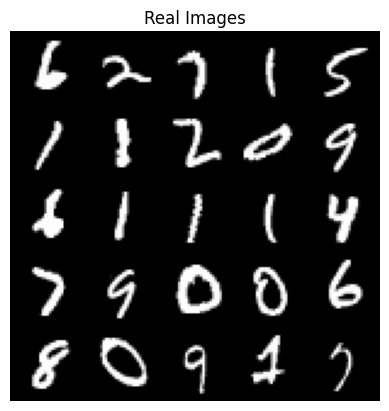

  0%|          | 0/469 [00:00<?, ?it/s]

Step 5500: Generator loss: 3.560741888046263, discriminator loss: 0.0795817150771619


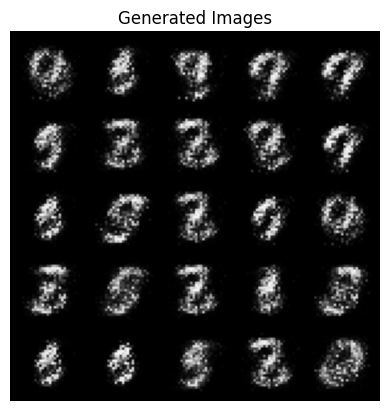

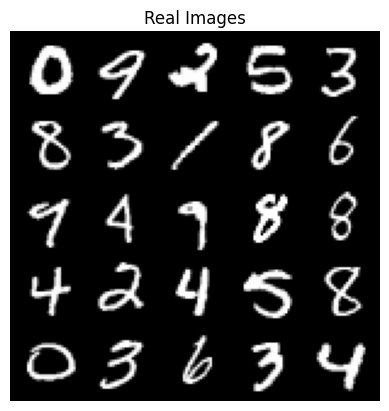

  0%|          | 0/469 [00:00<?, ?it/s]

Step 6000: Generator loss: 3.60465575027466, discriminator loss: 0.08256186545640234


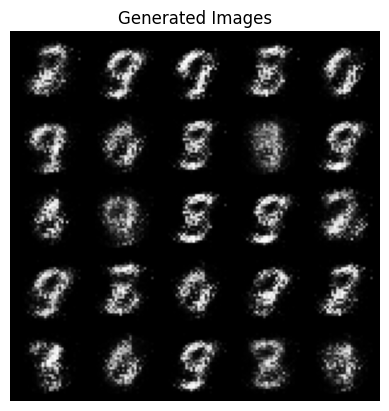

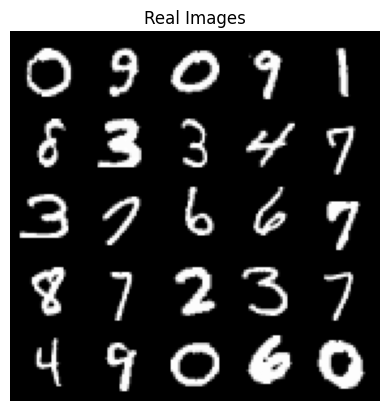

  0%|          | 0/469 [00:00<?, ?it/s]

Step 6500: Generator loss: 3.7242202620506295, discriminator loss: 0.0689858790412545


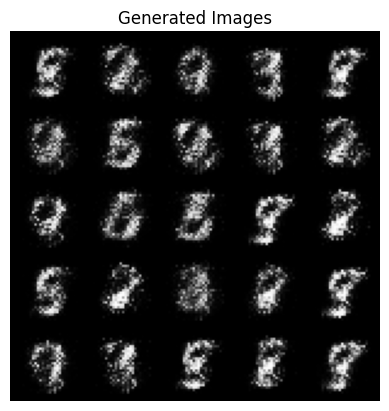

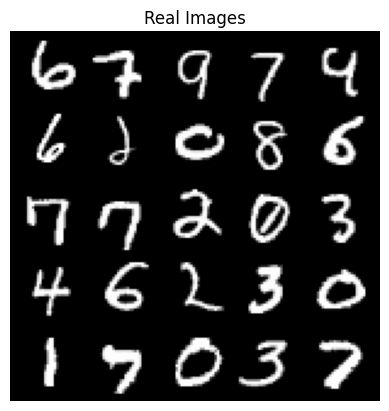

  0%|          | 0/469 [00:00<?, ?it/s]

Step 7000: Generator loss: 3.945892869949343, discriminator loss: 0.06110630571097132


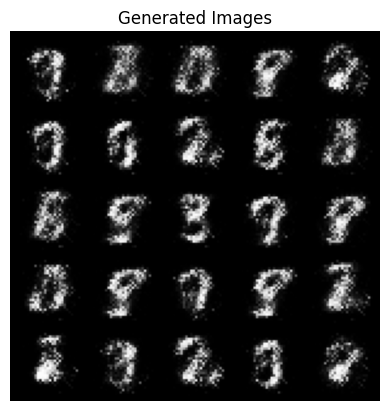

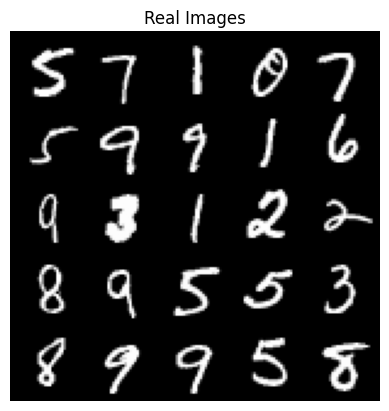

  0%|          | 0/469 [00:00<?, ?it/s]

Step 7500: Generator loss: 4.164419946193699, discriminator loss: 0.055316664531827


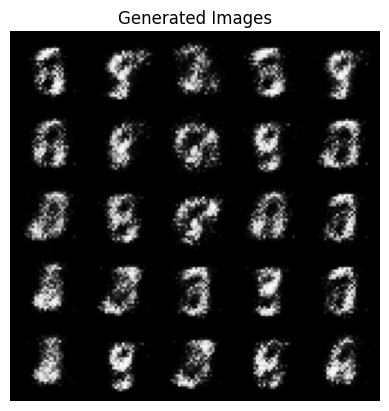

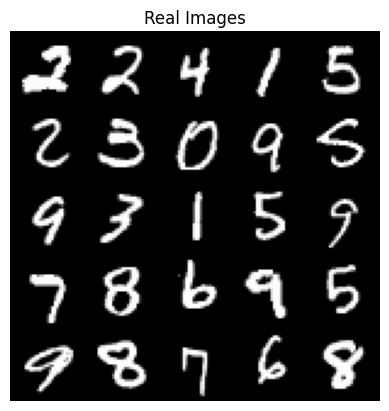

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 8000: Generator loss: 3.935421071052549, discriminator loss: 0.06747968151420351


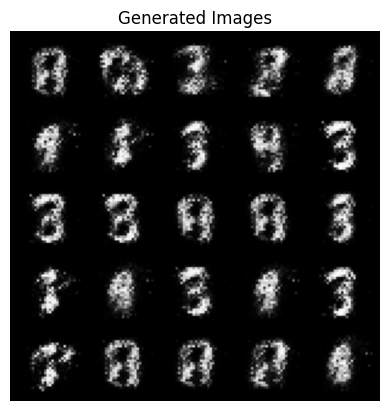

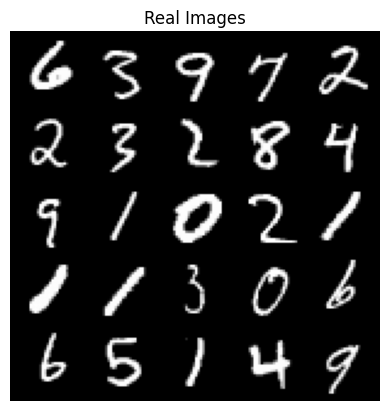

  0%|          | 0/469 [00:00<?, ?it/s]

Step 8500: Generator loss: 3.907022030830386, discriminator loss: 0.06928864144161345


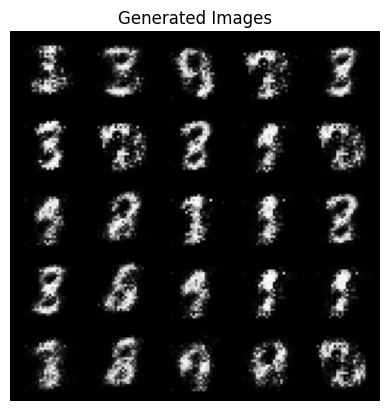

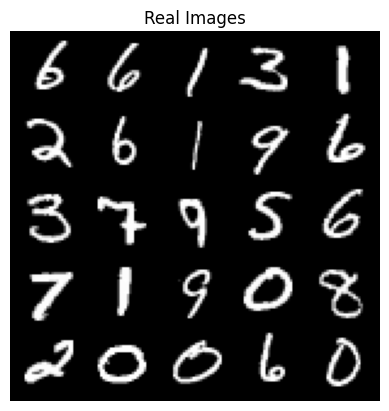

  0%|          | 0/469 [00:00<?, ?it/s]

Step 9000: Generator loss: 4.015588292598723, discriminator loss: 0.06044903422147031


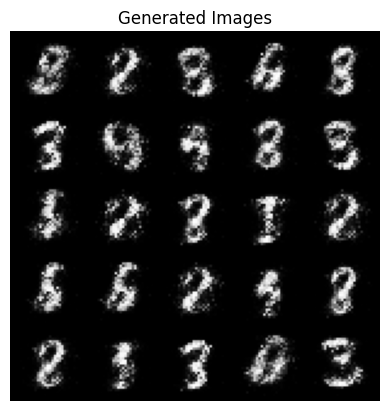

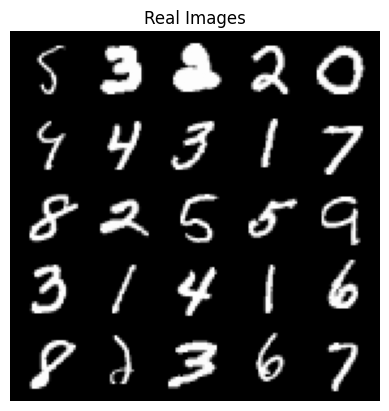

  0%|          | 0/469 [00:00<?, ?it/s]

Step 9500: Generator loss: 4.1125804648399304, discriminator loss: 0.06117262050136926


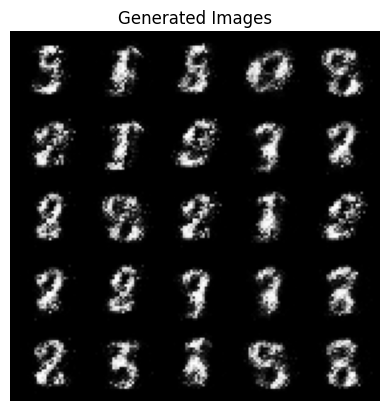

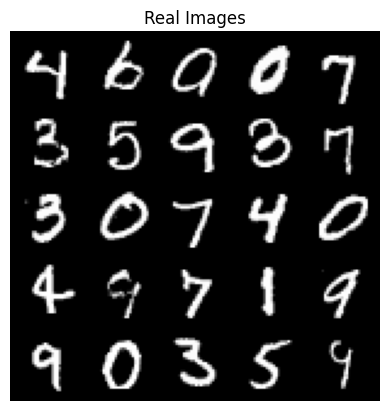

  0%|          | 0/469 [00:00<?, ?it/s]

Step 10000: Generator loss: 3.943544076442717, discriminator loss: 0.07029002615809436


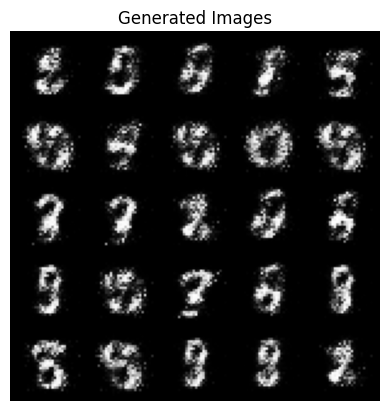

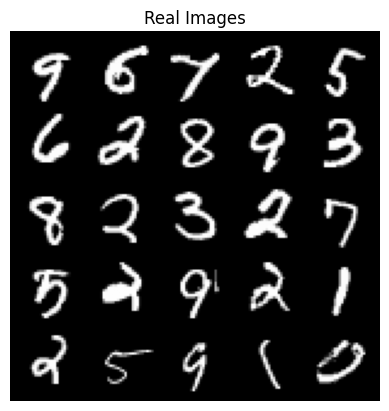

  0%|          | 0/469 [00:00<?, ?it/s]

Step 10500: Generator loss: 4.175644260406496, discriminator loss: 0.05883385414630174


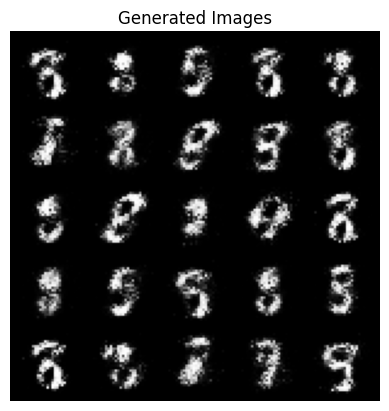

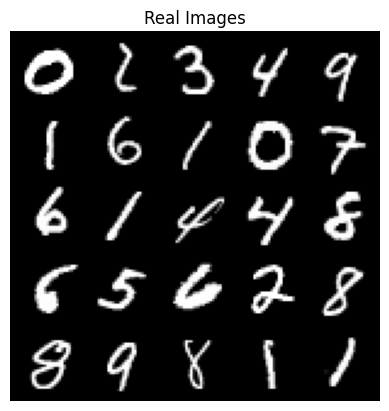

  0%|          | 0/469 [00:00<?, ?it/s]

Step 11000: Generator loss: 3.9527130618095385, discriminator loss: 0.06570290749892593


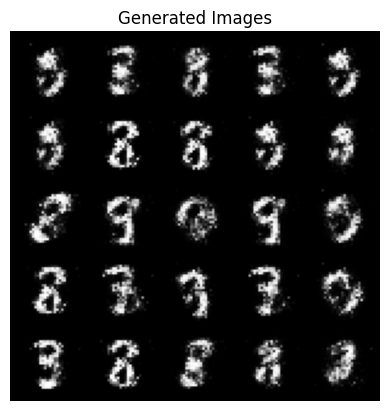

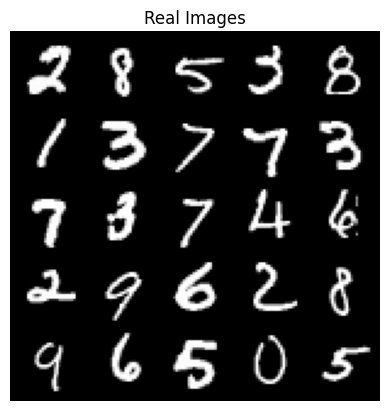

  0%|          | 0/469 [00:00<?, ?it/s]

Step 11500: Generator loss: 4.009637812137602, discriminator loss: 0.07127903468161823


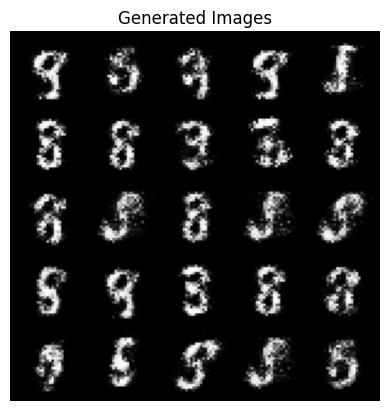

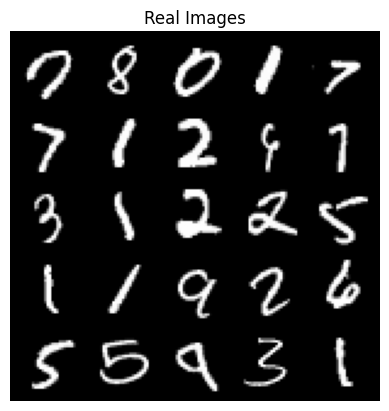

  0%|          | 0/469 [00:00<?, ?it/s]

Step 12000: Generator loss: 3.8173874421119707, discriminator loss: 0.07755778518319127


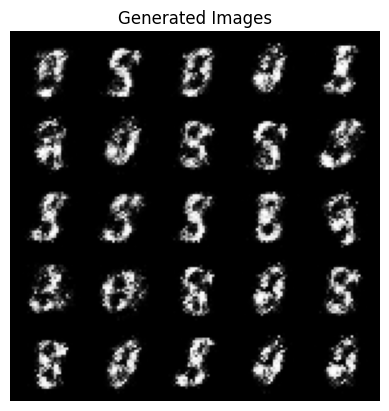

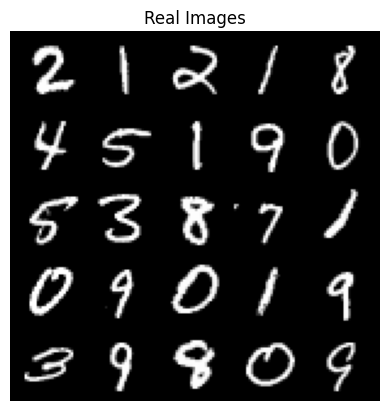

  0%|          | 0/469 [00:00<?, ?it/s]

Step 12500: Generator loss: 3.6878745503425607, discriminator loss: 0.09571947029232979


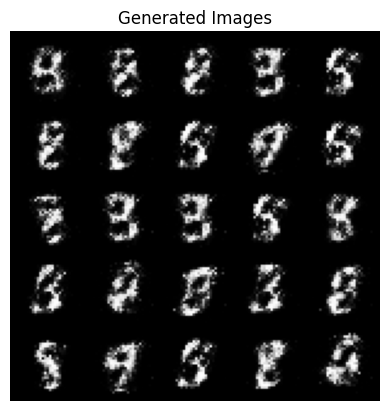

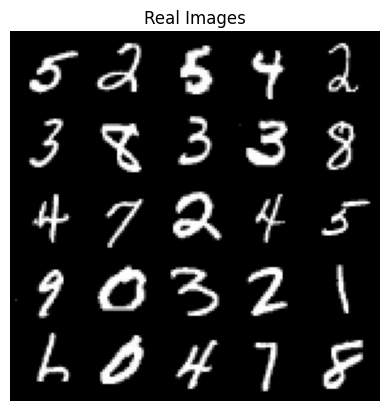

  0%|          | 0/469 [00:00<?, ?it/s]

Step 13000: Generator loss: 3.7635052132606512, discriminator loss: 0.09735109703987836


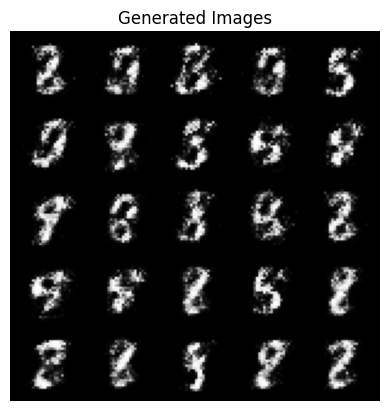

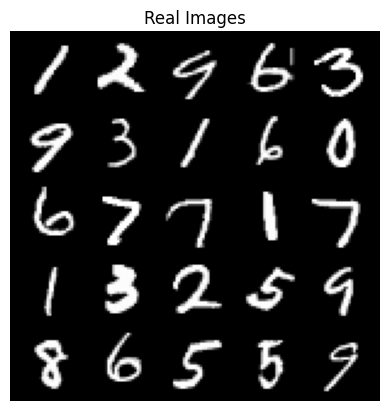

  0%|          | 0/469 [00:00<?, ?it/s]

Step 13500: Generator loss: 3.7270221843719473, discriminator loss: 0.105419007986784


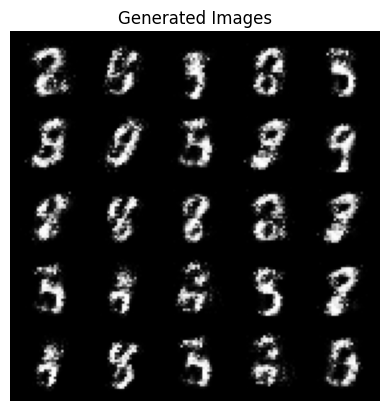

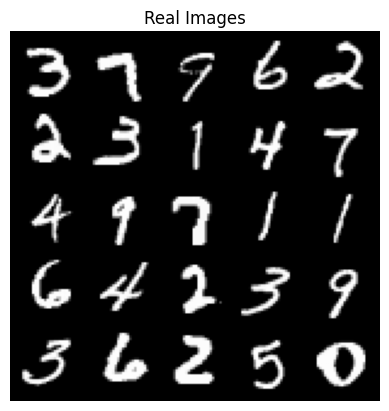

  0%|          | 0/469 [00:00<?, ?it/s]

Step 14000: Generator loss: 3.548480118751526, discriminator loss: 0.10714872561395171


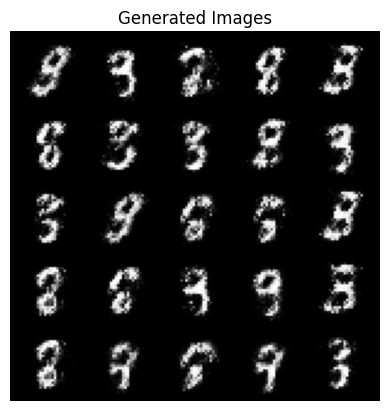

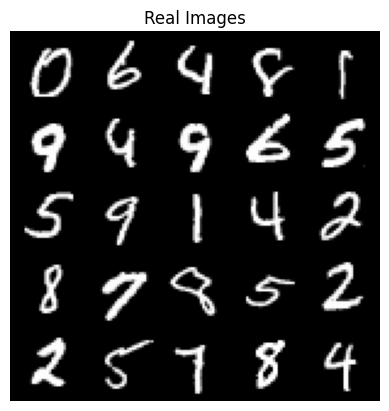

  0%|          | 0/469 [00:00<?, ?it/s]

Step 14500: Generator loss: 3.495989760875698, discriminator loss: 0.12180901646614077


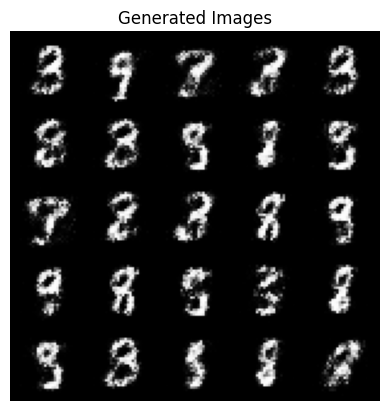

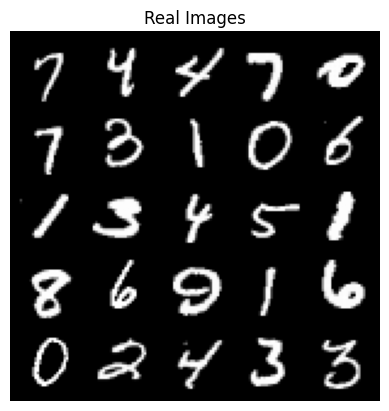

  0%|          | 0/469 [00:00<?, ?it/s]

Step 15000: Generator loss: 3.627239147186279, discriminator loss: 0.11101589303463696


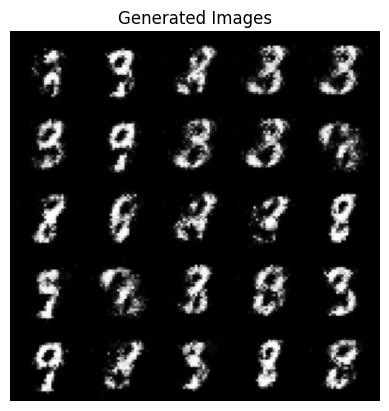

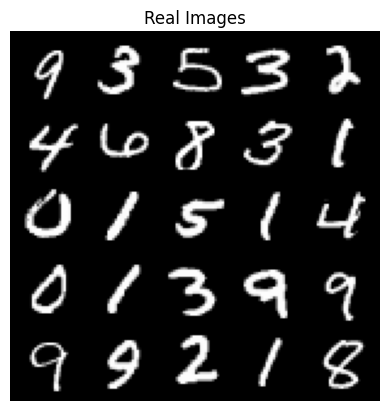

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 15500: Generator loss: 3.4636423878669764, discriminator loss: 0.126401856943965


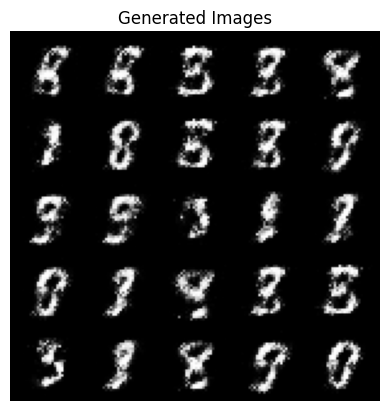

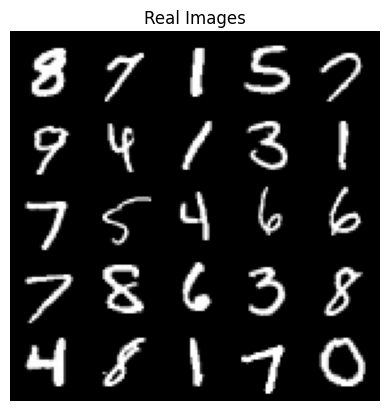

  0%|          | 0/469 [00:00<?, ?it/s]

Step 16000: Generator loss: 3.3705297446250904, discriminator loss: 0.11670511793345217


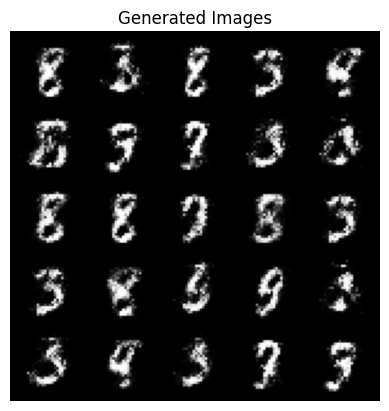

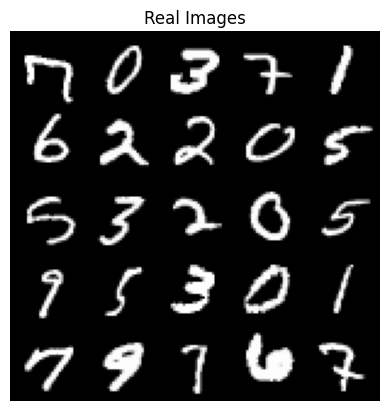

  0%|          | 0/469 [00:00<?, ?it/s]

Step 16500: Generator loss: 3.6613123798370357, discriminator loss: 0.09868701148778188


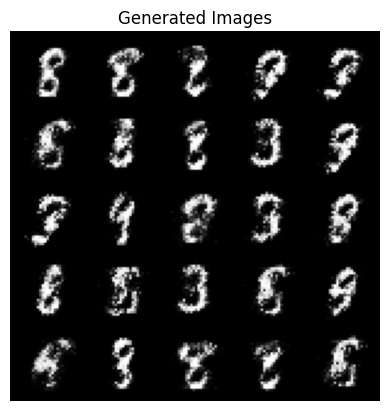

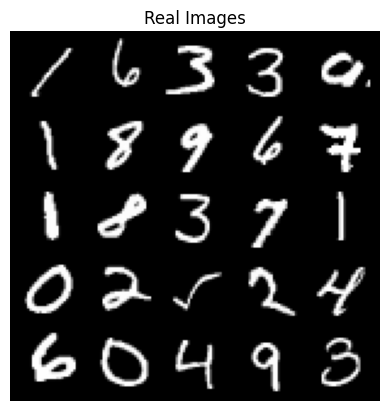

  0%|          | 0/469 [00:00<?, ?it/s]

Step 17000: Generator loss: 3.7126920104026806, discriminator loss: 0.11595722210407254


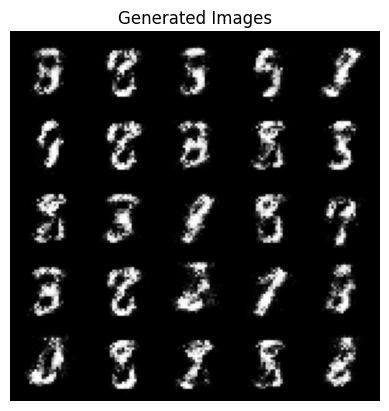

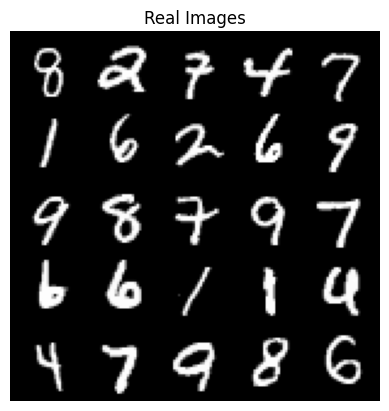

  0%|          | 0/469 [00:00<?, ?it/s]

Step 17500: Generator loss: 3.809108702659606, discriminator loss: 0.10580987310409543


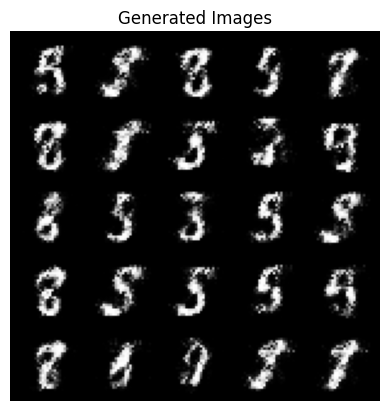

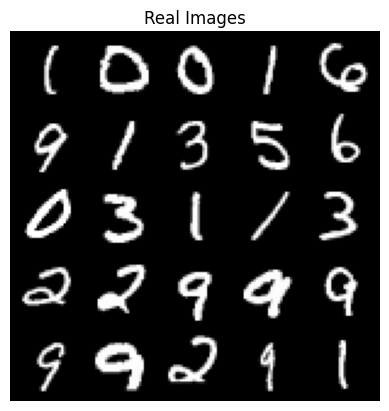

  0%|          | 0/469 [00:00<?, ?it/s]

Step 18000: Generator loss: 3.7000303993225083, discriminator loss: 0.12022926050424579


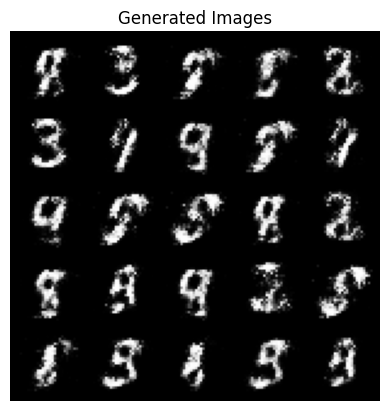

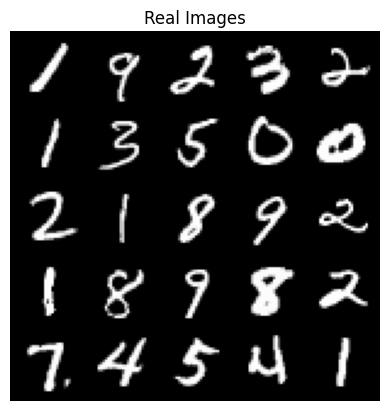

  0%|          | 0/469 [00:00<?, ?it/s]

Step 18500: Generator loss: 3.654749267578124, discriminator loss: 0.12208848589658733


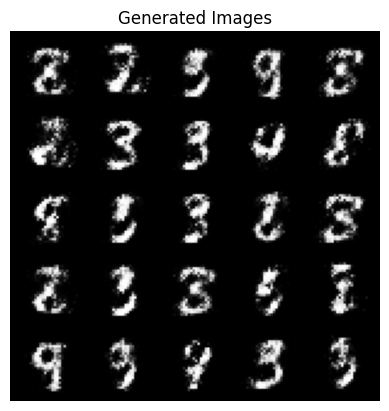

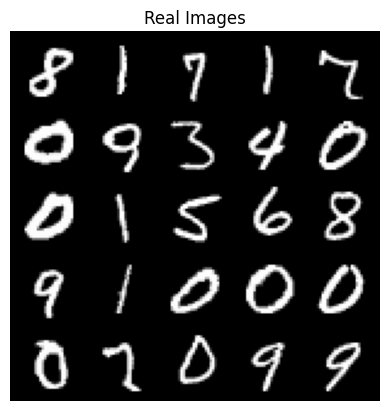

  0%|          | 0/469 [00:00<?, ?it/s]

Step 19000: Generator loss: 3.5289017844200115, discriminator loss: 0.1250883815065027


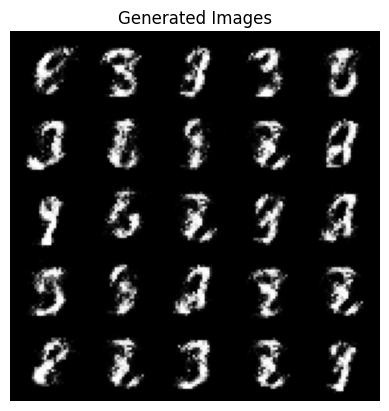

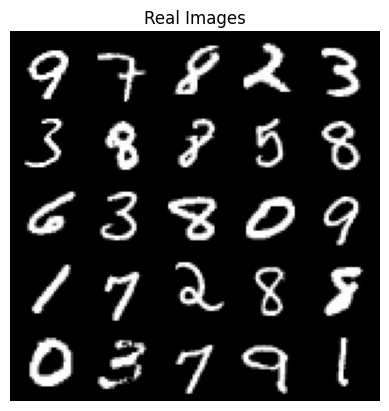

  0%|          | 0/469 [00:00<?, ?it/s]

Step 19500: Generator loss: 3.481481202602387, discriminator loss: 0.14252216322720043


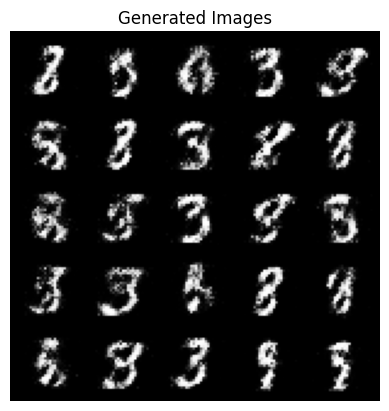

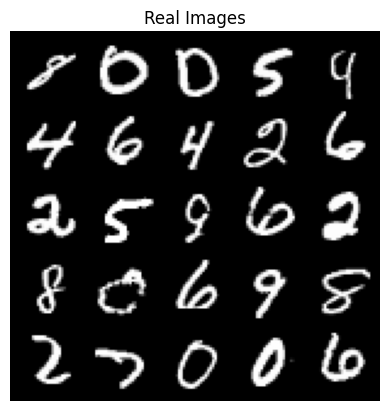

  0%|          | 0/469 [00:00<?, ?it/s]

Step 20000: Generator loss: 3.347362432479857, discriminator loss: 0.14688914240896714


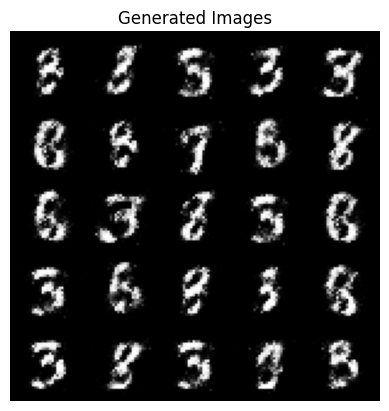

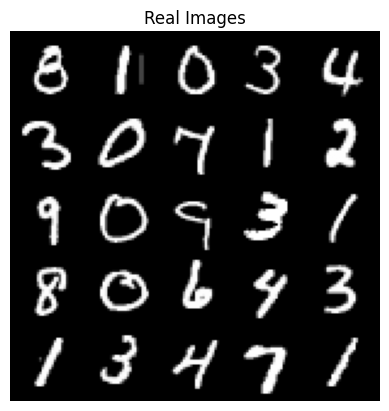

  0%|          | 0/469 [00:00<?, ?it/s]

Step 20500: Generator loss: 3.3580390653610217, discriminator loss: 0.14817211647331707


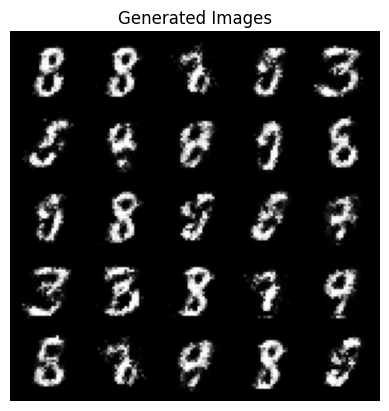

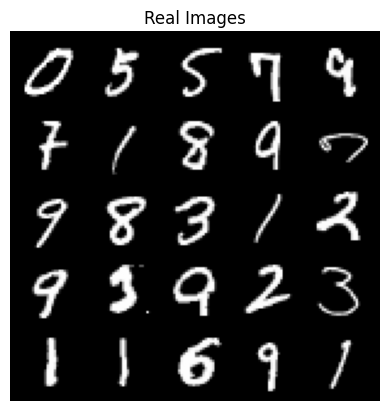

  0%|          | 0/469 [00:00<?, ?it/s]

Step 21000: Generator loss: 3.2033379697799678, discriminator loss: 0.16215135133266456


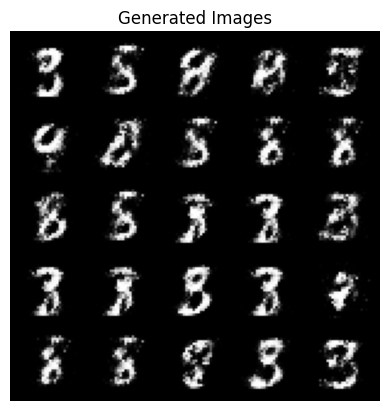

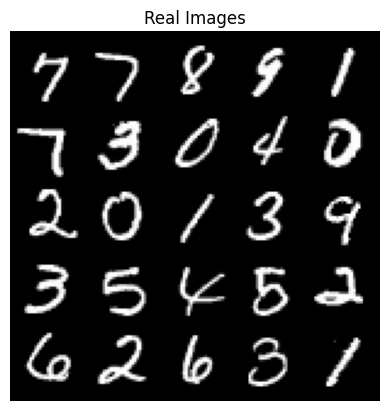

  0%|          | 0/469 [00:00<?, ?it/s]

Step 21500: Generator loss: 3.240552123069767, discriminator loss: 0.16318840302526946


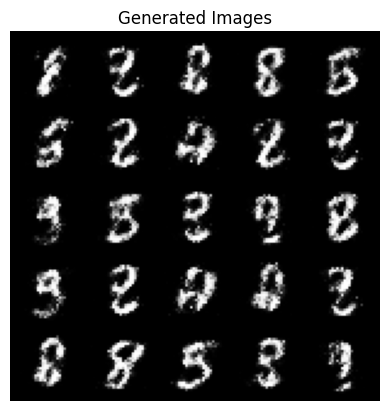

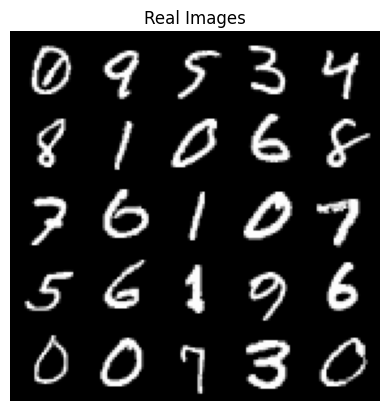

  0%|          | 0/469 [00:00<?, ?it/s]

Step 22000: Generator loss: 3.22899577665329, discriminator loss: 0.15662228548526774


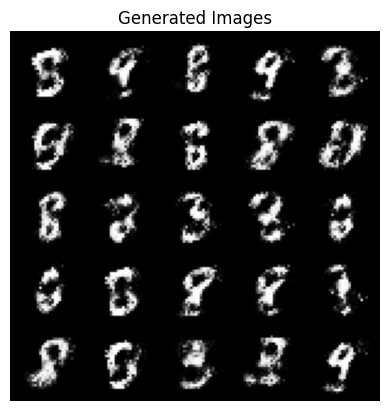

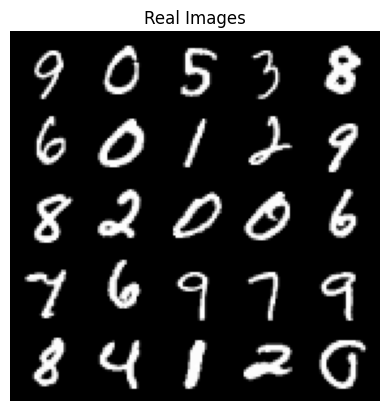

  0%|          | 0/469 [00:00<?, ?it/s]

Step 22500: Generator loss: 3.1931919035911513, discriminator loss: 0.17435609108209613


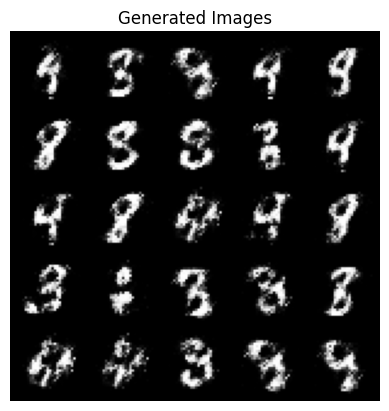

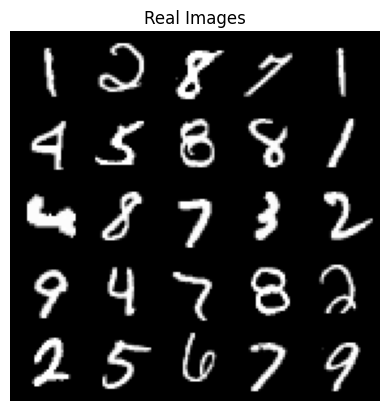

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 23000: Generator loss: 3.158434730529785, discriminator loss: 0.16864607127010842


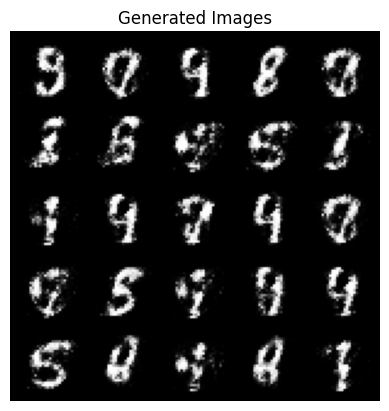

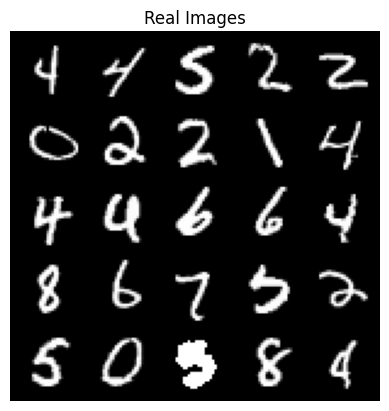

  0%|          | 0/469 [00:00<?, ?it/s]

Step 23500: Generator loss: 3.00626249837875, discriminator loss: 0.19114308737218375


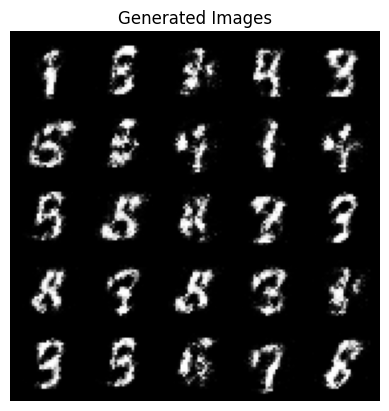

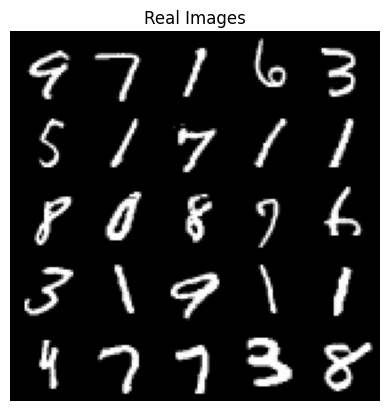

  0%|          | 0/469 [00:00<?, ?it/s]

Step 24000: Generator loss: 3.0940947995185852, discriminator loss: 0.16969508269429195


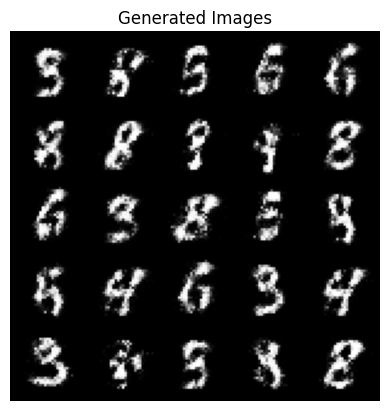

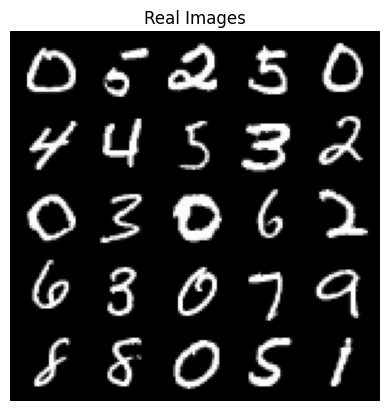

  0%|          | 0/469 [00:00<?, ?it/s]

Step 24500: Generator loss: 3.1174235553741476, discriminator loss: 0.16884947253763685


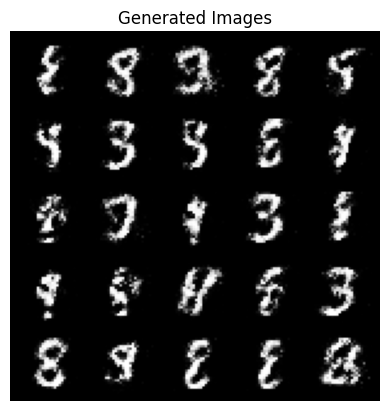

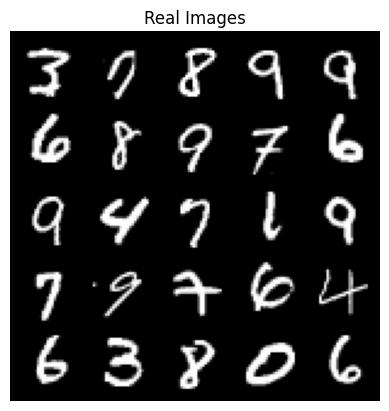

  0%|          | 0/469 [00:00<?, ?it/s]

Step 25000: Generator loss: 3.120015174388884, discriminator loss: 0.1714709610044956


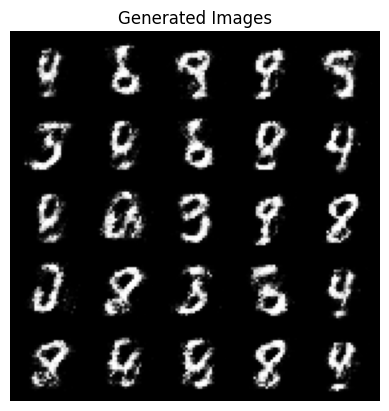

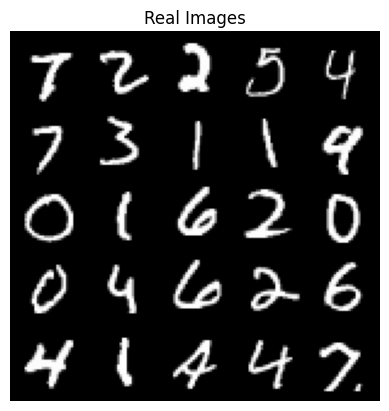

  0%|          | 0/469 [00:00<?, ?it/s]

Step 25500: Generator loss: 3.068167766571046, discriminator loss: 0.166849275290966


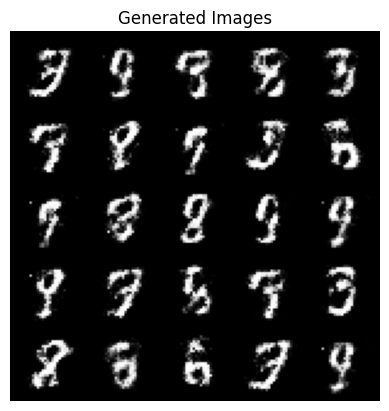

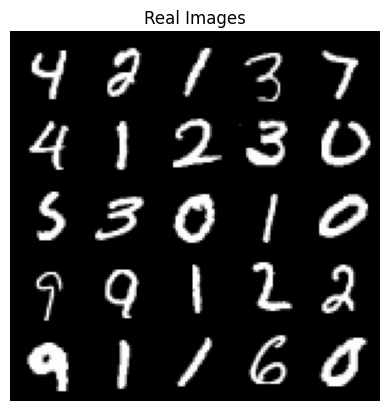

  0%|          | 0/469 [00:00<?, ?it/s]

Step 26000: Generator loss: 3.034519690036774, discriminator loss: 0.1741465110182763


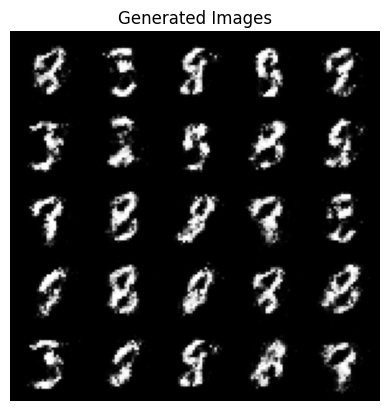

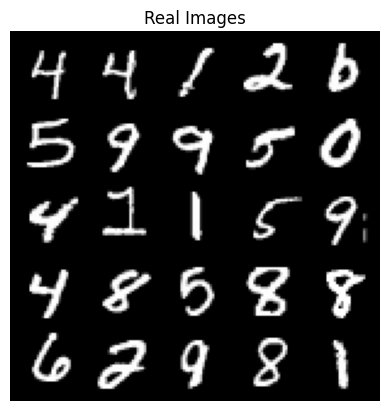

  0%|          | 0/469 [00:00<?, ?it/s]

Step 26500: Generator loss: 2.9697831230163576, discriminator loss: 0.17852583159506305


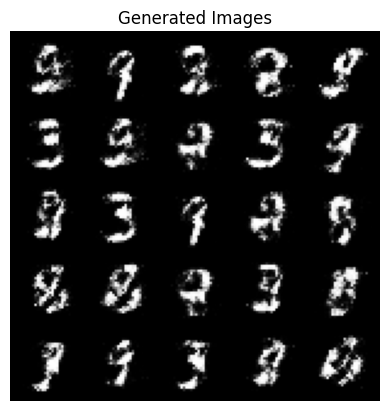

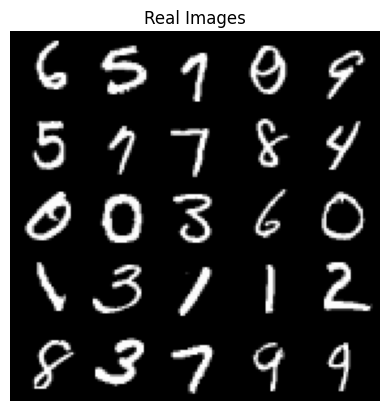

  0%|          | 0/469 [00:00<?, ?it/s]

Step 27000: Generator loss: 3.0773684701919546, discriminator loss: 0.18615699112415324


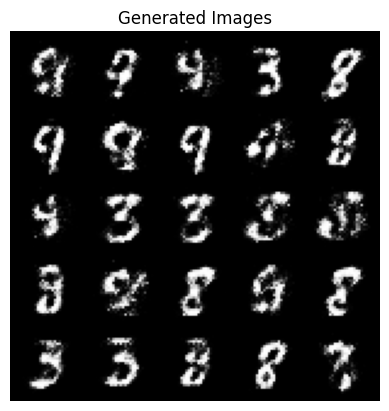

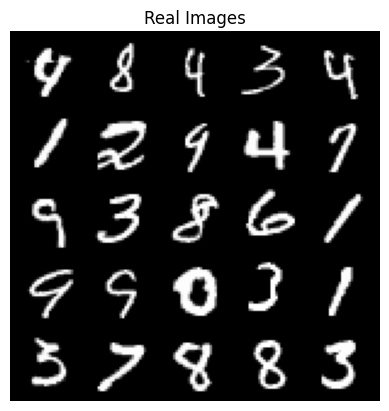

  0%|          | 0/469 [00:00<?, ?it/s]

Step 27500: Generator loss: 2.845305778503418, discriminator loss: 0.2195417128652334


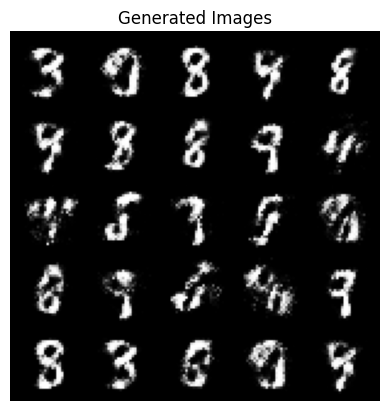

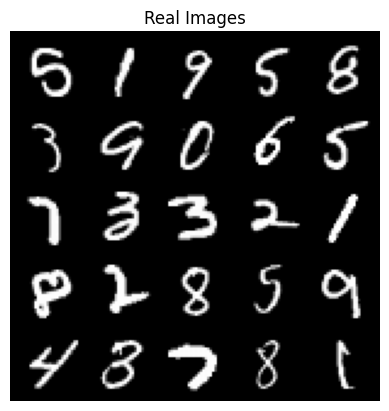

  0%|          | 0/469 [00:00<?, ?it/s]

Step 28000: Generator loss: 2.775532147407533, discriminator loss: 0.1993360310345889


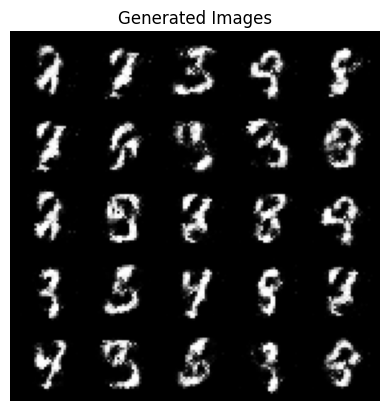

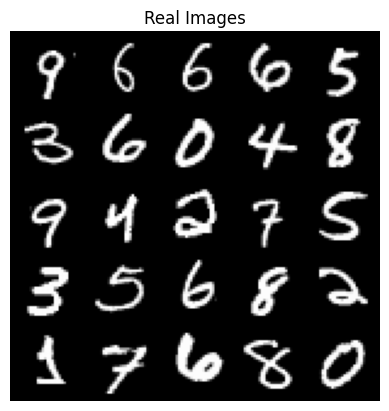

  0%|          | 0/469 [00:00<?, ?it/s]

Step 28500: Generator loss: 2.8814812755584724, discriminator loss: 0.20514965333044524


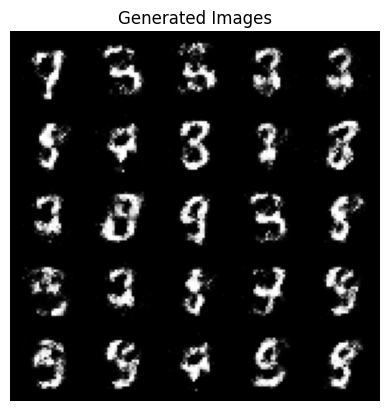

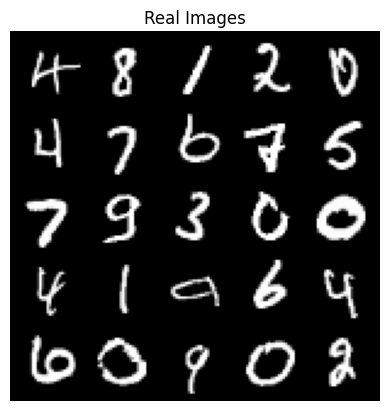

  0%|          | 0/469 [00:00<?, ?it/s]

Step 29000: Generator loss: 2.626711749553681, discriminator loss: 0.2468681864142418


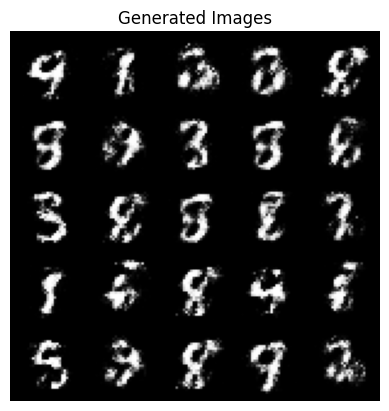

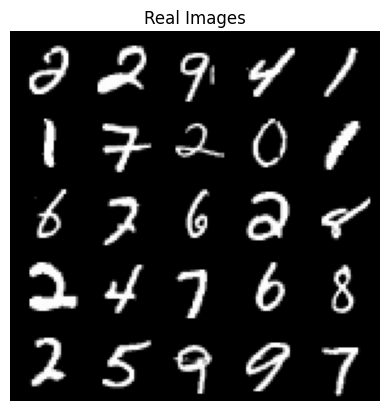

  0%|          | 0/469 [00:00<?, ?it/s]

Step 29500: Generator loss: 2.6817887907028193, discriminator loss: 0.22660973584651925


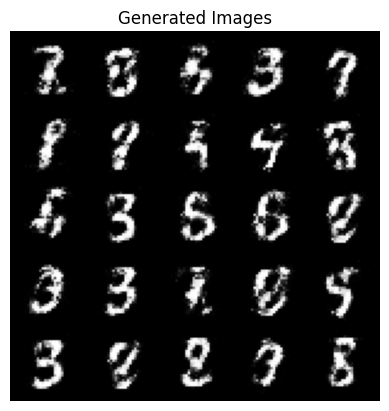

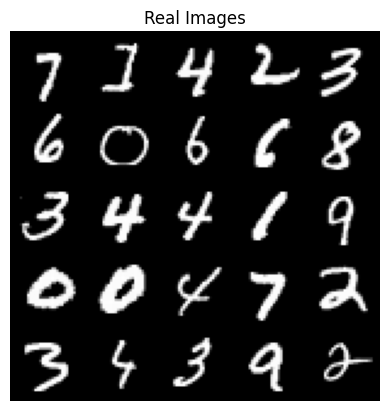

  0%|          | 0/469 [00:00<?, ?it/s]

Step 30000: Generator loss: 2.6574088382720964, discriminator loss: 0.22446278893947627


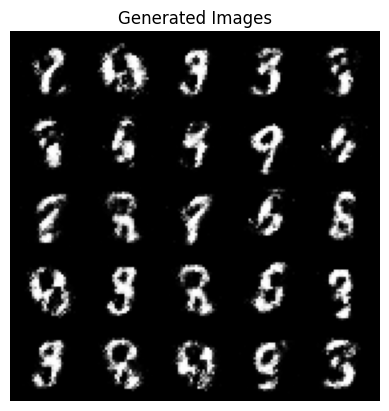

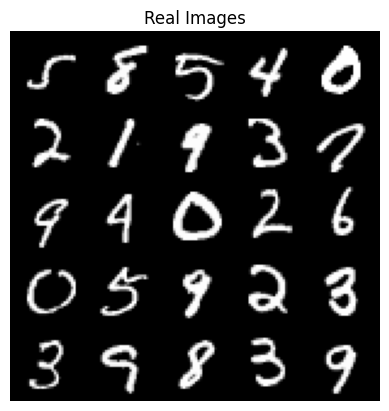

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 30500: Generator loss: 2.6982850995063807, discriminator loss: 0.21655465903878196


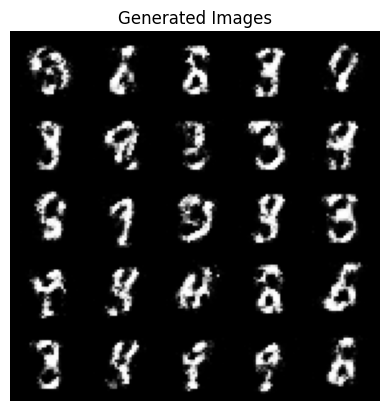

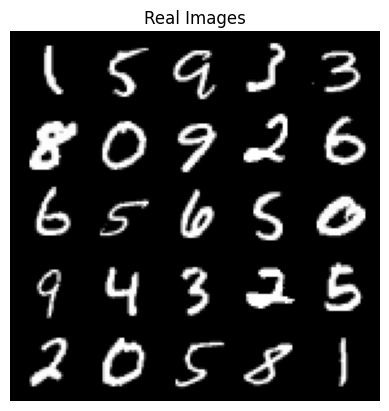

  0%|          | 0/469 [00:00<?, ?it/s]

Step 31000: Generator loss: 2.7259543628692633, discriminator loss: 0.21373876520991322


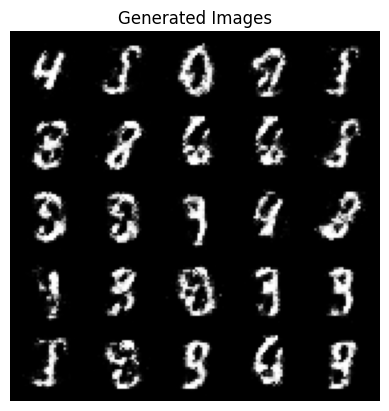

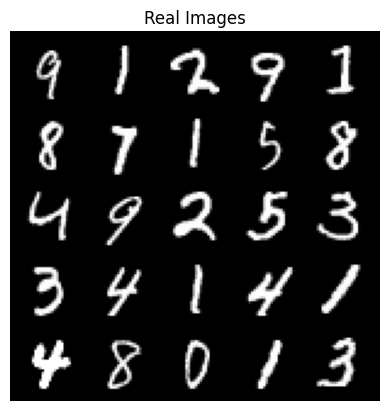

  0%|          | 0/469 [00:00<?, ?it/s]

Step 31500: Generator loss: 2.674721341609954, discriminator loss: 0.22312921912968137


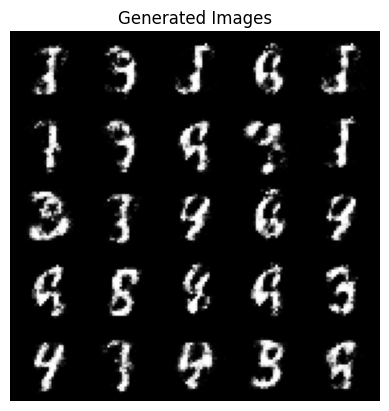

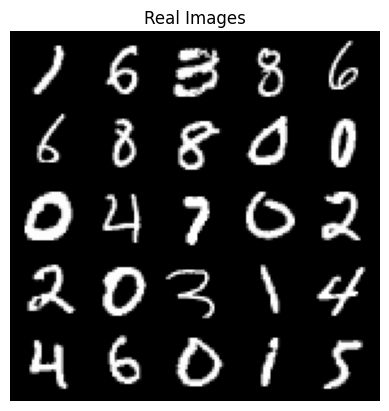

  0%|          | 0/469 [00:00<?, ?it/s]

Step 32000: Generator loss: 2.63629993057251, discriminator loss: 0.23045496055483808


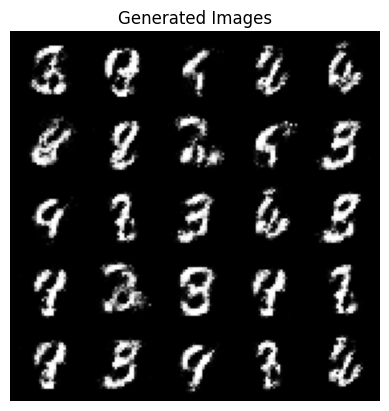

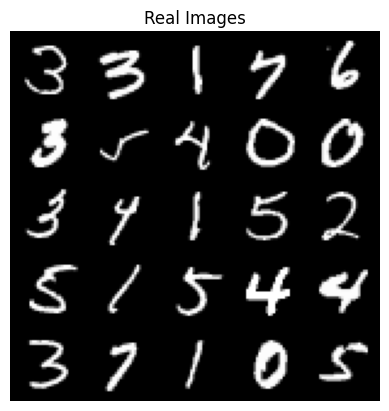

  0%|          | 0/469 [00:00<?, ?it/s]

Step 32500: Generator loss: 2.6224265294075004, discriminator loss: 0.24262451916933067


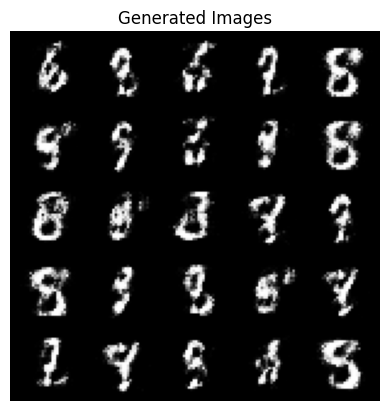

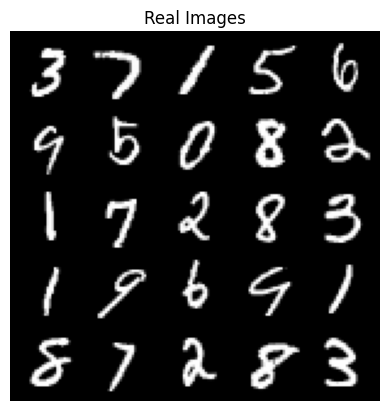

  0%|          | 0/469 [00:00<?, ?it/s]

Step 33000: Generator loss: 2.5339927246570575, discriminator loss: 0.24563299468159688


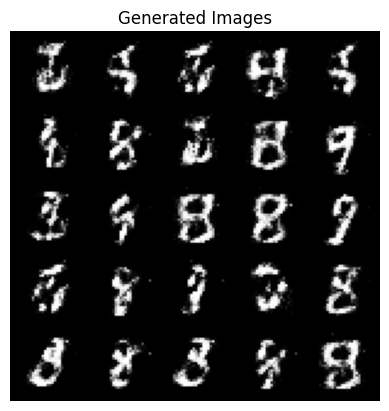

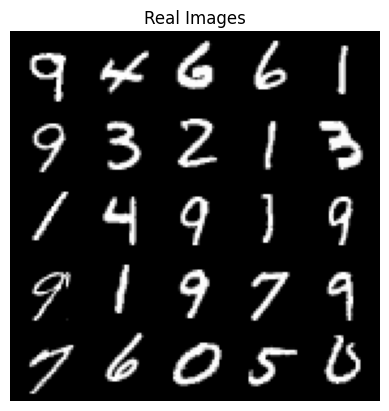

  0%|          | 0/469 [00:00<?, ?it/s]

Step 33500: Generator loss: 2.646974040508269, discriminator loss: 0.22220613637566553


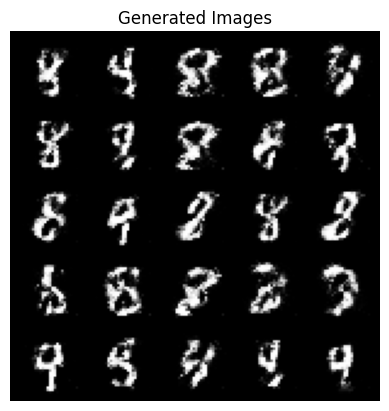

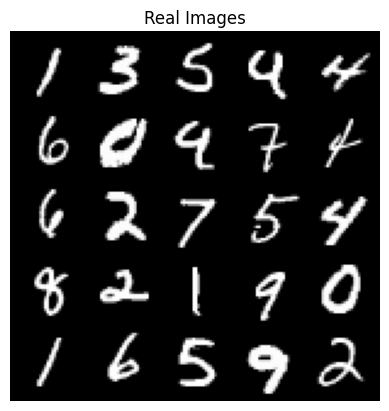

  0%|          | 0/469 [00:00<?, ?it/s]

Step 34000: Generator loss: 2.6684204163551333, discriminator loss: 0.22769568166136736


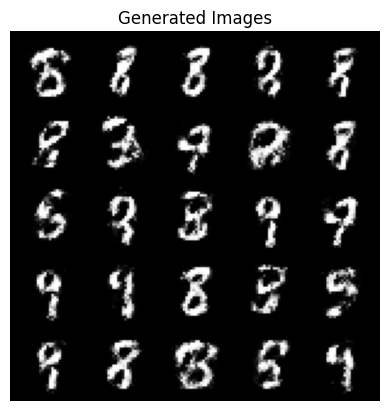

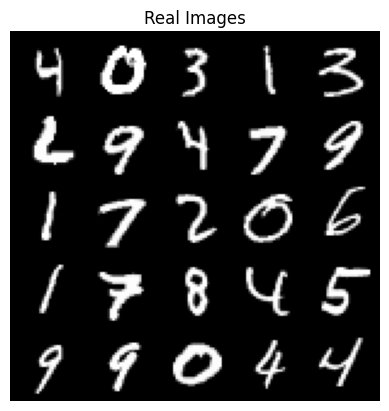

  0%|          | 0/469 [00:00<?, ?it/s]

Step 34500: Generator loss: 2.4893671834468836, discriminator loss: 0.24515113914012918


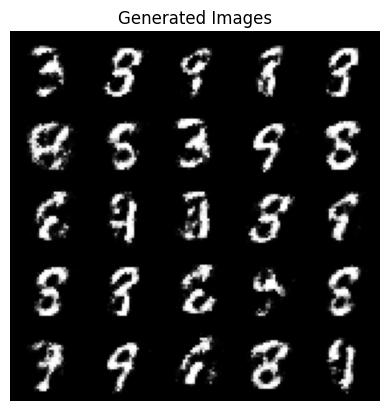

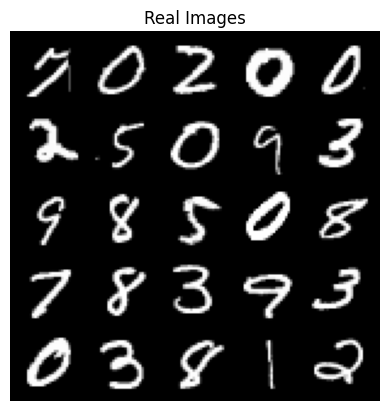

  0%|          | 0/469 [00:00<?, ?it/s]

Step 35000: Generator loss: 2.5876192946434013, discriminator loss: 0.23344883230328564


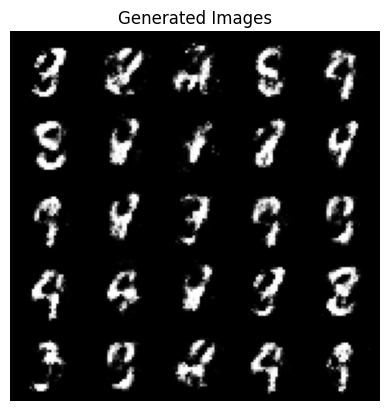

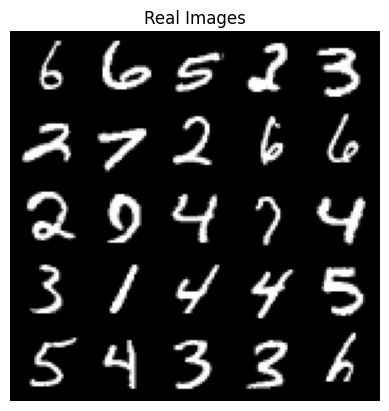

  0%|          | 0/469 [00:00<?, ?it/s]

Step 35500: Generator loss: 2.5160947818756063, discriminator loss: 0.25337784308195116


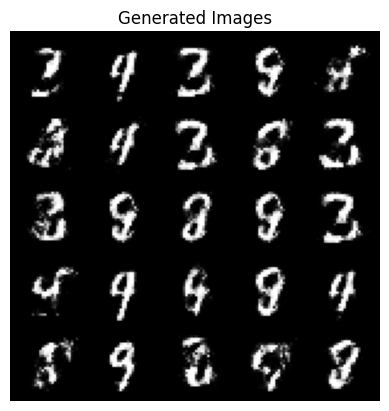

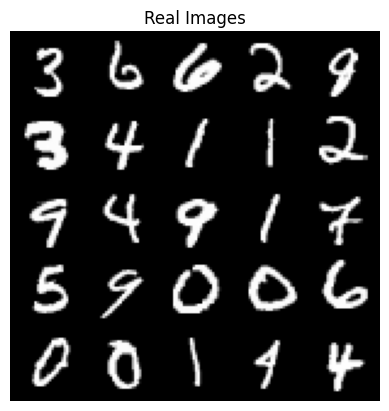

  0%|          | 0/469 [00:00<?, ?it/s]

Step 36000: Generator loss: 2.5270627181530005, discriminator loss: 0.2561001297831536


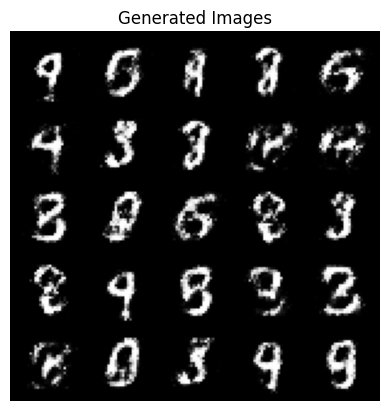

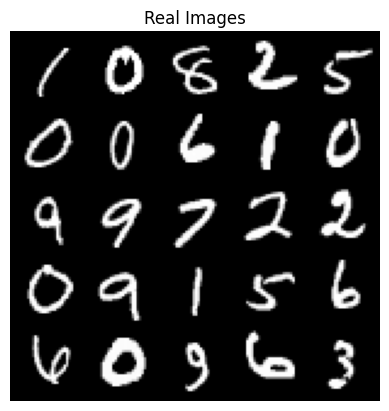

  0%|          | 0/469 [00:00<?, ?it/s]

Step 36500: Generator loss: 2.3540948243141204, discriminator loss: 0.27831068402528747


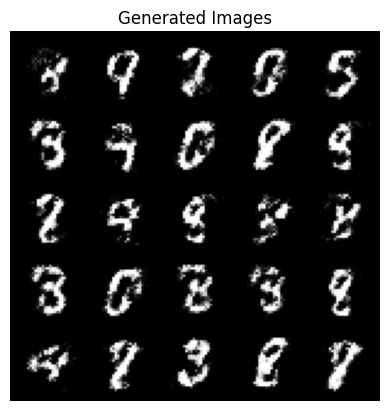

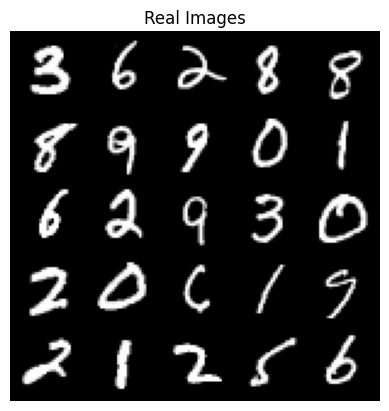

  0%|          | 0/469 [00:00<?, ?it/s]

Step 37000: Generator loss: 2.4378248023986795, discriminator loss: 0.263684158951044


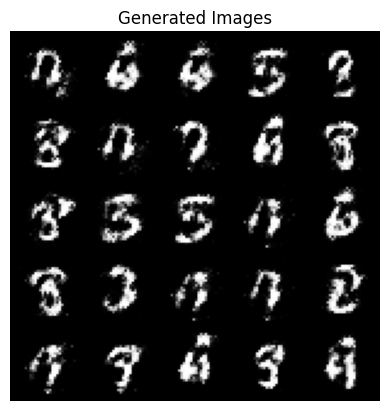

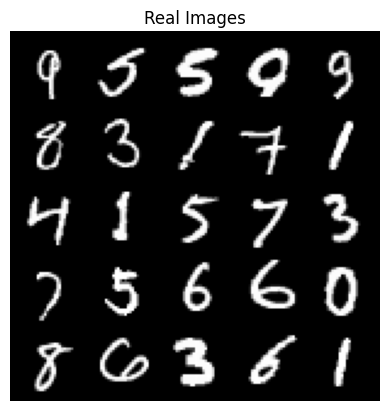

  0%|          | 0/469 [00:00<?, ?it/s]

Step 37500: Generator loss: 2.4480421586036707, discriminator loss: 0.2643575921952727


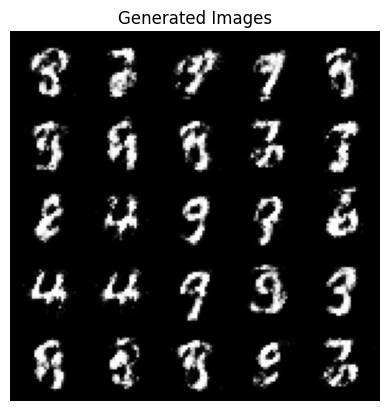

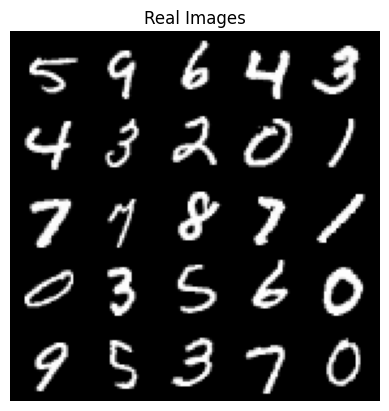

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 38000: Generator loss: 2.345209357261655, discriminator loss: 0.2906747999191284


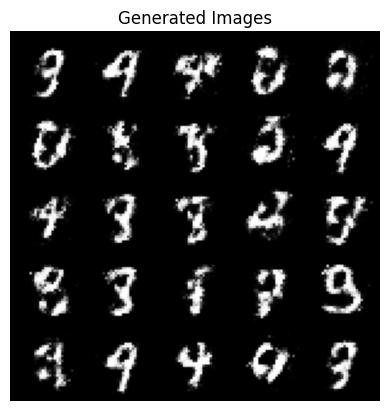

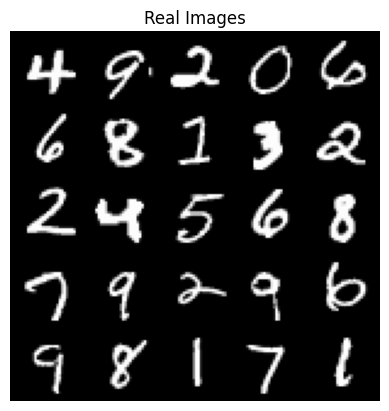

  0%|          | 0/469 [00:00<?, ?it/s]

Step 38500: Generator loss: 2.2227733929157263, discriminator loss: 0.30745908161997754


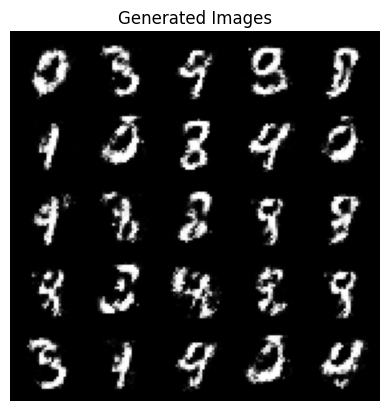

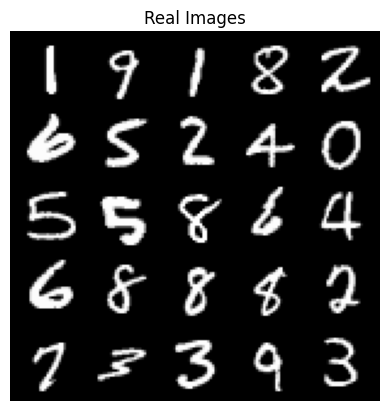

  0%|          | 0/469 [00:00<?, ?it/s]

Step 39000: Generator loss: 2.2656512153148682, discriminator loss: 0.2794863457679751


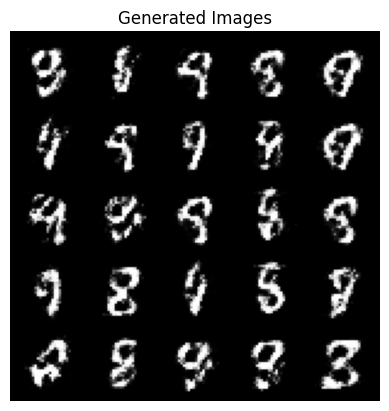

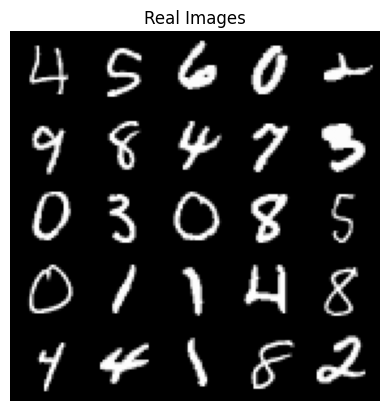

  0%|          | 0/469 [00:00<?, ?it/s]

Step 39500: Generator loss: 2.294080599308014, discriminator loss: 0.2834411644637586


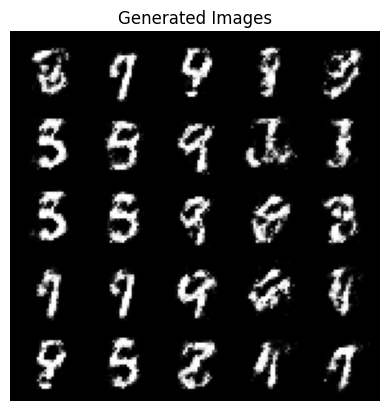

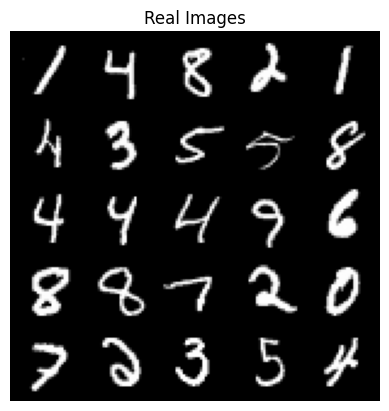

  0%|          | 0/469 [00:00<?, ?it/s]

Step 40000: Generator loss: 2.201001106023788, discriminator loss: 0.30026098123192796


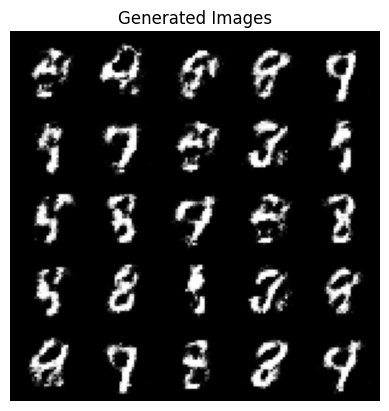

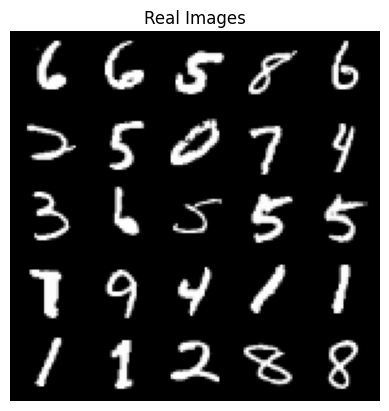

  0%|          | 0/469 [00:00<?, ?it/s]

Step 40500: Generator loss: 2.1603139824867243, discriminator loss: 0.2986186927855015


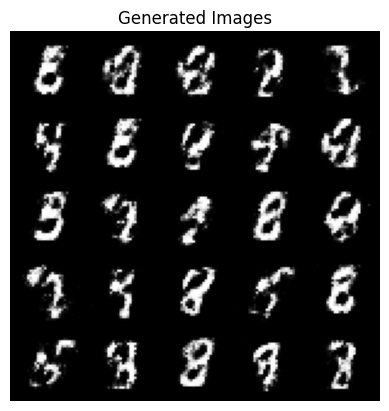

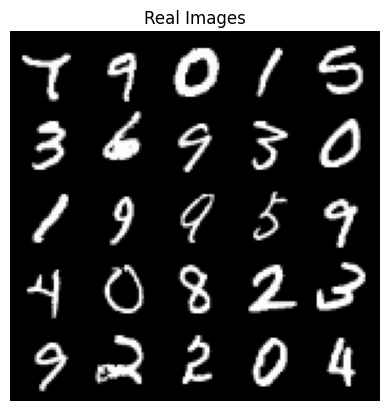

  0%|          | 0/469 [00:00<?, ?it/s]

Step 41000: Generator loss: 2.2106099748611427, discriminator loss: 0.29010191968083393


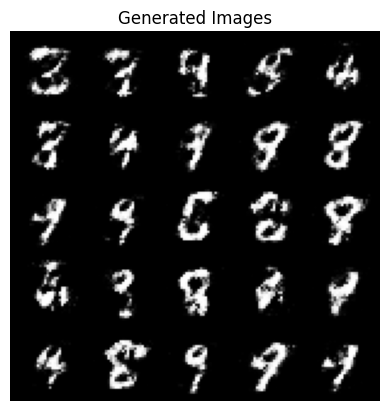

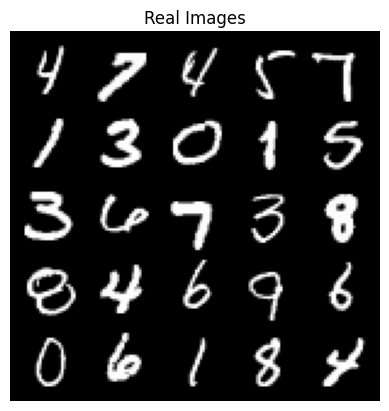

  0%|          | 0/469 [00:00<?, ?it/s]

Step 41500: Generator loss: 2.1993277151584634, discriminator loss: 0.2873603772521019


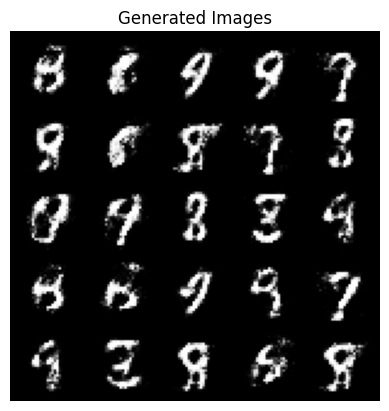

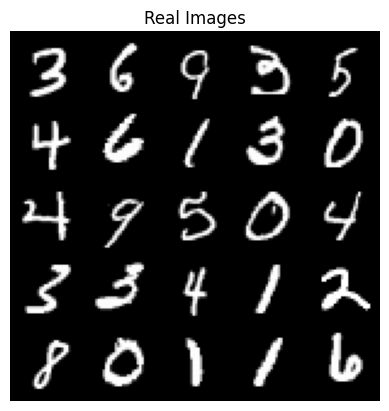

  0%|          | 0/469 [00:00<?, ?it/s]

Step 42000: Generator loss: 2.1668945796489734, discriminator loss: 0.3001965233385561


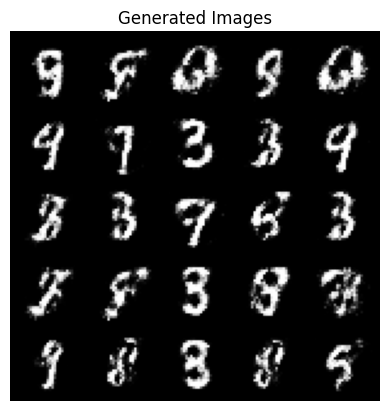

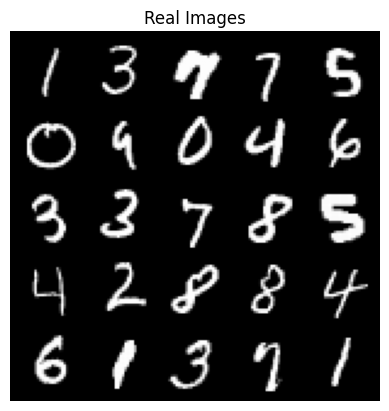

  0%|          | 0/469 [00:00<?, ?it/s]

Step 42500: Generator loss: 2.060481752157212, discriminator loss: 0.31576447108387956


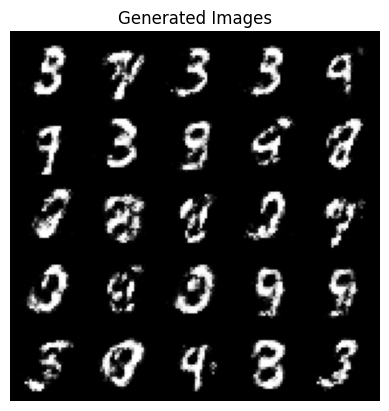

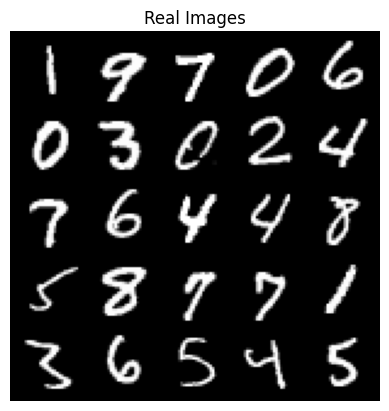

  0%|          | 0/469 [00:00<?, ?it/s]

Step 43000: Generator loss: 2.0897179229259493, discriminator loss: 0.3128457358181479


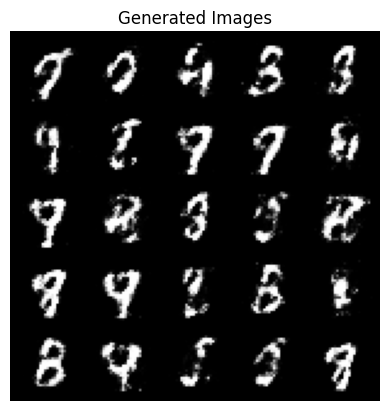

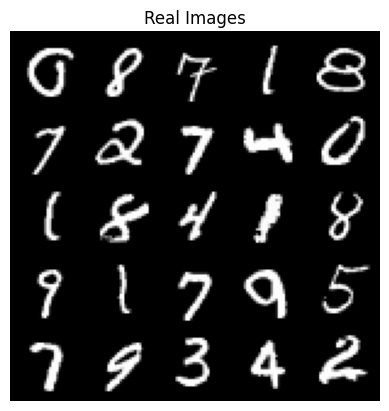

  0%|          | 0/469 [00:00<?, ?it/s]

Step 43500: Generator loss: 2.237206277132034, discriminator loss: 0.2779024685919283


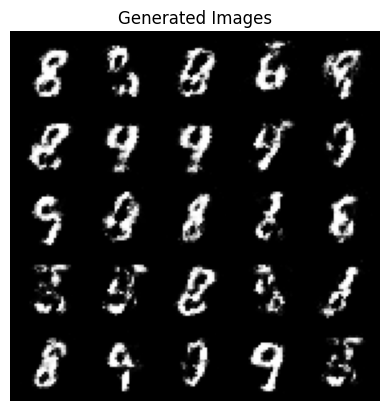

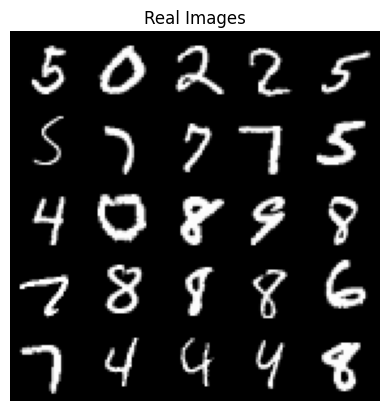

  0%|          | 0/469 [00:00<?, ?it/s]

Step 44000: Generator loss: 2.3652314088344575, discriminator loss: 0.26307166692614536


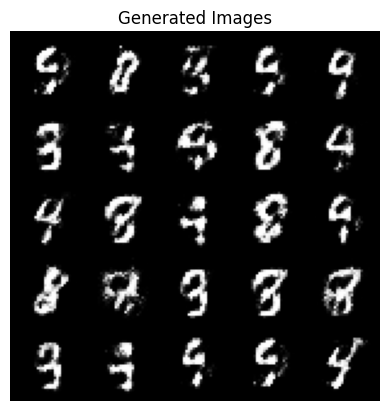

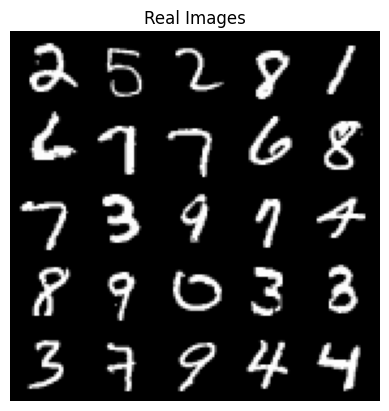

  0%|          | 0/469 [00:00<?, ?it/s]

Step 44500: Generator loss: 2.271236635923385, discriminator loss: 0.2923309872746468


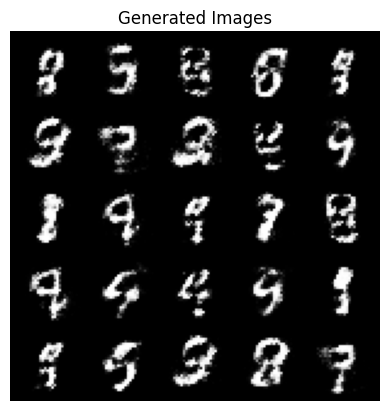

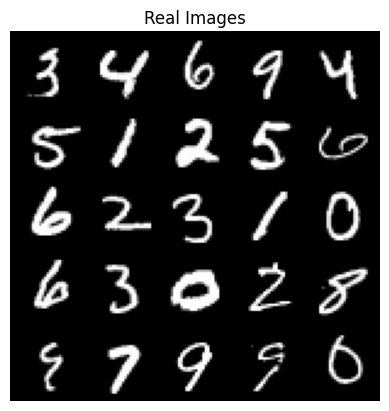

  0%|          | 0/469 [00:00<?, ?it/s]

Step 45000: Generator loss: 2.1285122256278988, discriminator loss: 0.3091330866515632


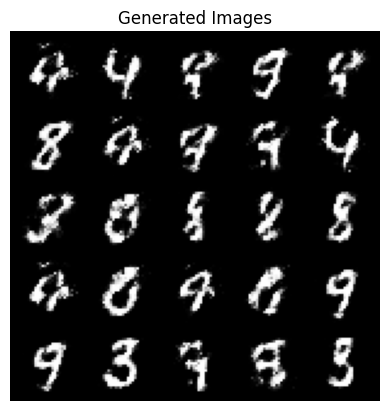

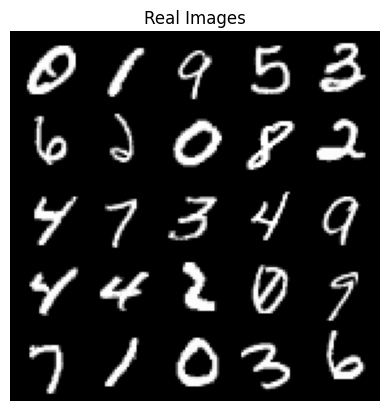

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 45500: Generator loss: 2.1943033270835874, discriminator loss: 0.30689246279001214


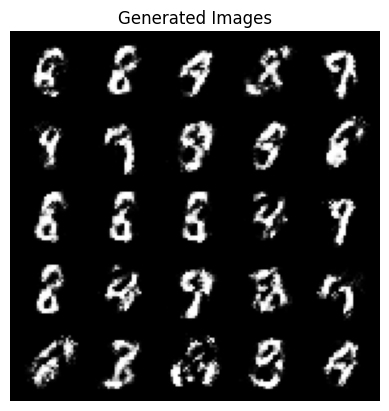

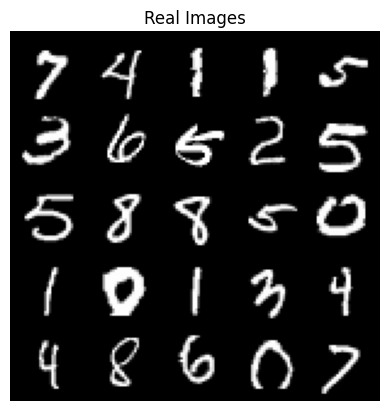

  0%|          | 0/469 [00:00<?, ?it/s]

Step 46000: Generator loss: 2.0623358640670766, discriminator loss: 0.3310044909715653


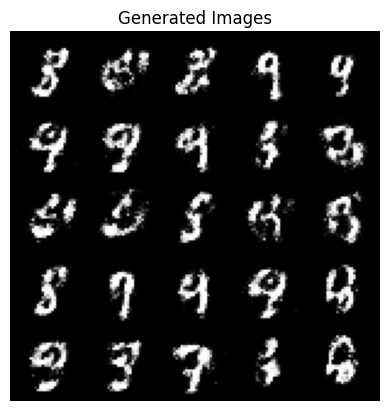

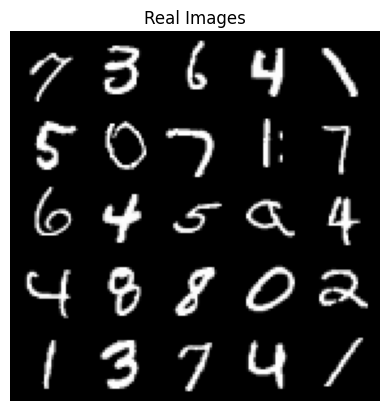

  0%|          | 0/469 [00:00<?, ?it/s]

Step 46500: Generator loss: 2.077185753583907, discriminator loss: 0.31806840816140175


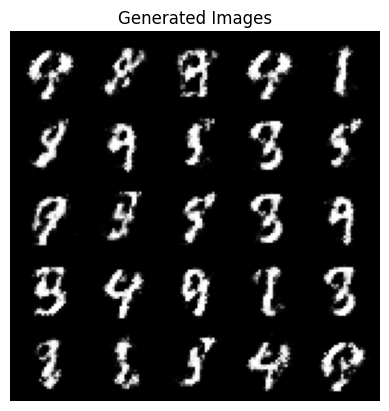

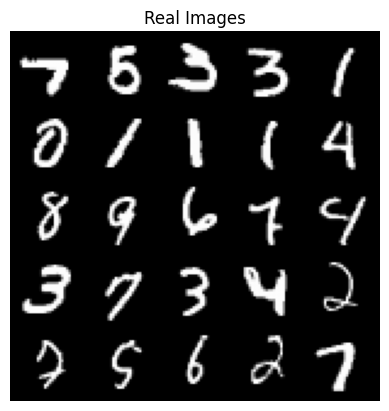

  0%|          | 0/469 [00:00<?, ?it/s]

Step 47000: Generator loss: 2.126329916954038, discriminator loss: 0.29929677811264993


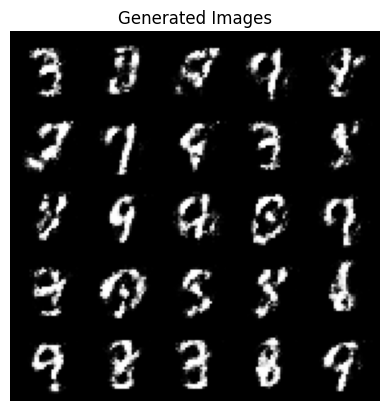

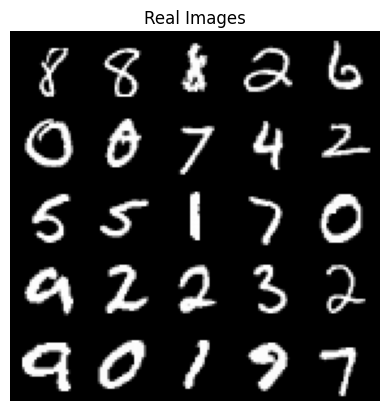

  0%|          | 0/469 [00:00<?, ?it/s]

Step 47500: Generator loss: 2.0233367733955383, discriminator loss: 0.3342296000421045


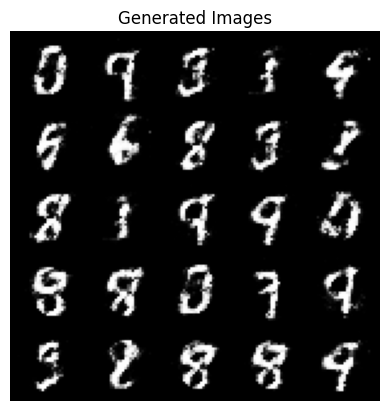

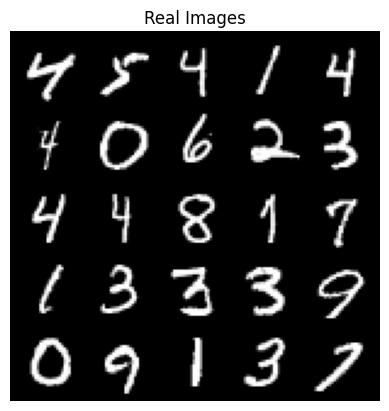

  0%|          | 0/469 [00:00<?, ?it/s]

Step 48000: Generator loss: 1.9841784658432002, discriminator loss: 0.32749492728710144


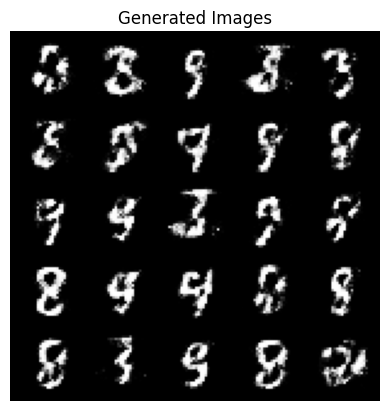

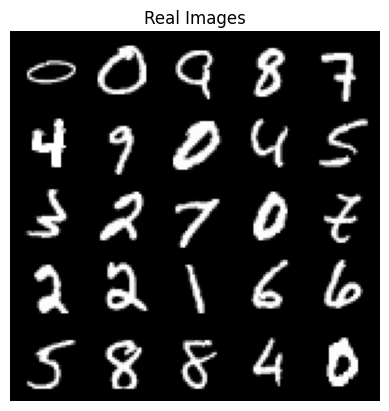

  0%|          | 0/469 [00:00<?, ?it/s]

Step 48500: Generator loss: 2.0334634981155384, discriminator loss: 0.31464872997999177


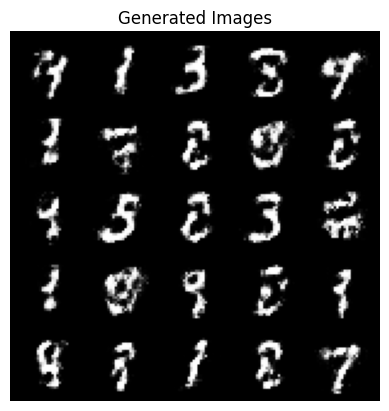

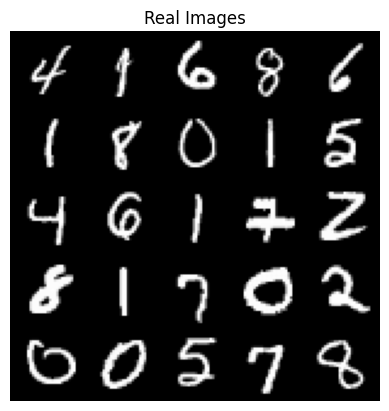

  0%|          | 0/469 [00:00<?, ?it/s]

Step 49000: Generator loss: 2.049546888828276, discriminator loss: 0.300035307198763


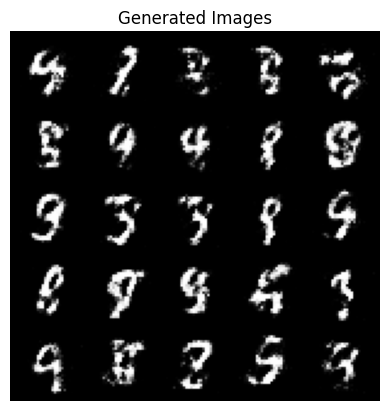

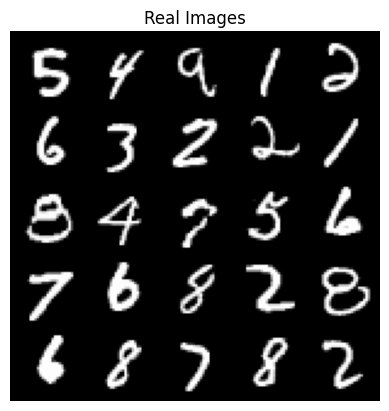

  0%|          | 0/469 [00:00<?, ?it/s]

Step 49500: Generator loss: 2.000871186971663, discriminator loss: 0.3235981320440773


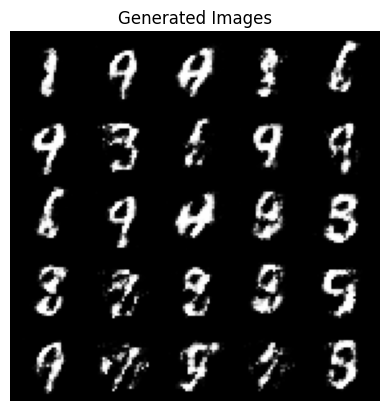

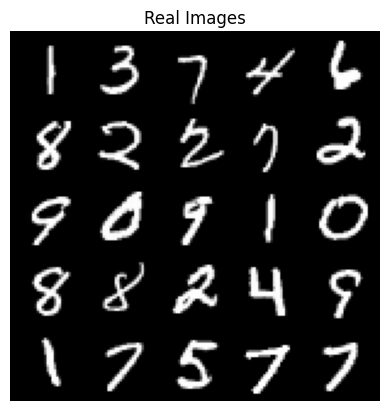

  0%|          | 0/469 [00:00<?, ?it/s]

Step 50000: Generator loss: 1.9351807756423953, discriminator loss: 0.3452628862261771


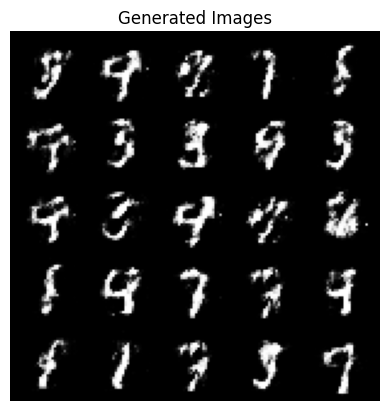

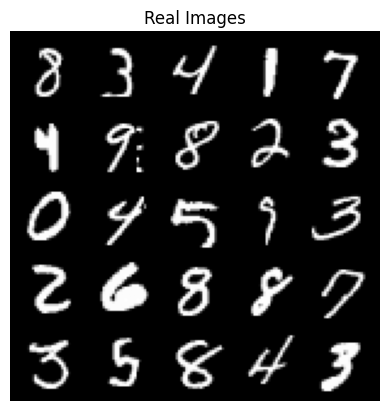

  0%|          | 0/469 [00:00<?, ?it/s]

Step 50500: Generator loss: 1.933013875961304, discriminator loss: 0.34158041089773156


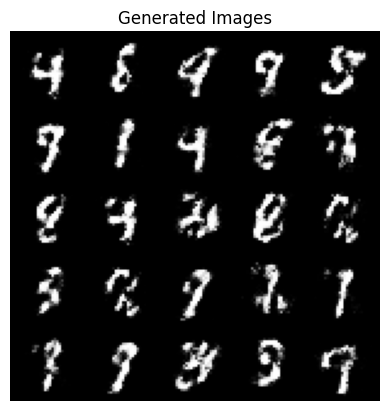

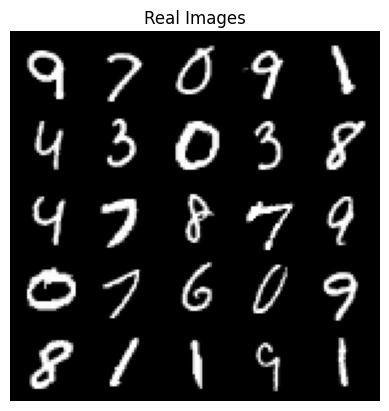

  0%|          | 0/469 [00:00<?, ?it/s]

Step 51000: Generator loss: 1.9416287138462074, discriminator loss: 0.33715452235937077


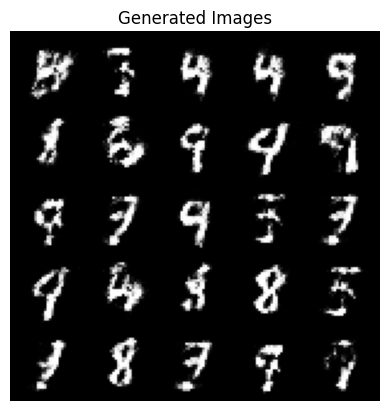

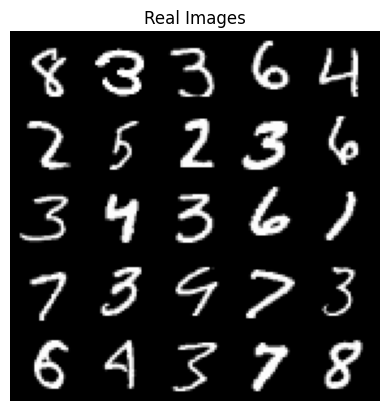

  0%|          | 0/469 [00:00<?, ?it/s]

Step 51500: Generator loss: 1.9133944737911224, discriminator loss: 0.33169733232259774


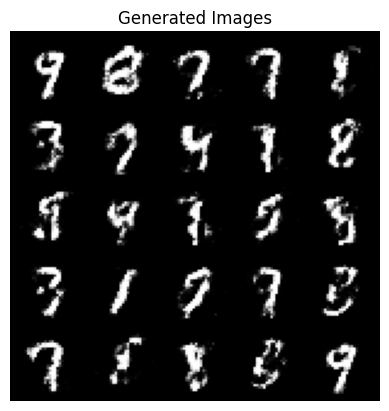

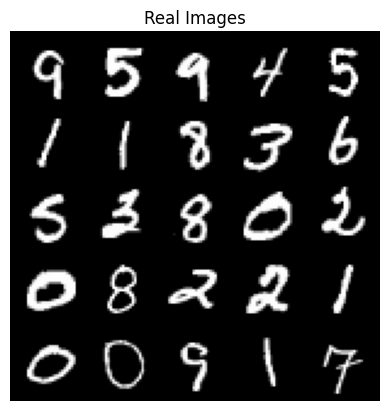

  0%|          | 0/469 [00:00<?, ?it/s]

Step 52000: Generator loss: 1.929903237104417, discriminator loss: 0.3368085608780386


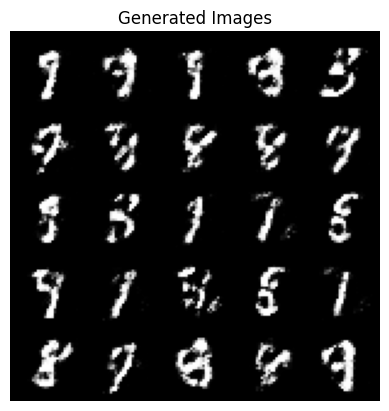

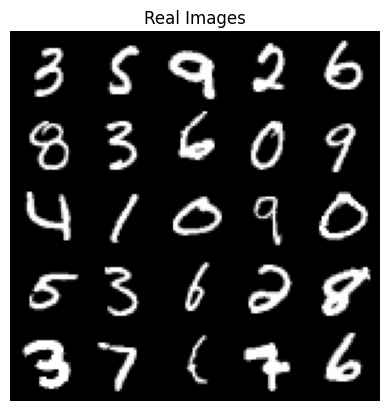

  0%|          | 0/469 [00:00<?, ?it/s]

Step 52500: Generator loss: 1.8888575794696818, discriminator loss: 0.34707438191771534


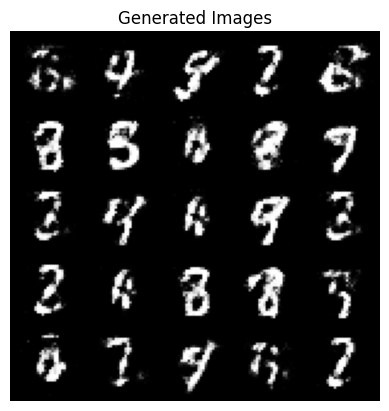

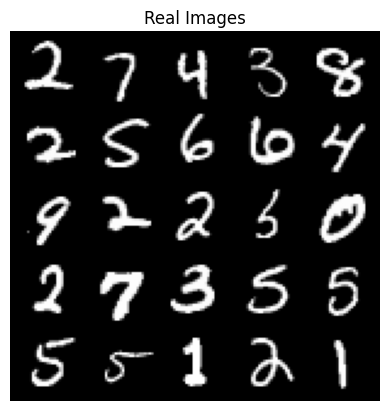

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 53000: Generator loss: 1.830587961912155, discriminator loss: 0.3568845850229264


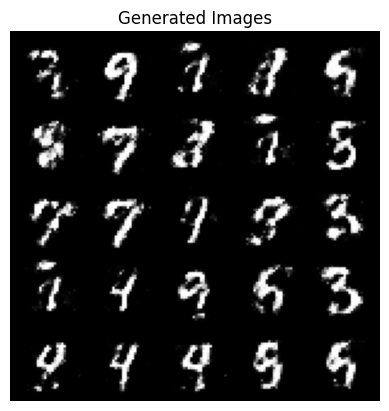

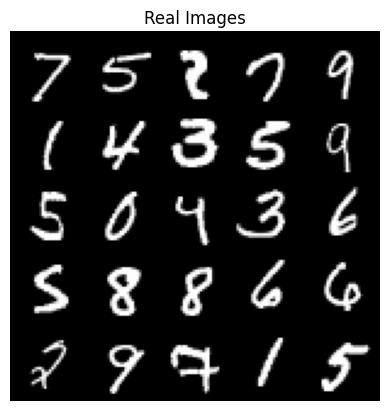

  0%|          | 0/469 [00:00<?, ?it/s]

Step 53500: Generator loss: 1.9310389502048513, discriminator loss: 0.32054938486218426


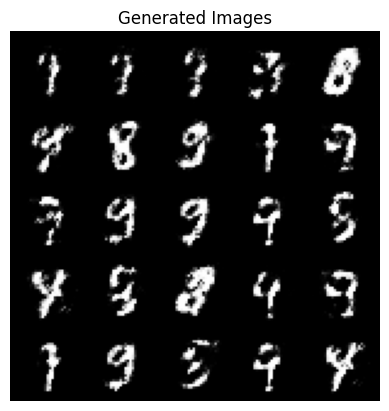

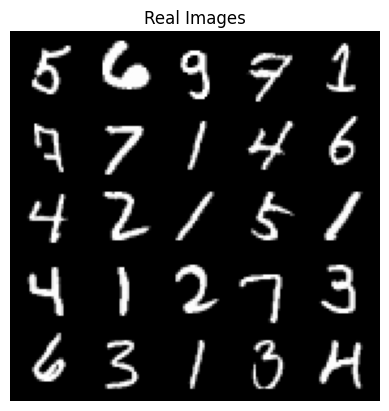

  0%|          | 0/469 [00:00<?, ?it/s]

Step 54000: Generator loss: 1.883153379440307, discriminator loss: 0.34688343000411964


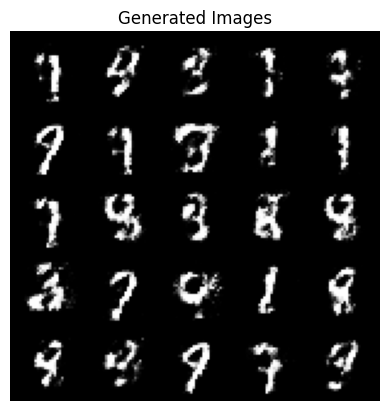

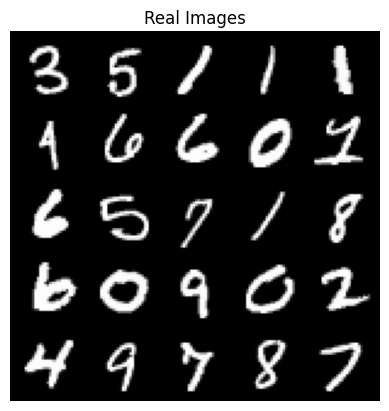

  0%|          | 0/469 [00:00<?, ?it/s]

Step 54500: Generator loss: 1.8719459865093226, discriminator loss: 0.3716719758510589


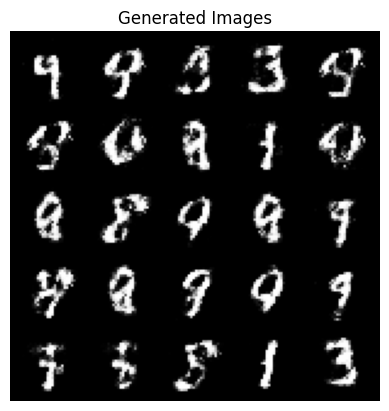

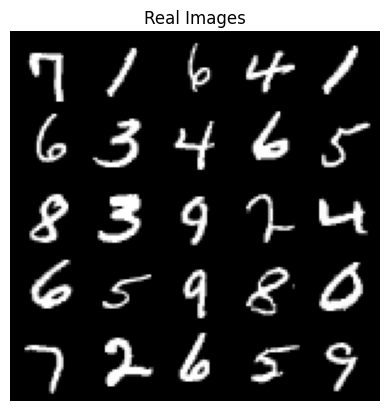

  0%|          | 0/469 [00:00<?, ?it/s]

Step 55000: Generator loss: 1.8299444773197178, discriminator loss: 0.36070330703258524


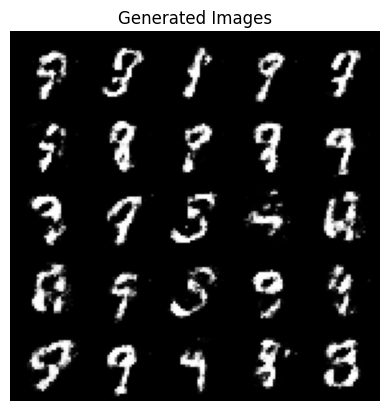

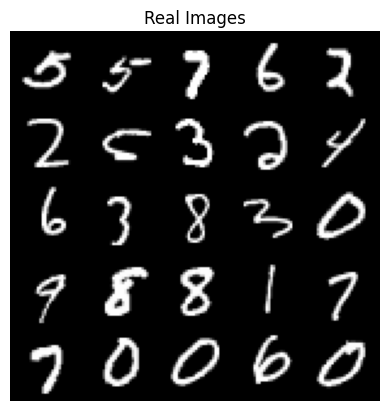

  0%|          | 0/469 [00:00<?, ?it/s]

Step 55500: Generator loss: 1.8827406432628642, discriminator loss: 0.33331951248645814


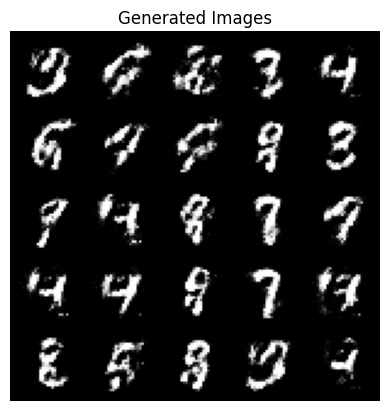

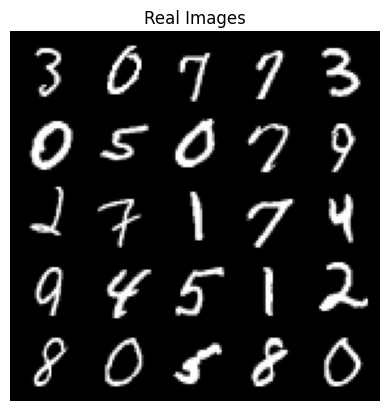

  0%|          | 0/469 [00:00<?, ?it/s]

Step 56000: Generator loss: 1.9778091068267798, discriminator loss: 0.3202875884175301


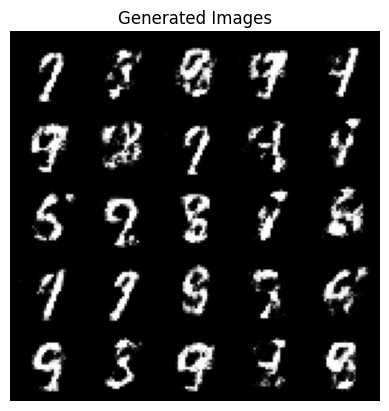

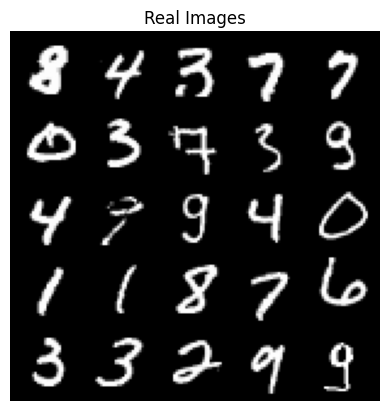

  0%|          | 0/469 [00:00<?, ?it/s]

Step 56500: Generator loss: 1.9993482758998882, discriminator loss: 0.3112257697284225


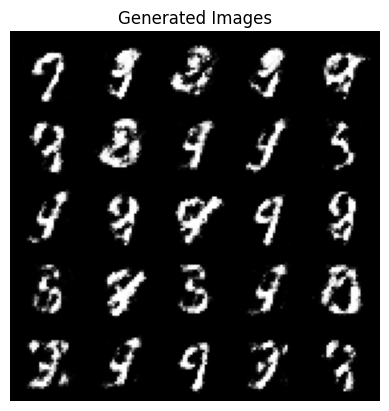

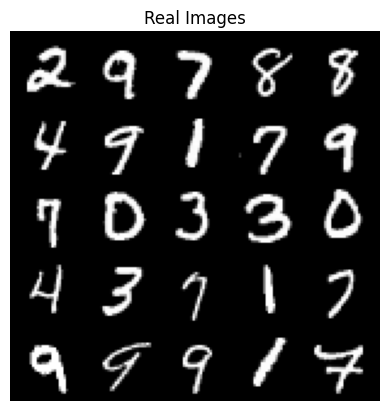

  0%|          | 0/469 [00:00<?, ?it/s]

Step 57000: Generator loss: 1.8297888748645805, discriminator loss: 0.35911828362941767


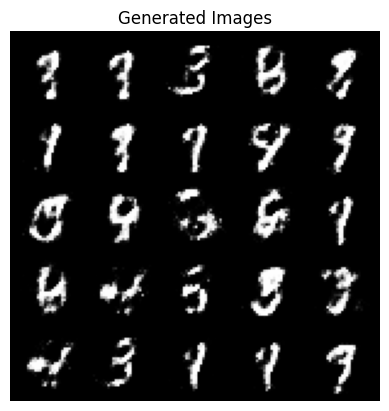

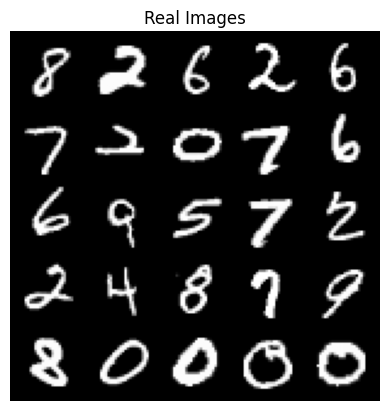

  0%|          | 0/469 [00:00<?, ?it/s]

Step 57500: Generator loss: 1.9161555206775673, discriminator loss: 0.3222871601879598


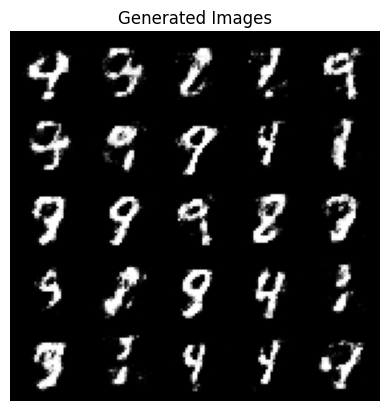

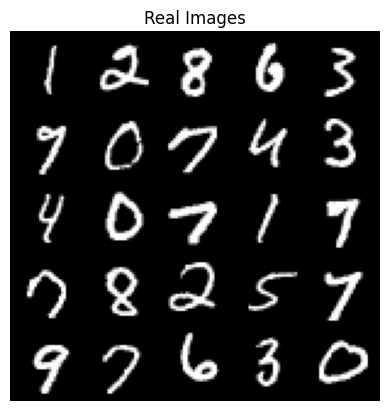

  0%|          | 0/469 [00:00<?, ?it/s]

Step 58000: Generator loss: 1.8958117454051986, discriminator loss: 0.3379468401074408


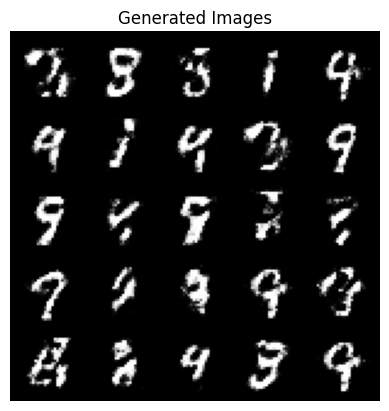

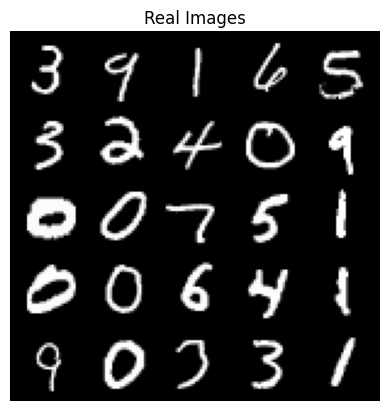

  0%|          | 0/469 [00:00<?, ?it/s]

Step 58500: Generator loss: 1.7798697082996378, discriminator loss: 0.36408778953552173


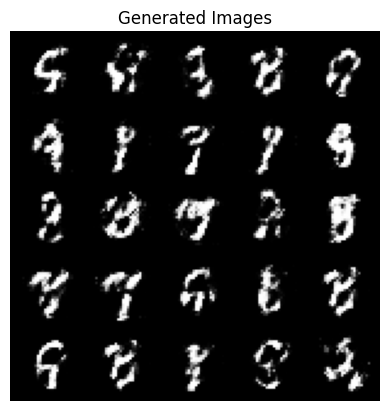

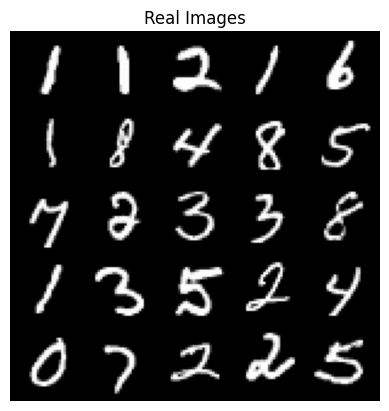

  0%|          | 0/469 [00:00<?, ?it/s]

Step 59000: Generator loss: 1.8775911271572112, discriminator loss: 0.3388110454082489


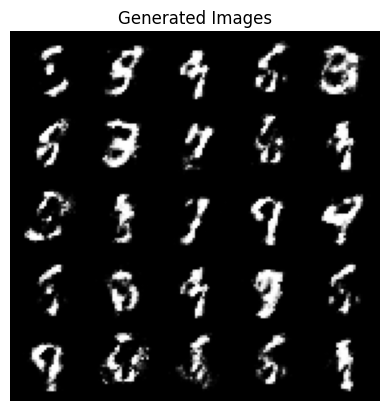

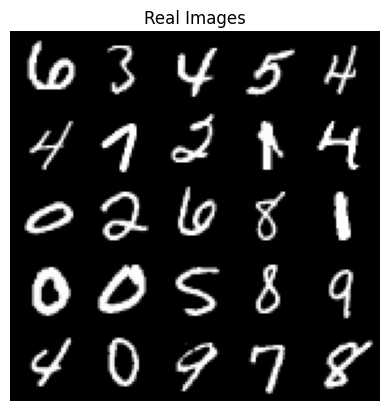

  0%|          | 0/469 [00:00<?, ?it/s]

Step 59500: Generator loss: 1.8262901389598858, discriminator loss: 0.36225114667415625


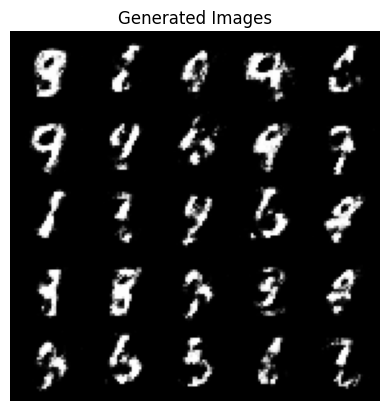

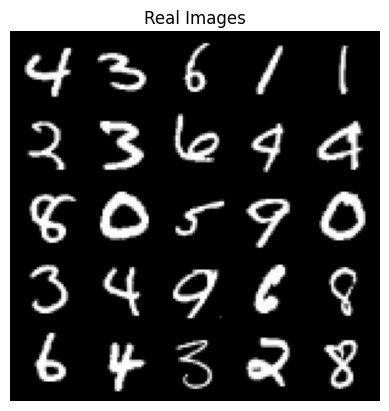

  0%|          | 0/469 [00:00<?, ?it/s]

Step 60000: Generator loss: 1.7810871167182925, discriminator loss: 0.3586109016239643


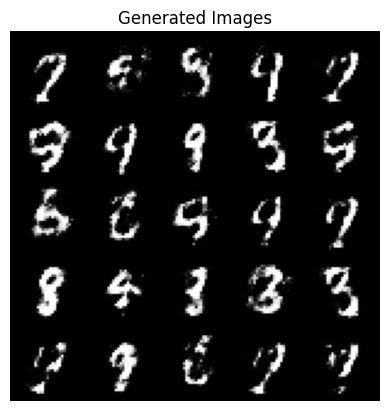

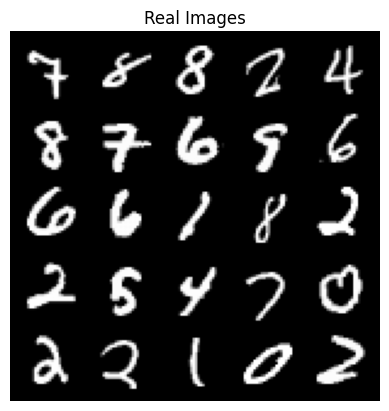

  0%|          | 0/469 [00:00<?, ?it/s]

Step 60500: Generator loss: 1.8138957896232617, discriminator loss: 0.36114129006862616


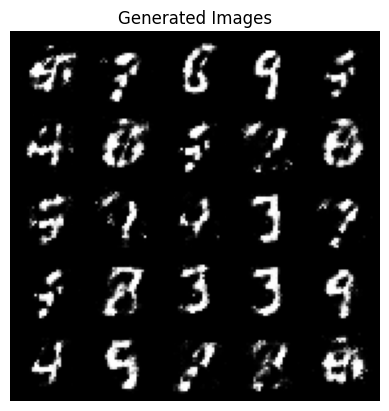

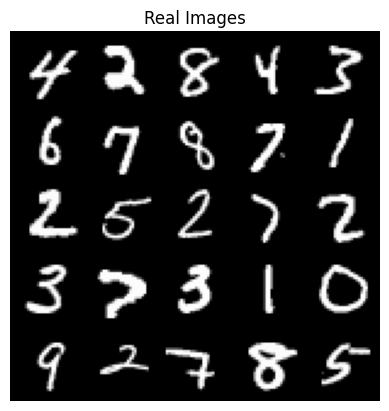

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 61000: Generator loss: 1.8012817537784598, discriminator loss: 0.3768263207376004


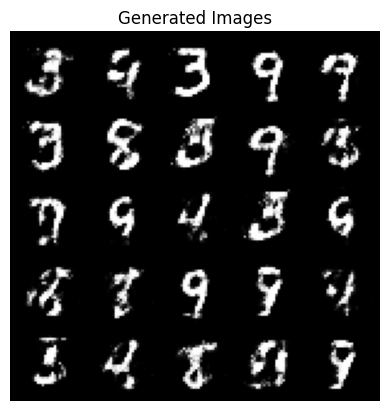

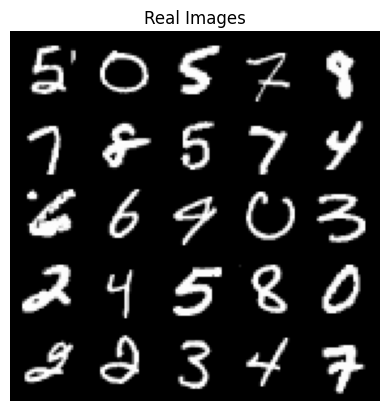

  0%|          | 0/469 [00:00<?, ?it/s]

Step 61500: Generator loss: 1.7333796825408938, discriminator loss: 0.37780568867921827


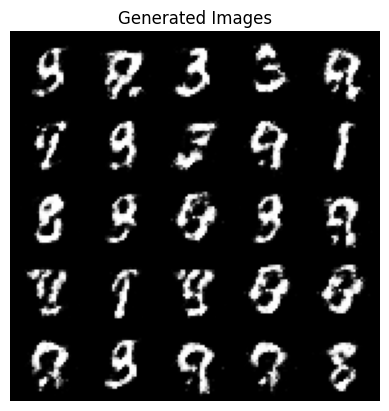

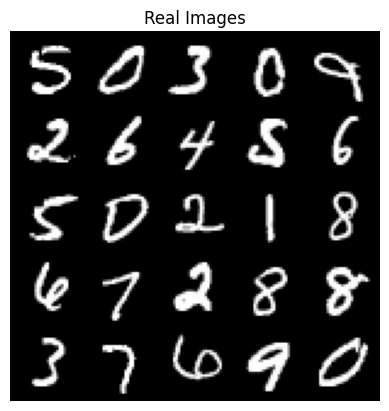

  0%|          | 0/469 [00:00<?, ?it/s]

Step 62000: Generator loss: 1.8543281750679028, discriminator loss: 0.34602180460095383


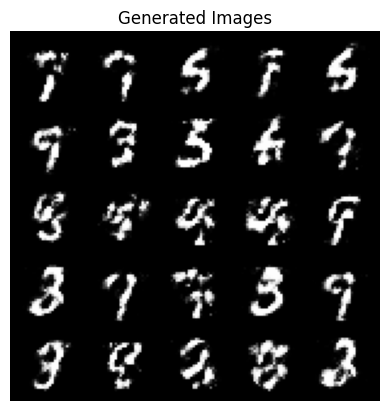

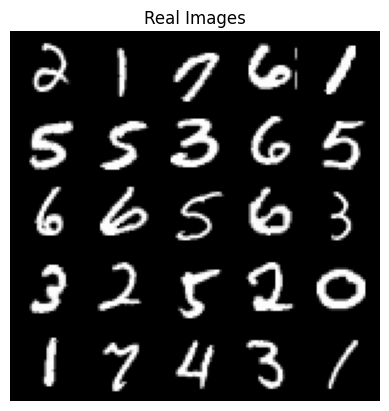

  0%|          | 0/469 [00:00<?, ?it/s]

Step 62500: Generator loss: 1.7977038054466232, discriminator loss: 0.3562948718667028


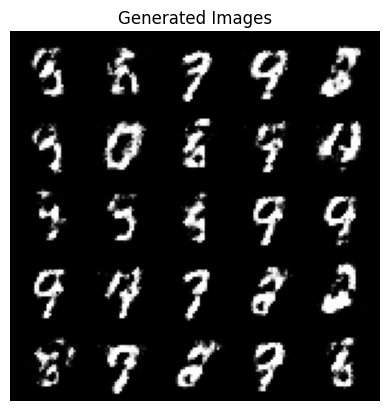

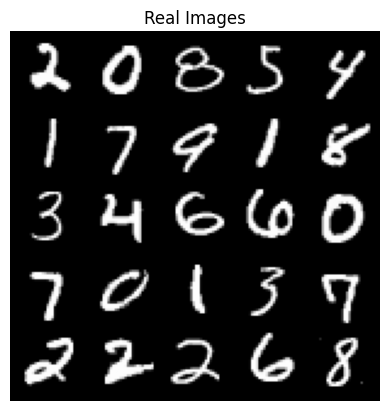

  0%|          | 0/469 [00:00<?, ?it/s]

Step 63000: Generator loss: 1.7742445058822636, discriminator loss: 0.36484909784793884


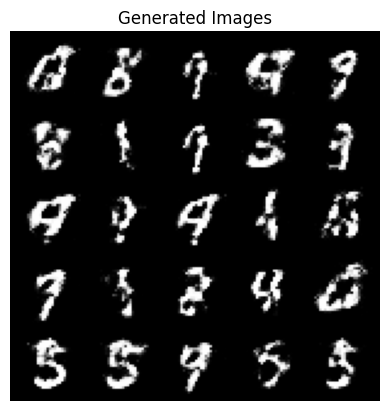

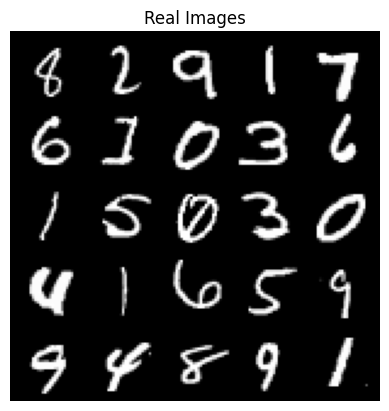

  0%|          | 0/469 [00:00<?, ?it/s]

Step 63500: Generator loss: 1.7478000130653382, discriminator loss: 0.3707278738617895


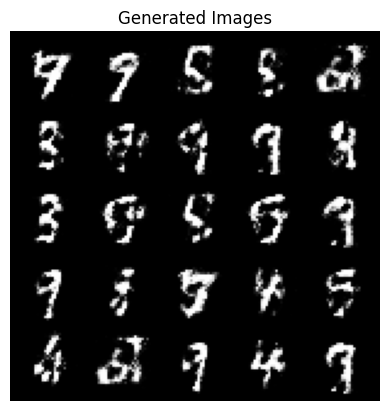

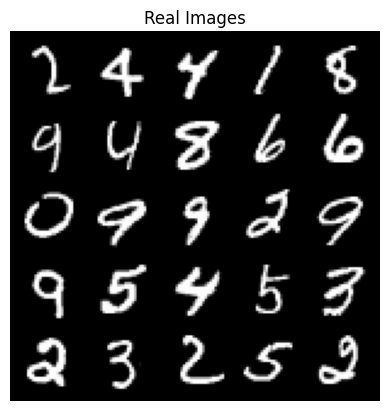

  0%|          | 0/469 [00:00<?, ?it/s]

Step 64000: Generator loss: 1.6931621921062459, discriminator loss: 0.38653280192613587


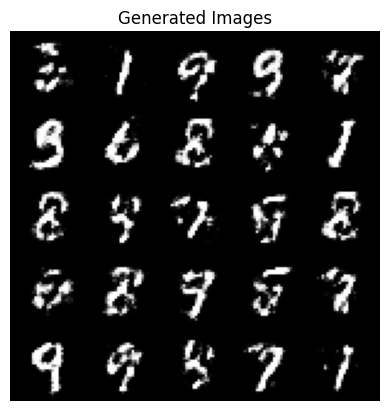

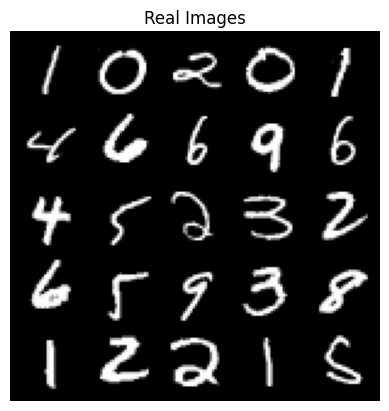

  0%|          | 0/469 [00:00<?, ?it/s]

Step 64500: Generator loss: 1.7035871264934546, discriminator loss: 0.3746507889032367


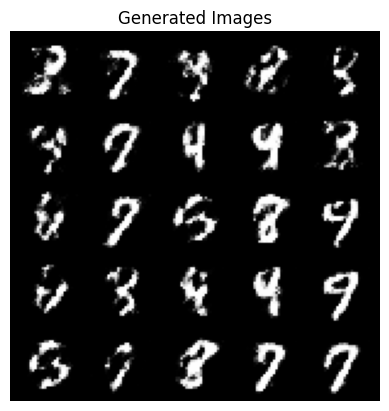

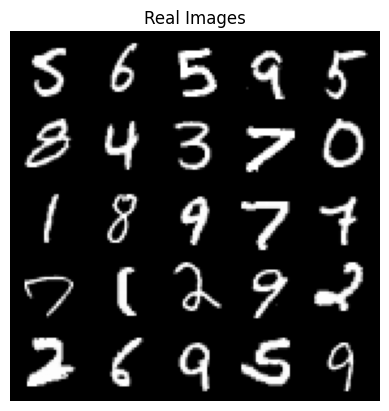

  0%|          | 0/469 [00:00<?, ?it/s]

Step 65000: Generator loss: 1.6920179455280304, discriminator loss: 0.3786456413269046


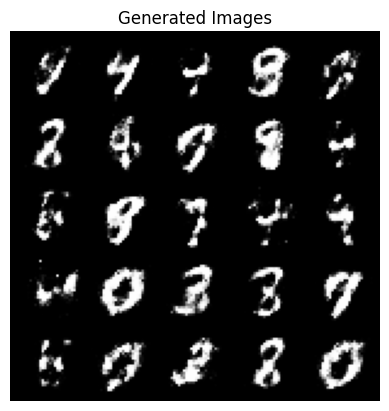

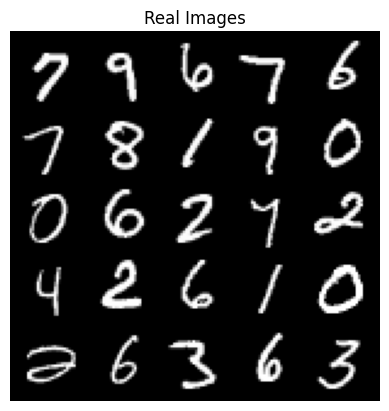

  0%|          | 0/469 [00:00<?, ?it/s]

Step 65500: Generator loss: 1.6870883870124822, discriminator loss: 0.3817001012563705


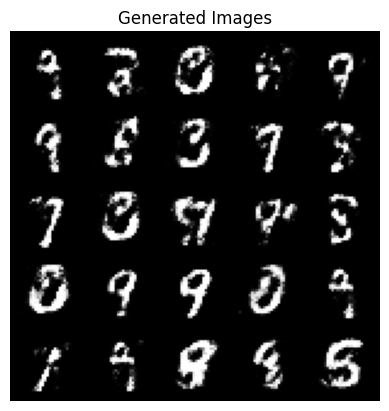

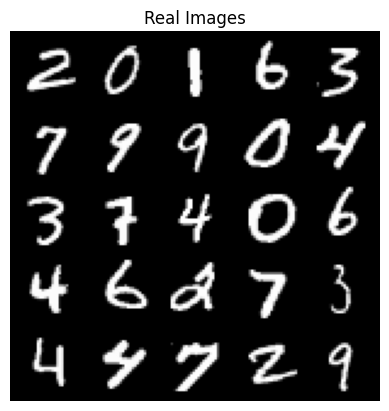

  0%|          | 0/469 [00:00<?, ?it/s]

Step 66000: Generator loss: 1.689940799951552, discriminator loss: 0.3773949521780012


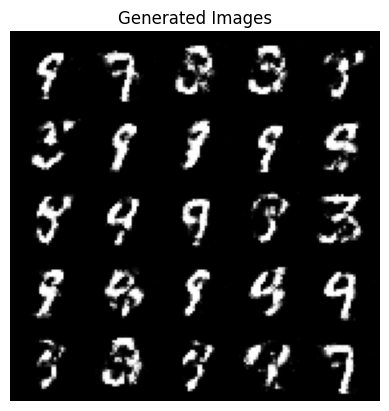

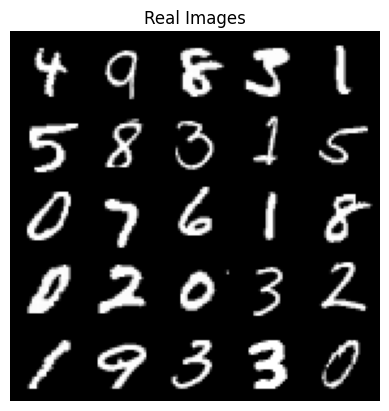

  0%|          | 0/469 [00:00<?, ?it/s]

Step 66500: Generator loss: 1.7287261579036703, discriminator loss: 0.3830808281898499


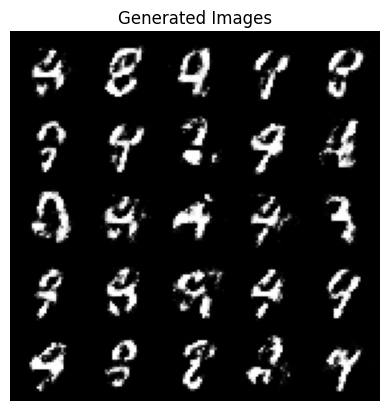

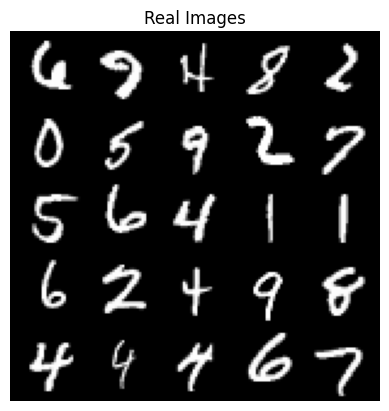

  0%|          | 0/469 [00:00<?, ?it/s]

Step 67000: Generator loss: 1.695084678888322, discriminator loss: 0.3882256092429158


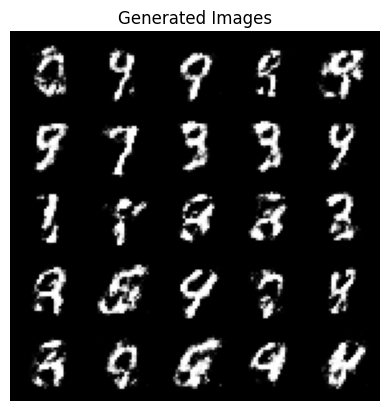

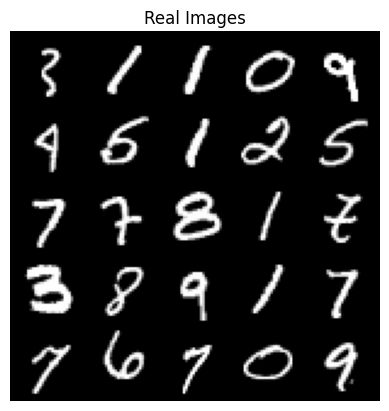

  0%|          | 0/469 [00:00<?, ?it/s]

Step 67500: Generator loss: 1.6857791397571569, discriminator loss: 0.3815638035535812


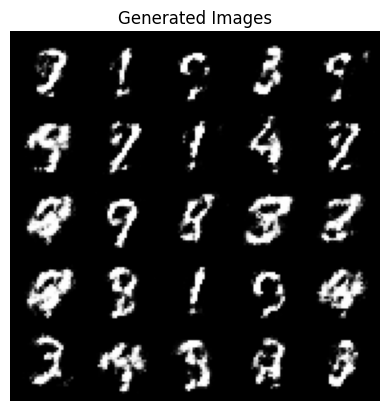

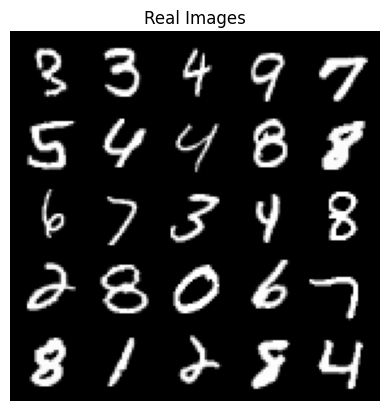

  0%|          | 0/469 [00:00<?, ?it/s]

Step 68000: Generator loss: 1.6766206820011136, discriminator loss: 0.39095600438118006


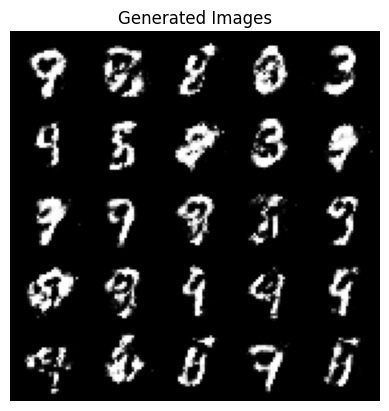

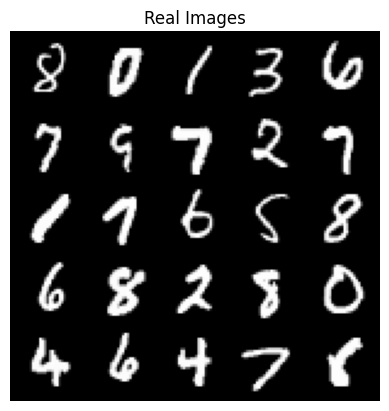

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 68500: Generator loss: 1.6273530747890477, discriminator loss: 0.39529488235712057


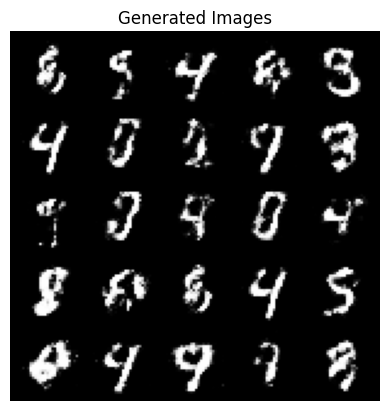

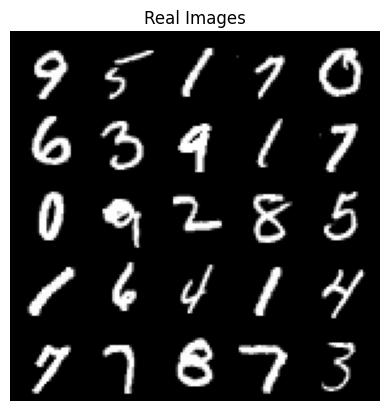

  0%|          | 0/469 [00:00<?, ?it/s]

Step 69000: Generator loss: 1.6204746303558364, discriminator loss: 0.380751961648464


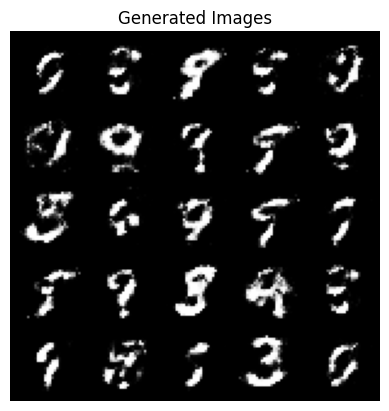

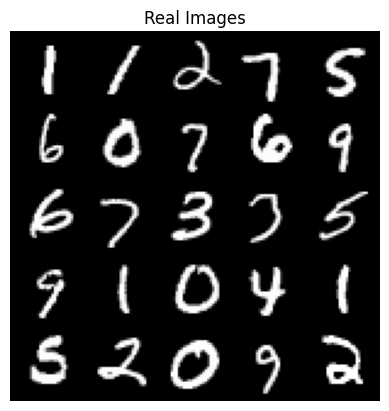

  0%|          | 0/469 [00:00<?, ?it/s]

Step 69500: Generator loss: 1.6724855015277853, discriminator loss: 0.3798104538321502


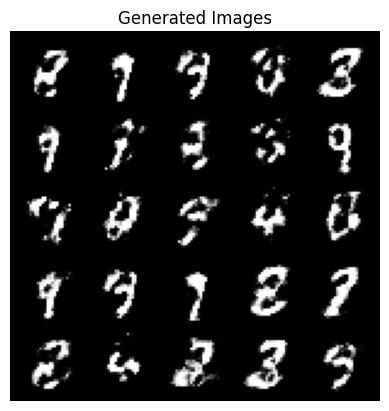

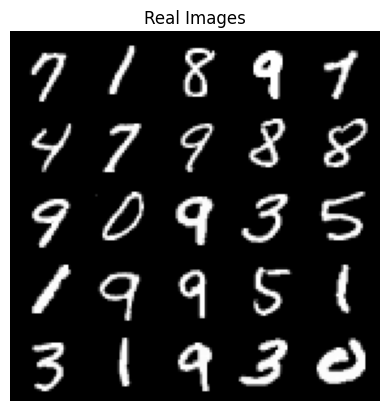

  0%|          | 0/469 [00:00<?, ?it/s]

Step 70000: Generator loss: 1.725337837696075, discriminator loss: 0.3699813508391374


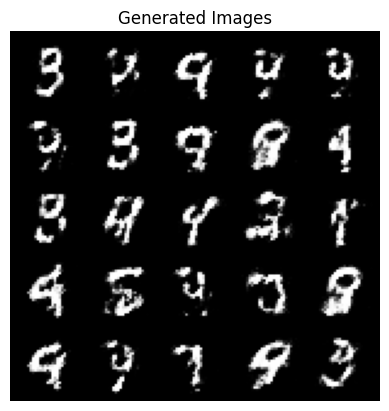

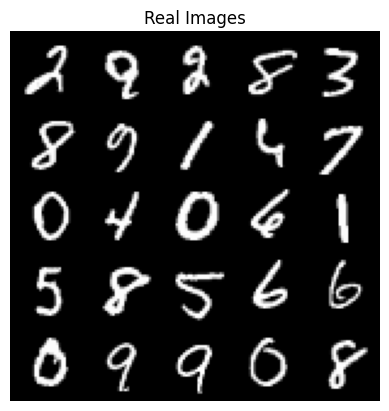

  0%|          | 0/469 [00:00<?, ?it/s]

Step 70500: Generator loss: 1.742773338317872, discriminator loss: 0.35945697546005234


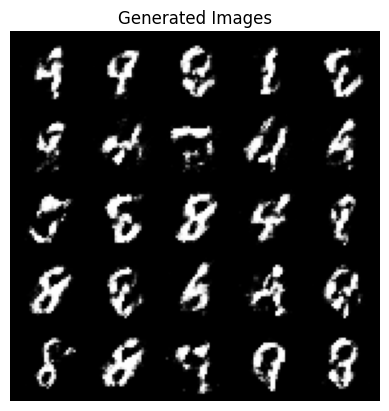

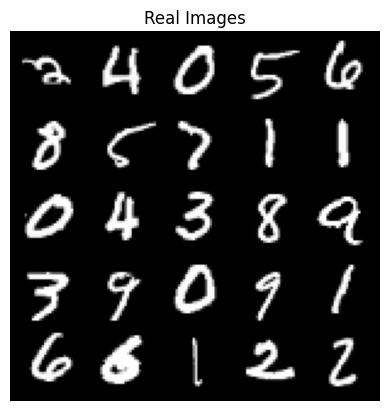

  0%|          | 0/469 [00:00<?, ?it/s]

Step 71000: Generator loss: 1.6539593951702125, discriminator loss: 0.3901237221956252


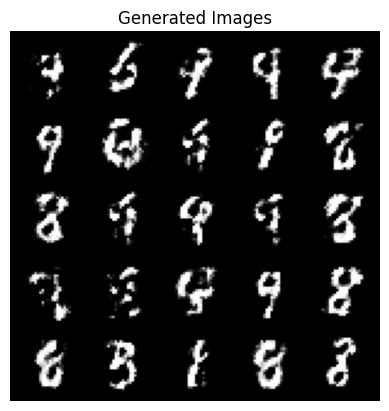

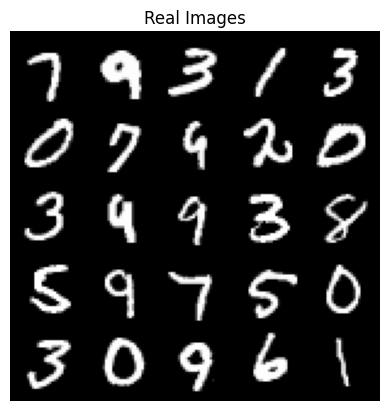

  0%|          | 0/469 [00:00<?, ?it/s]

Step 71500: Generator loss: 1.6318057570457478, discriminator loss: 0.39732369500398595


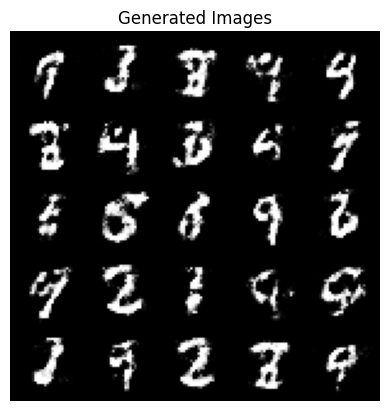

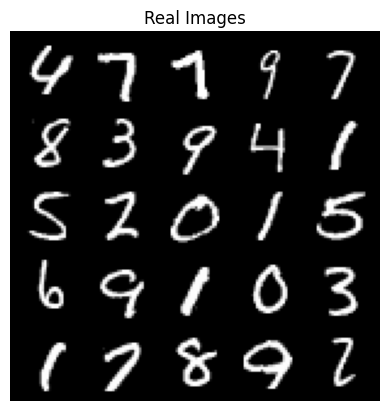

  0%|          | 0/469 [00:00<?, ?it/s]

Step 72000: Generator loss: 1.5705088260173794, discriminator loss: 0.4154025324583057


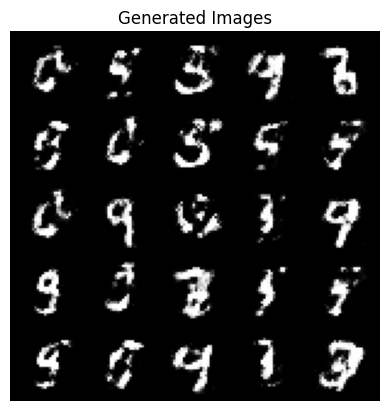

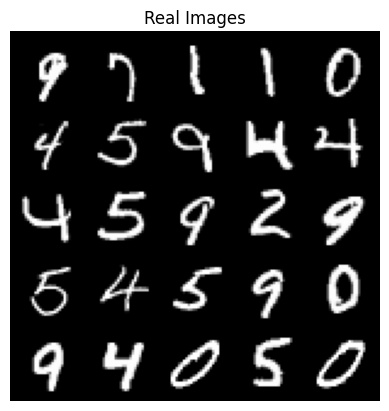

  0%|          | 0/469 [00:00<?, ?it/s]

Step 72500: Generator loss: 1.5696565535068512, discriminator loss: 0.40250891172885894


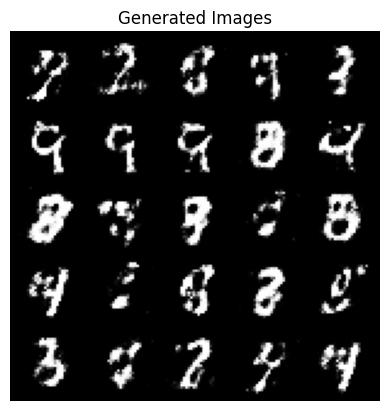

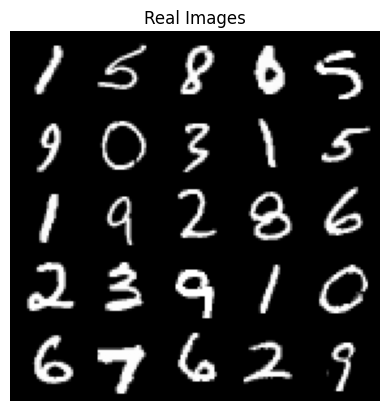

  0%|          | 0/469 [00:00<?, ?it/s]

Step 73000: Generator loss: 1.577250737905501, discriminator loss: 0.4101288235187532


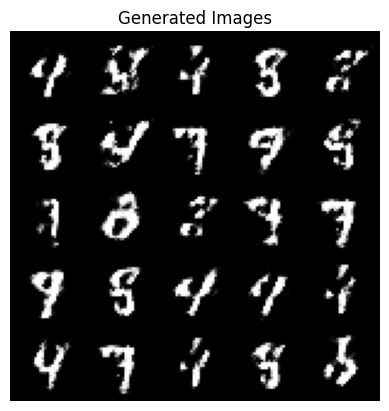

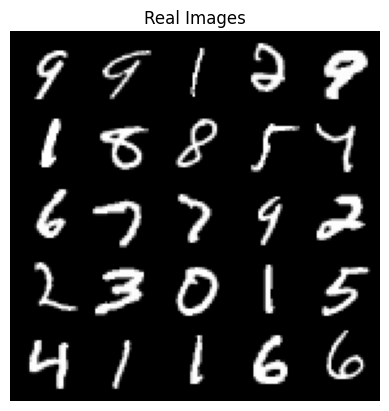

  0%|          | 0/469 [00:00<?, ?it/s]

Step 73500: Generator loss: 1.5175655446052565, discriminator loss: 0.41465988212823907


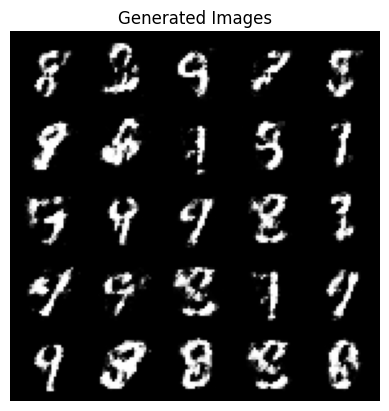

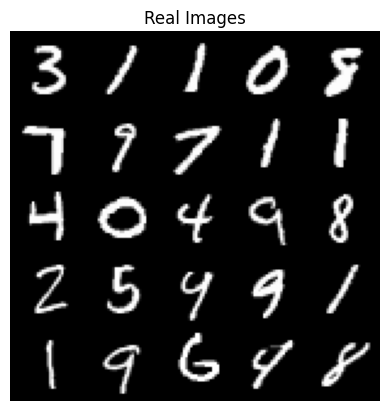

  0%|          | 0/469 [00:00<?, ?it/s]

Step 74000: Generator loss: 1.5387678003311163, discriminator loss: 0.42412801891565316


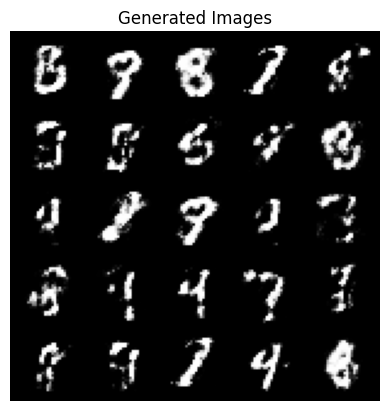

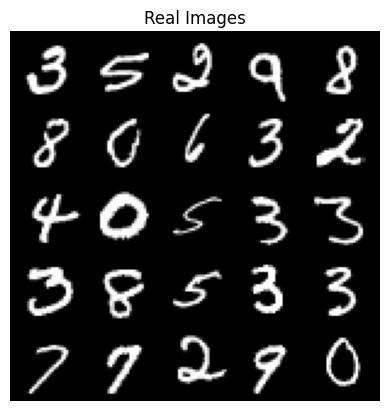

  0%|          | 0/469 [00:00<?, ?it/s]

Step 74500: Generator loss: 1.4585347180366512, discriminator loss: 0.4358245049118998


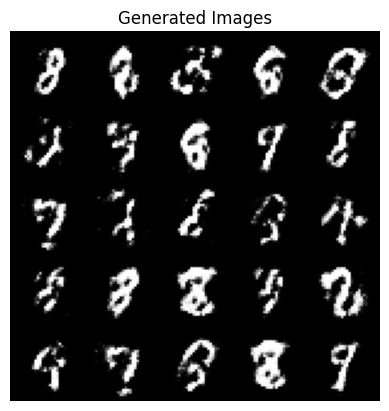

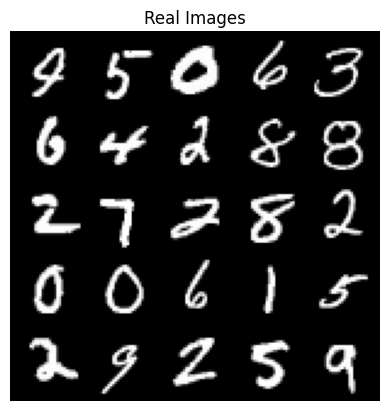

  0%|          | 0/469 [00:00<?, ?it/s]

Step 75000: Generator loss: 1.4622321674823768, discriminator loss: 0.43681339246034606


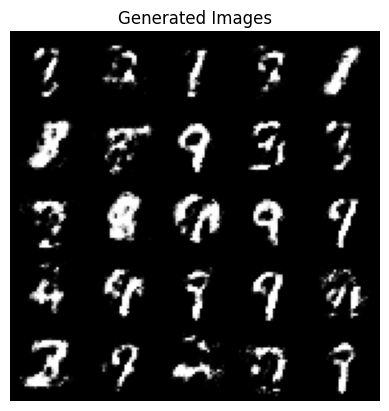

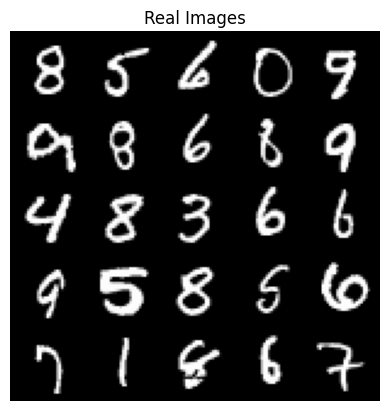

  0%|          | 0/469 [00:00<?, ?it/s]

Step 75500: Generator loss: 1.5019442834854118, discriminator loss: 0.41767446362972216


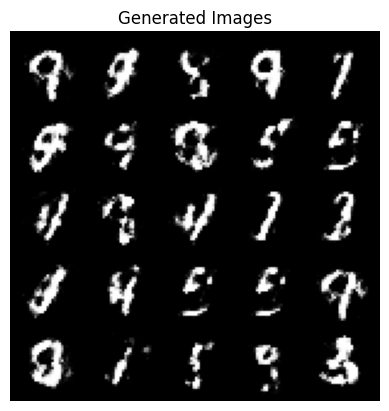

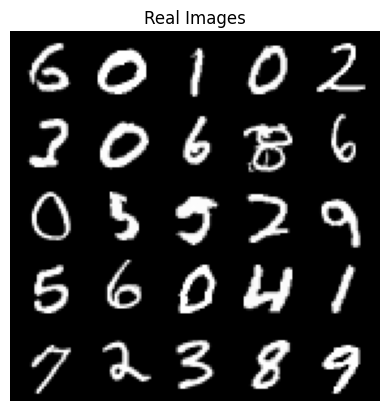

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 76000: Generator loss: 1.533008641242981, discriminator loss: 0.4164346147179605


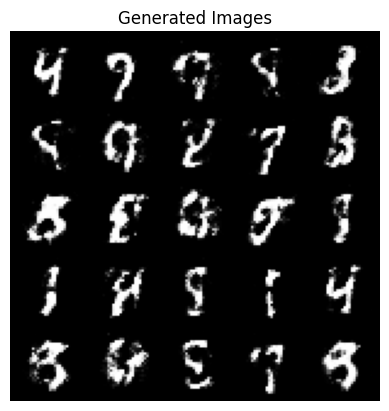

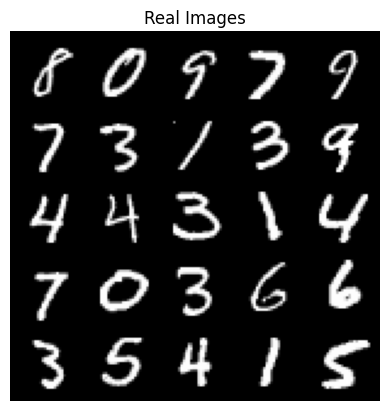

  0%|          | 0/469 [00:00<?, ?it/s]

Step 76500: Generator loss: 1.511178563594818, discriminator loss: 0.42747361594438543


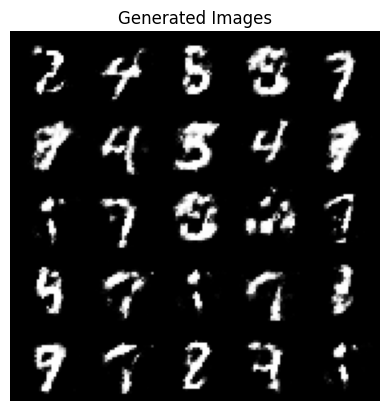

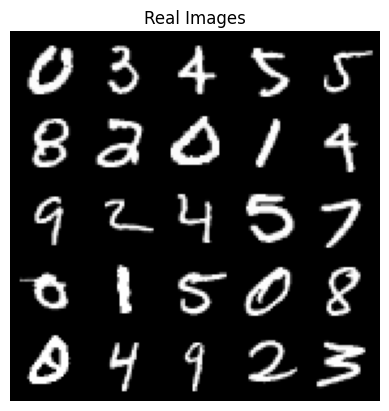

  0%|          | 0/469 [00:00<?, ?it/s]

Step 77000: Generator loss: 1.5179333331584939, discriminator loss: 0.41413593077659644


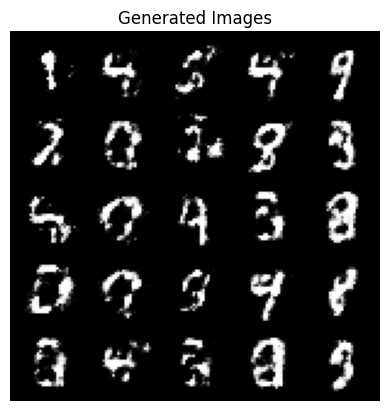

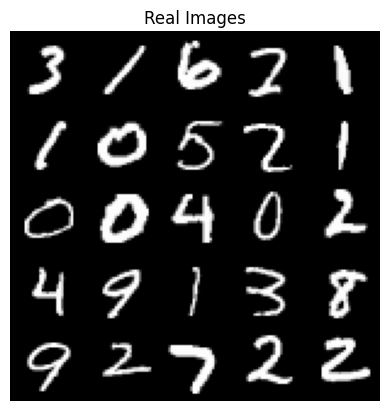

  0%|          | 0/469 [00:00<?, ?it/s]

Step 77500: Generator loss: 1.4965228471755994, discriminator loss: 0.4354576227068899


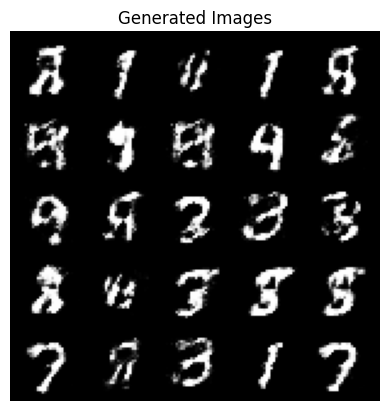

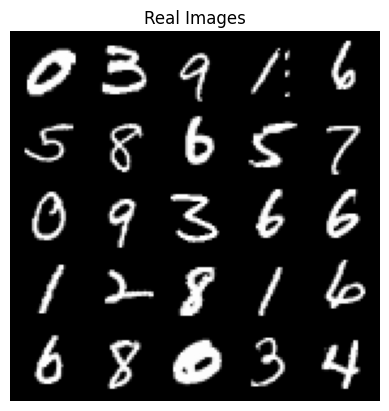

  0%|          | 0/469 [00:00<?, ?it/s]

Step 78000: Generator loss: 1.408521289110183, discriminator loss: 0.45980495733022686


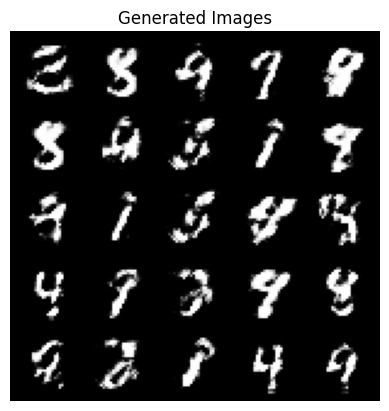

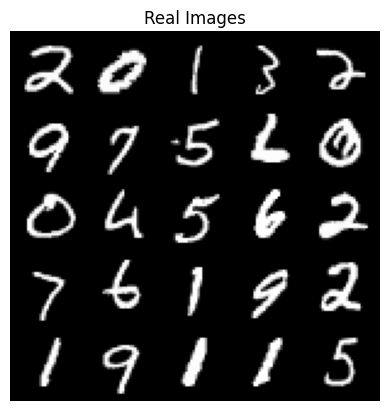

  0%|          | 0/469 [00:00<?, ?it/s]

Step 78500: Generator loss: 1.4222733879089349, discriminator loss: 0.44530775588750815


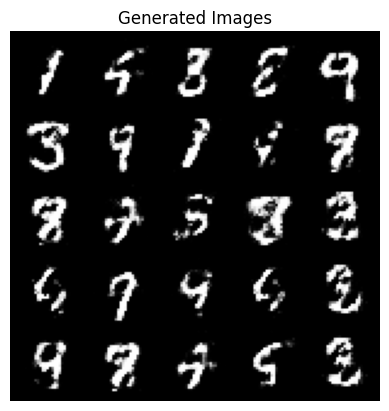

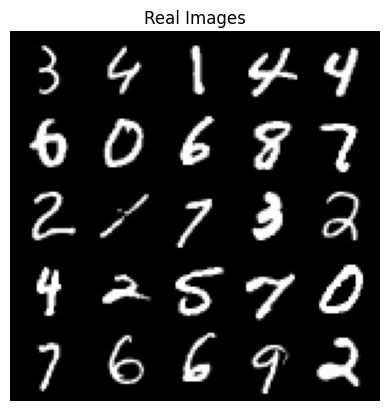

  0%|          | 0/469 [00:00<?, ?it/s]

Step 79000: Generator loss: 1.4803624873161327, discriminator loss: 0.4350404690504072


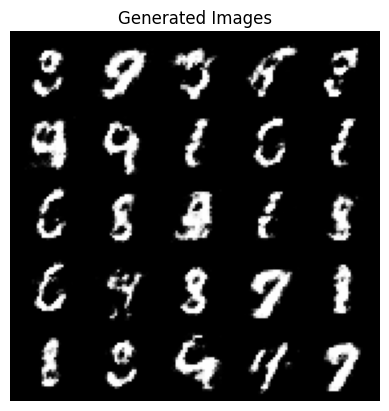

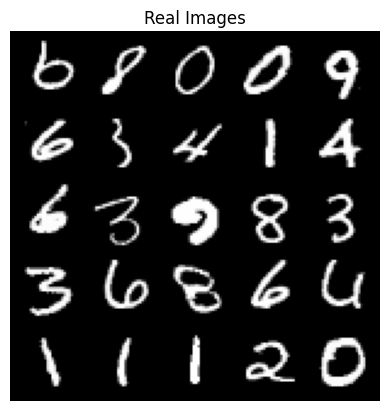

  0%|          | 0/469 [00:00<?, ?it/s]

Step 79500: Generator loss: 1.4794183940887444, discriminator loss: 0.42531999444961577


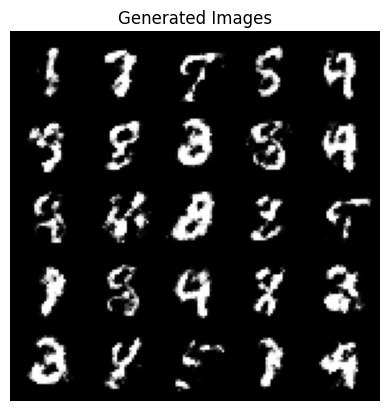

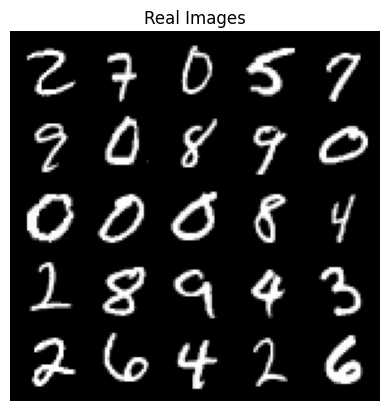

  0%|          | 0/469 [00:00<?, ?it/s]

Step 80000: Generator loss: 1.4192842736244213, discriminator loss: 0.43461466383934017


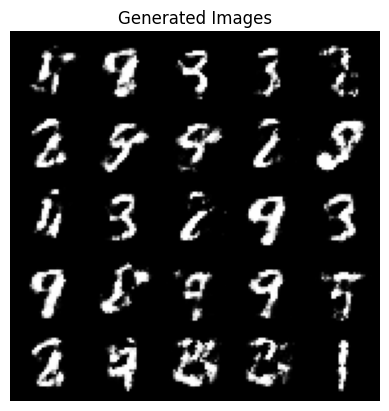

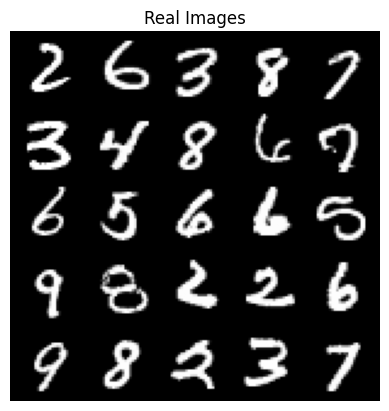

  0%|          | 0/469 [00:00<?, ?it/s]

Step 80500: Generator loss: 1.4910810463428488, discriminator loss: 0.4212386831641197


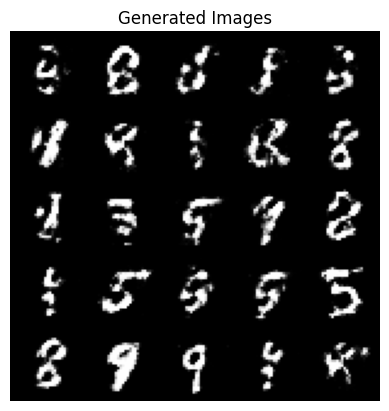

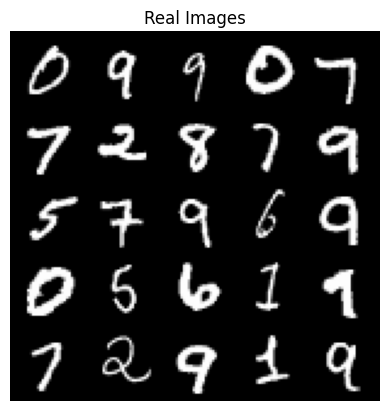

  0%|          | 0/469 [00:00<?, ?it/s]

Step 81000: Generator loss: 1.4663720979690547, discriminator loss: 0.4307350783348083


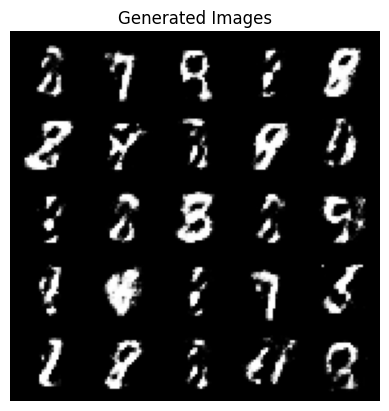

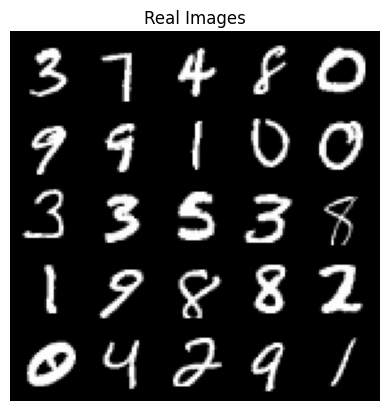

  0%|          | 0/469 [00:00<?, ?it/s]

Step 81500: Generator loss: 1.5220729706287384, discriminator loss: 0.4099890920519827


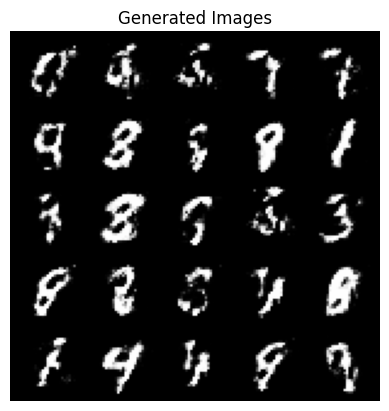

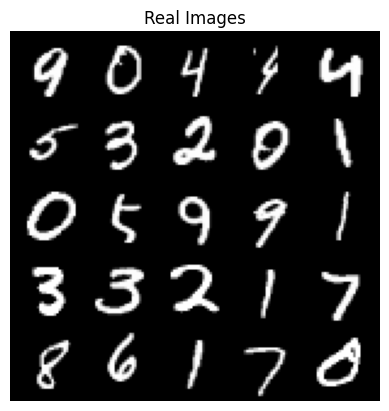

  0%|          | 0/469 [00:00<?, ?it/s]

Step 82000: Generator loss: 1.463448987722396, discriminator loss: 0.4397374534010884


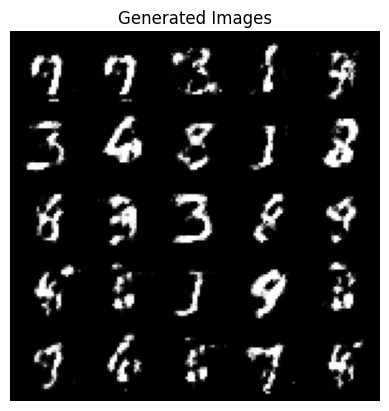

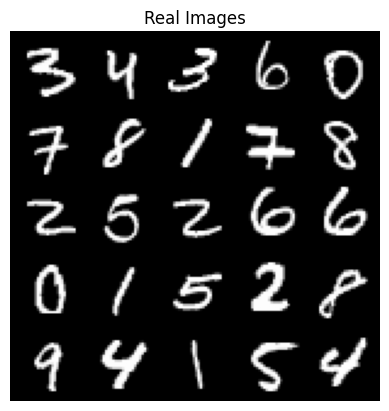

  0%|          | 0/469 [00:00<?, ?it/s]

Step 82500: Generator loss: 1.5300904443264005, discriminator loss: 0.4121212608814239


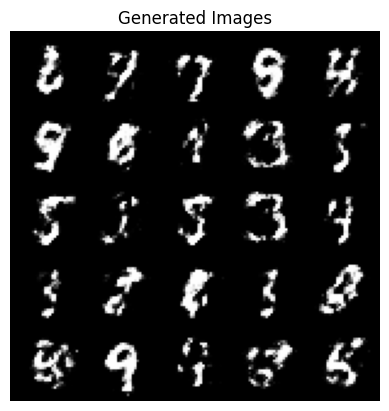

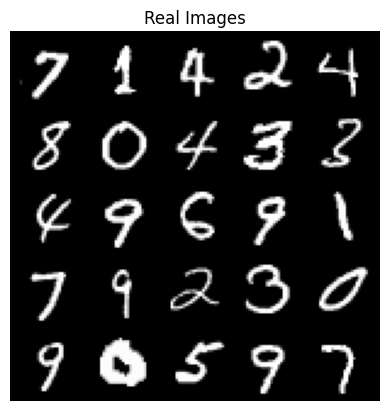

  0%|          | 0/469 [00:00<?, ?it/s]

Step 83000: Generator loss: 1.4316205089092282, discriminator loss: 0.44747722190618533


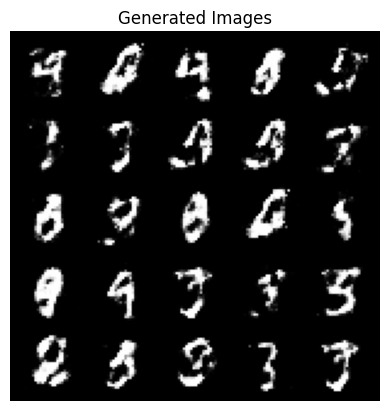

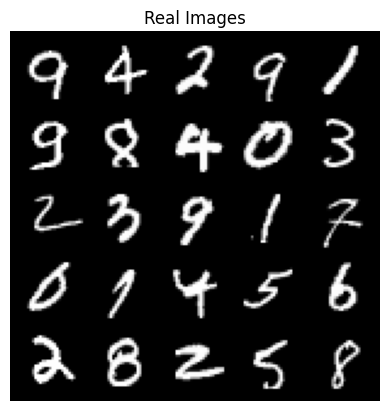

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 83500: Generator loss: 1.4204328372478496, discriminator loss: 0.45164287185668966


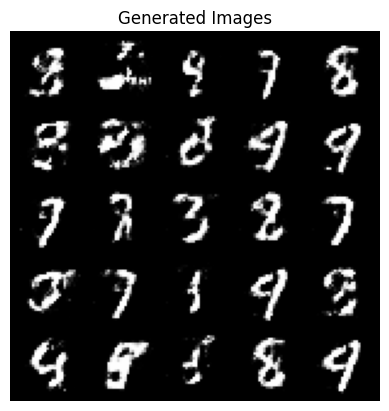

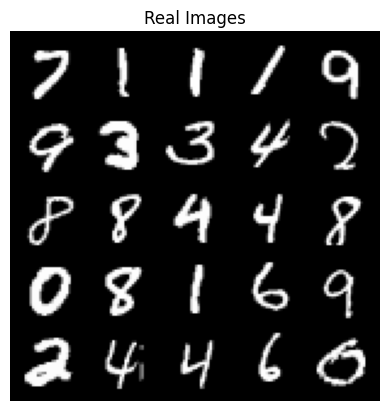

  0%|          | 0/469 [00:00<?, ?it/s]

Step 84000: Generator loss: 1.4188262066841129, discriminator loss: 0.4506190578937533


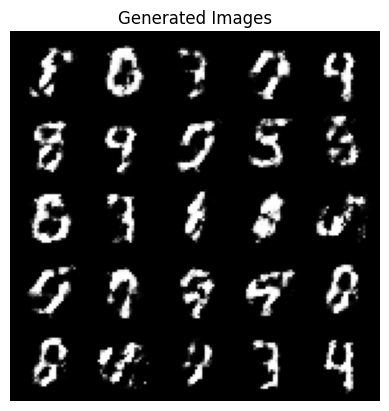

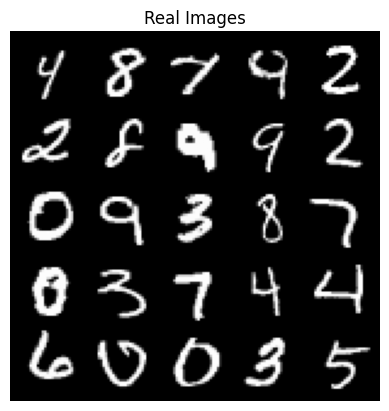

  0%|          | 0/469 [00:00<?, ?it/s]

Step 84500: Generator loss: 1.394268507719039, discriminator loss: 0.4571182482242584


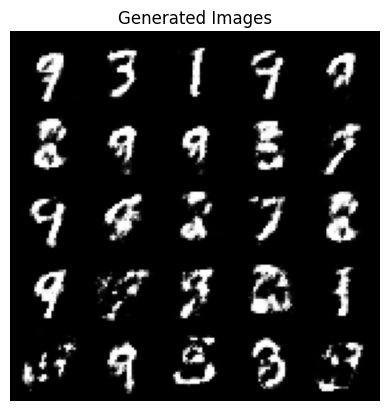

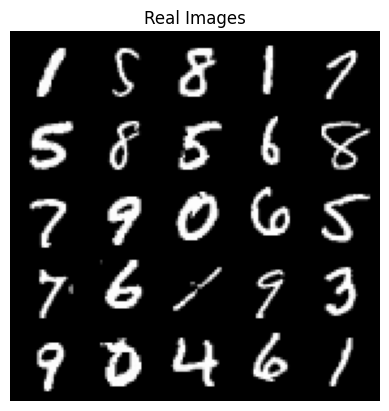

  0%|          | 0/469 [00:00<?, ?it/s]

Step 85000: Generator loss: 1.4133390159606911, discriminator loss: 0.4534541365504266


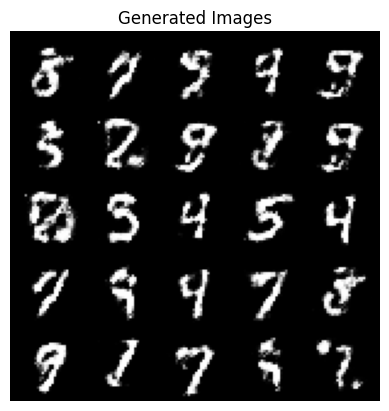

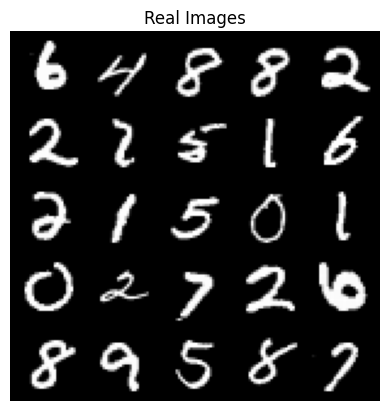

  0%|          | 0/469 [00:00<?, ?it/s]

Step 85500: Generator loss: 1.2100144901275647, discriminator loss: 0.5744542837142947


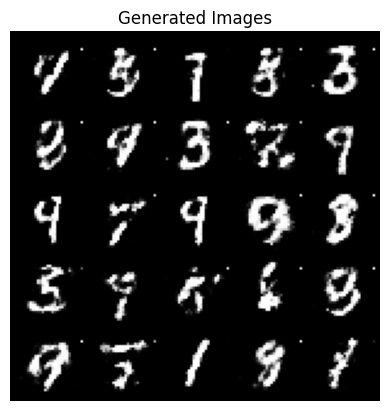

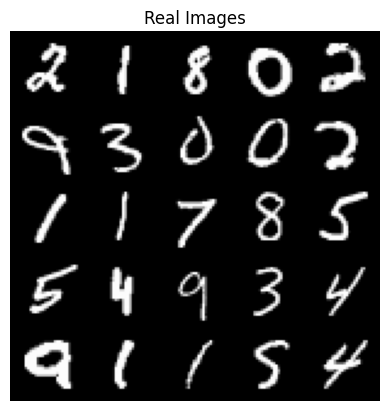

  0%|          | 0/469 [00:00<?, ?it/s]

Step 86000: Generator loss: 1.383862102985381, discriminator loss: 0.4341533403992651


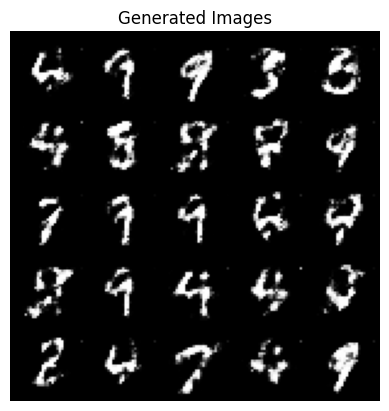

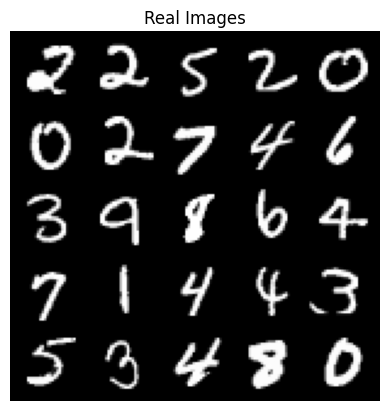

  0%|          | 0/469 [00:00<?, ?it/s]

Step 86500: Generator loss: 1.406101822137832, discriminator loss: 0.4502859723567968


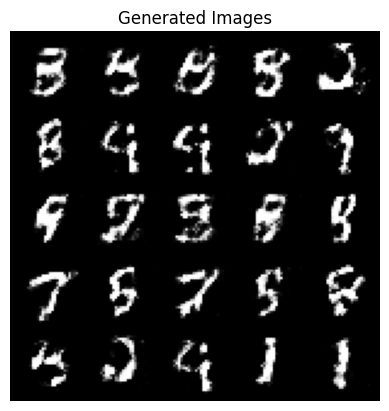

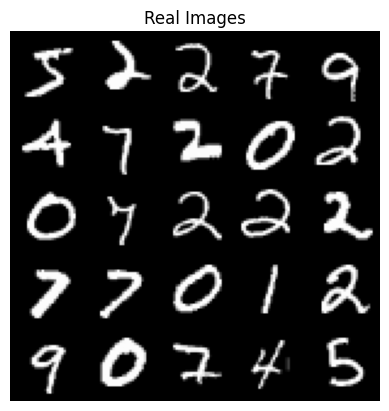

  0%|          | 0/469 [00:00<?, ?it/s]

Step 87000: Generator loss: 1.4052034442424766, discriminator loss: 0.4431429884433744


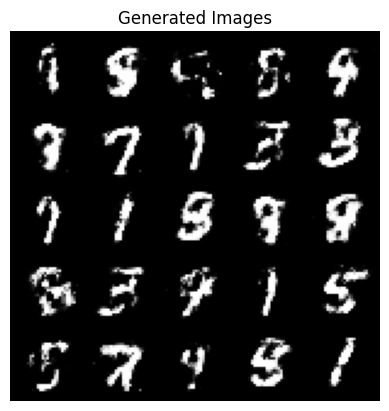

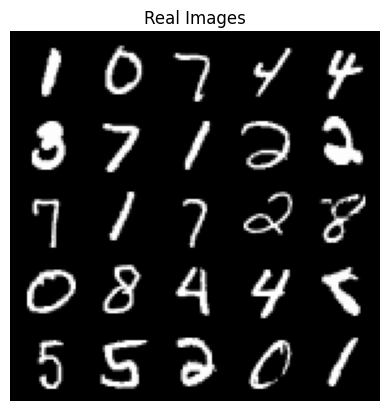

  0%|          | 0/469 [00:00<?, ?it/s]

Step 87500: Generator loss: 1.2751528842449196, discriminator loss: 0.49382088464498547


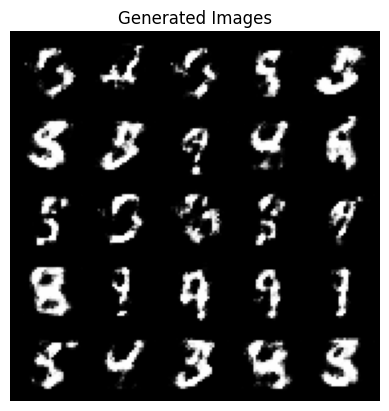

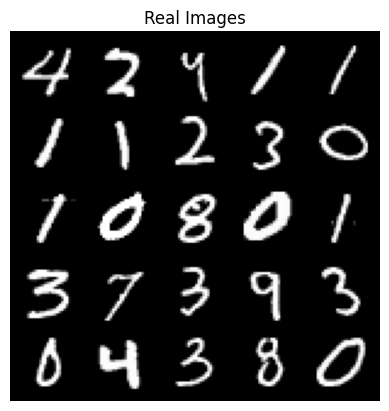

  0%|          | 0/469 [00:00<?, ?it/s]

Step 88000: Generator loss: 1.2518833057880399, discriminator loss: 0.4950940003395079


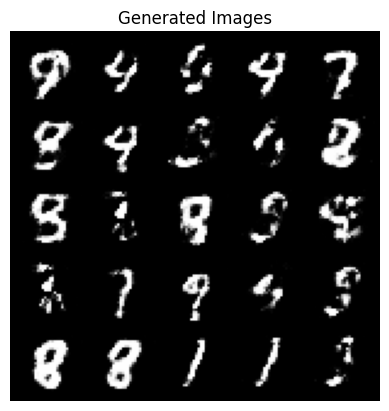

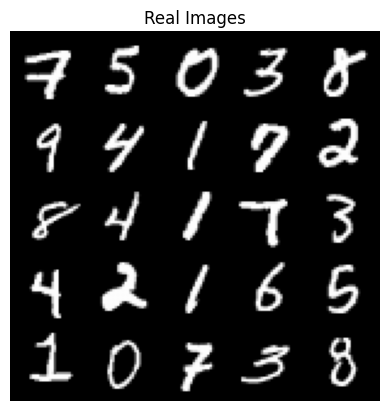

  0%|          | 0/469 [00:00<?, ?it/s]

Step 88500: Generator loss: 1.356615436315538, discriminator loss: 0.45646883624792106


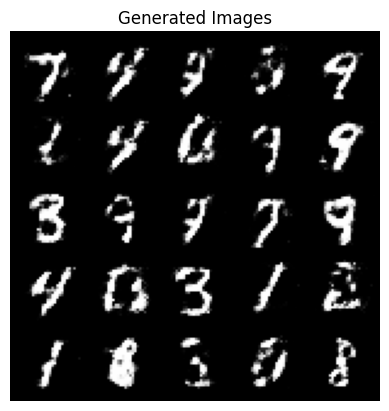

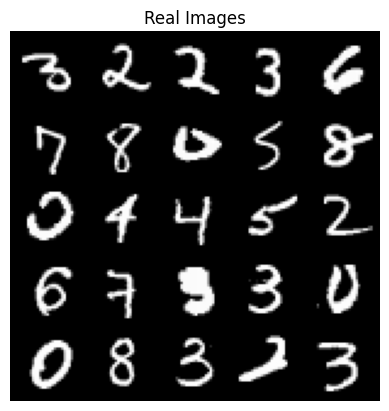

  0%|          | 0/469 [00:00<?, ?it/s]

Step 89000: Generator loss: 1.3087760305404665, discriminator loss: 0.4744583662152289


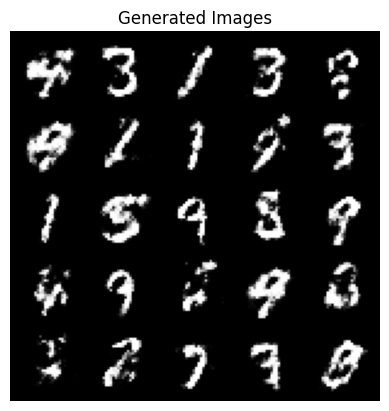

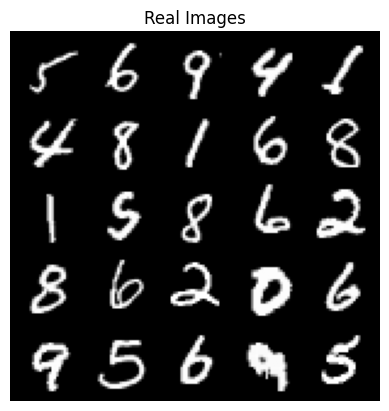

  0%|          | 0/469 [00:00<?, ?it/s]

Step 89500: Generator loss: 1.3011452755928046, discriminator loss: 0.48291719806194316


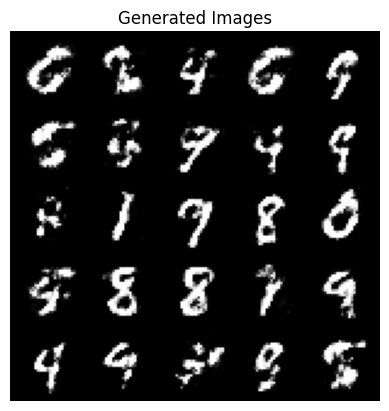

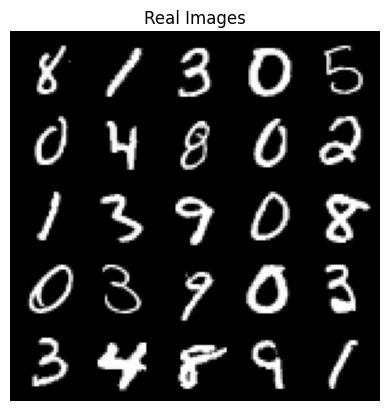

  0%|          | 0/469 [00:00<?, ?it/s]

Step 90000: Generator loss: 1.2599287083148945, discriminator loss: 0.49035635894536933


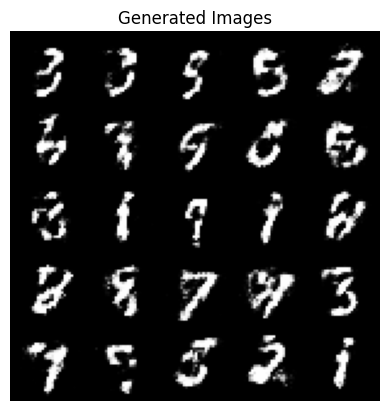

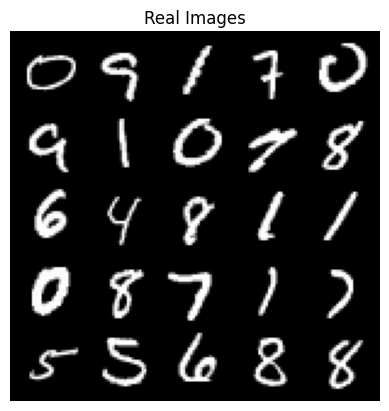

  0%|          | 0/469 [00:00<?, ?it/s]

Step 90500: Generator loss: 1.315425362110136, discriminator loss: 0.4698206351399423


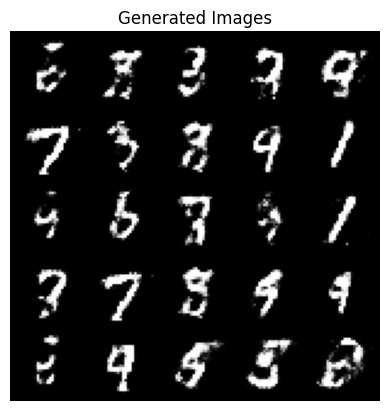

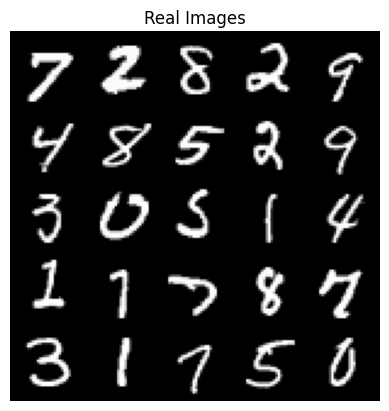

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 91000: Generator loss: 1.3660391933917988, discriminator loss: 0.4512084493041037


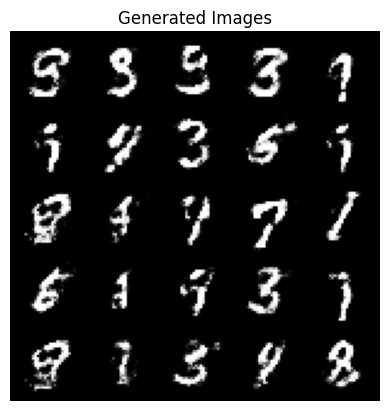

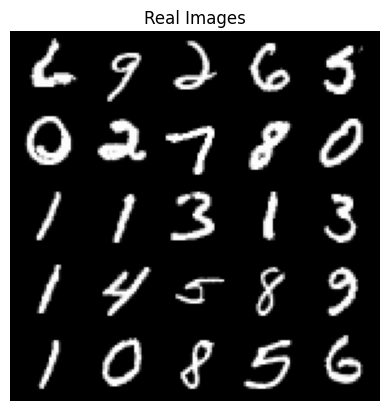

  0%|          | 0/469 [00:00<?, ?it/s]

Step 91500: Generator loss: 1.3057174446582784, discriminator loss: 0.47517690360546105


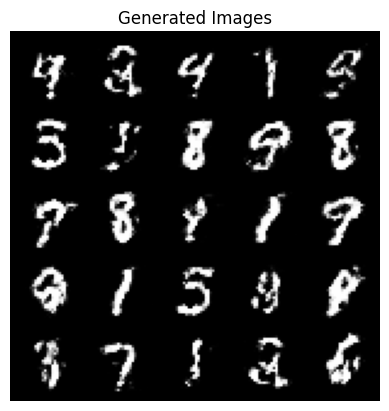

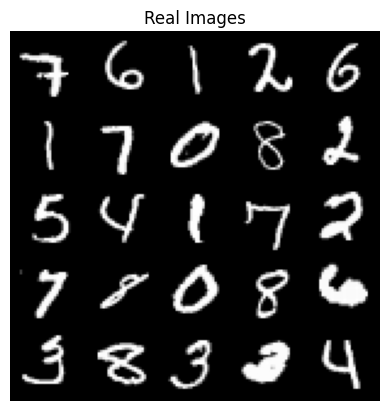

  0%|          | 0/469 [00:00<?, ?it/s]

Step 92000: Generator loss: 1.2946239564418798, discriminator loss: 0.4698352015614509


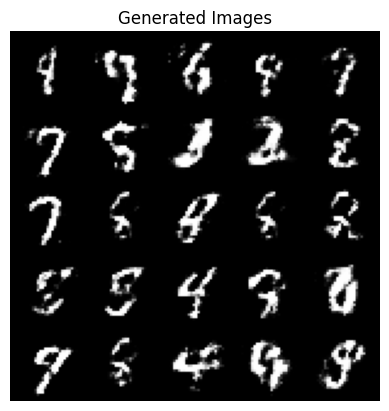

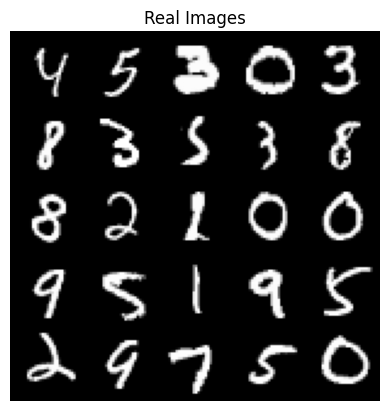

  0%|          | 0/469 [00:00<?, ?it/s]

Step 92500: Generator loss: 1.3181111848354339, discriminator loss: 0.4573375073671346


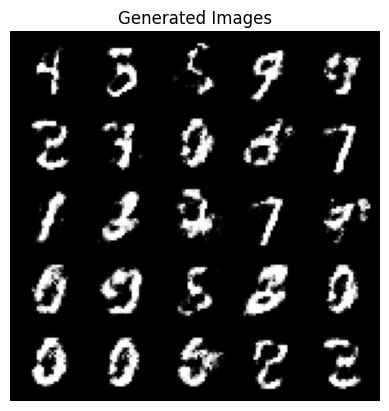

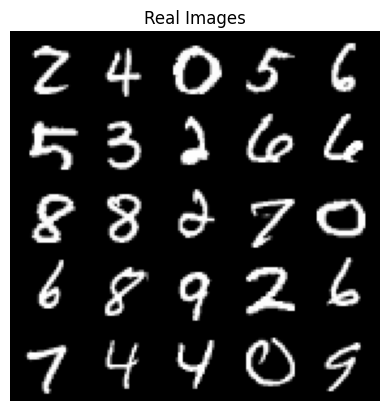

  0%|          | 0/469 [00:00<?, ?it/s]

Step 93000: Generator loss: 1.31389974308014, discriminator loss: 0.4663896175026896


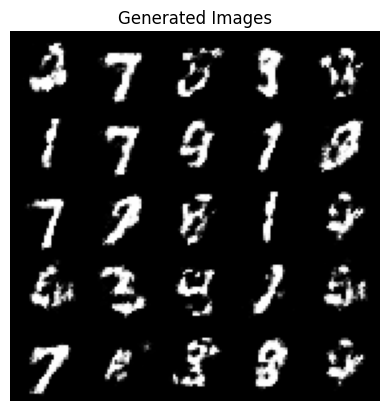

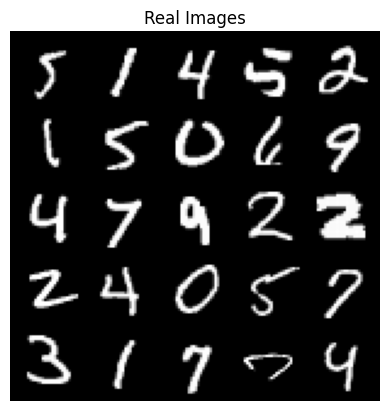

  0%|          | 0/469 [00:00<?, ?it/s]

Step 93500: Generator loss: 1.28520144844055, discriminator loss: 0.4738092792630196


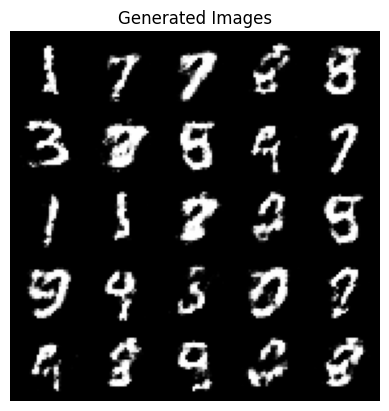

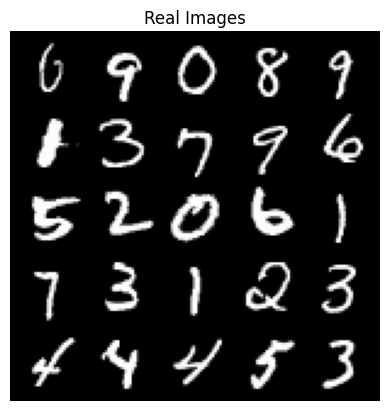

In [10]:
cur_step = 0
mean_generator_loss = 0
mean_discriminator_loss = 0

# Training loop
for epoch in range(n_epochs):
    # Iterating through the dataset
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)

        # Flatten the batch of real images from the dataset and move to device
        real = real.view(cur_batch_size, -1).to(device)

        # Zero out the gradients before backpropagation for the discriminator
        disc_opt.zero_grad()

        # Calculate discriminator loss
        disc_loss = get_disc_loss(gen, disc, criterion, real, cur_batch_size, z_dim, device)

        # Backpropagation for discriminator
        disc_loss.backward(retain_graph=True)

        # Update discriminator's optimizer
        disc_opt.step()

        # Zero out the gradients before backpropagation for the generator
        gen_opt.zero_grad()

        # Calculate generator loss
        gen_loss = get_gen_loss(gen, disc, criterion, cur_batch_size, z_dim, device)

        # Backpropagation for generator
        gen_loss.backward()

        # Update generator's optimizer
        gen_opt.step()

        # Calculate and track average discriminator and generator losses
        mean_discriminator_loss += disc_loss.item() / display_step
        mean_generator_loss += gen_loss.item() / display_step

        # Visualization code - display generated and real images
        if cur_step % display_step == 0 and cur_step > 0:
            print(f"Step {cur_step}: Generator loss: {mean_generator_loss}, discriminator loss: {mean_discriminator_loss}")

            # Generate fake images
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)

            # Display generated images
            show_tensor_images(fake, generated=True)

            # Display real images
            show_tensor_images(real)

            # Reset average losses for the next display
            mean_generator_loss = 0
            mean_discriminator_loss = 0

        cur_step += 1  # Update step count